# Deep Convloutional GAN (DCGAN)

- Referecnce : https://github.com/eriklindernoren/PyTorch-GAN

In [1]:
import argparse
import os
import numpy as np
import math

import torchvision
import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

In [2]:
device = 'cuda:1' if torch.cuda.is_available() else 'cpu'

## Define Generator & Discriminator
### Generator architecture
input random vector: 100 dim
* Linear: out_features 128 * 8 * 8
* BatchNorm2d
* Upsample: scale_factor 2
* Conv2d: out_channel: 128, kernel size 3, stride 1, padding 1
* BatchNorm2d
* LeakyReLU: 0.2
* Upsample: scale_factor 2
* Conv2d: out_channel: 64, kernel size 3, stride 1, padding 1
* BatchNorm
* LeakyReLU: 0.2
* Conv2d: out_channel: 1, kernel size 3, stride 1, padding 1
* Tanh

In [3]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        #### Implement Here ####        
        self.fc1 = nn.Linear(100, 128*8*8)
        self.bn1 = nn.BatchNorm2d(128)
        self.conv1 = nn.Conv2d(128,128,3,1,1)
        self.bn2 = nn.BatchNorm2d(128)
        self.conv2 = nn.Conv2d(128,64,3,1,1)
        self.bn3 = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64,1,3,1,1)
        
        self.act = nn.LeakyReLU(0.2)
        self.act_last = nn.Tanh()
        self.us = nn.Upsample(scale_factor = 2)


    def forward(self, z):
        #### Implement Here ####
        z = self.fc1(z)
        img = z.view(-1,128,8,8)
        img = self.bn1(img)
        img = self.act(self.bn2(self.conv1(self.us(img))))
        img = self.act(self.bn3(self.conv2(self.us(img))))
        img = self.act_last(self.conv3(img))
        
        return img

### Discriminator architecture
input: [1 , 32 , 32] image 
* Conv2d: out_channel: 16, kernel size 3, stride 1, padding 1
* LeakyReLU: 0.2
* Dropout: 0.25
* Conv2d: out_channel: 32, kernel size 3, stride 1, padding 1
* LeakyReLU: 0.2
* Dropout: 0.25
* BatchNorm2d
* Conv2d: out_channel: 64, kernel size 3, stride 1, padding 1
* LeakyReLU: 0.2
* Dropout: 0.25
* BatchNorm2d
* Conv2d: out_channel: 128, kernel size 3, stride 1, padding 1
* LeakyReLU: 0.2
* Dropout: 0.25
* BatchNorm2d
* Linear: out_features 1
* Sigmoid

In [4]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        #### Implement Here ####
        self.block1 = self.make_block(1,16)
        self.block2 = self.make_block(16,32)
        self.bn1 = nn.BatchNorm2d(32)
        self.block3 = self.make_block(32,64)
        self.bn2 = nn.BatchNorm2d(64)
        self.block4 = self.make_block(64,128)
        self.bn3 = nn.BatchNorm2d(128)
        self.fc1 = nn.Linear(512, 1)
        self.act_last = nn.Sigmoid()
        
    def make_block(self, in_features, out_features):
        #### Implement Here ####
        block = []
        block += [
            nn.Conv2d(in_features, out_features, kernel_size = 3, stride = 2, padding = 1),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.25)
        ]
        
        return nn.Sequential(*block)
        
        
    def forward(self, img):# [1, 32, 32]
        #### Implement Here ####
        x = self.block1(img)
        x = self.bn1(self.block2(x))
        x = self.bn2(self.block3(x))
        x = self.bn3(self.block4(x))
        x = x.view(-1,512)
        x = self.fc1(x)
        x = self.act_last(x)
        
        return x


In [5]:
# Initialize generator and discriminator
G = Generator()
D = Discriminator()

In [6]:
from torchsummary import summary
summary(G, device = 'cpu', batch_size = -1, input_size = (100,))
summary(D, device = 'cpu', batch_size = -1, input_size = (1, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 8192]         827,392
       BatchNorm2d-2            [-1, 128, 8, 8]             256
          Upsample-3          [-1, 128, 16, 16]               0
            Conv2d-4          [-1, 128, 16, 16]         147,584
       BatchNorm2d-5          [-1, 128, 16, 16]             256
         LeakyReLU-6          [-1, 128, 16, 16]               0
          Upsample-7          [-1, 128, 32, 32]               0
            Conv2d-8           [-1, 64, 32, 32]          73,792
       BatchNorm2d-9           [-1, 64, 32, 32]             128
        LeakyReLU-10           [-1, 64, 32, 32]               0
           Conv2d-11            [-1, 1, 32, 32]             577
             Tanh-12            [-1, 1, 32, 32]               0
Total params: 1,049,985
Trainable params: 1,049,985
Non-trainable params: 0
---------------------------

## Define loss & Optimizer & model

In [7]:
# Loss function
criterion = torch.nn.BCELoss()

optimizer_G = torch.optim.Adam(G.parameters(), lr=0.0001, betas=(0.5, 0.9999))
optimizer_D = torch.optim.Adam(D.parameters(), lr=0.0001, betas=(0.5, 0.9999))

## Use MNIST Dataset & DataLoader

In [8]:
bs = 64

dataset = datasets.MNIST("./mnist", train=True, download=True, 
                         transform=transforms.Compose([transforms.Resize(32), transforms.ToTensor(), transforms.Normalize([0.5], [0.5])]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=bs, shuffle=True, drop_last=True)

torch.Size([64, 1, 32, 32]) tensor([5, 3, 8, 0, 6, 3, 3, 2, 1, 8, 5, 4, 4, 2, 0, 5, 6, 1, 1, 1, 1, 4, 1, 0,
        5, 9, 8, 5, 1, 0, 6, 6, 6, 5, 0, 8, 5, 0, 3, 8, 8, 4, 1, 6, 1, 5, 9, 4,
        0, 8, 0, 1, 2, 7, 4, 3, 6, 7, 6, 5, 4, 2, 7, 1])


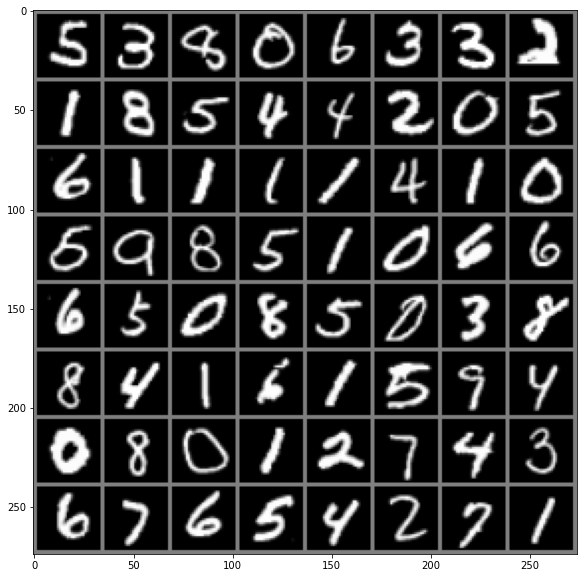

In [9]:
import matplotlib.pyplot as plt
import numpy as np

batch = next(iter(dataloader))
len(batch)
print(batch[0].shape, batch[1])

def imshow(img):
    img = img / 2 + 0.5
    npimg = img.numpy()
    plt.figure(figsize=(20,10))
    plt.imshow(np.transpose(npimg, (1,2,0)))
    plt.show()
    
imshow(torchvision.utils.make_grid(batch[0]))

## Start Training

In [10]:
G, D = G.to(device), D.to(device)
os.makedirs("./dcgan_images", exist_ok=True)
epochs = 200

[Epoch 0/200] [Batch 0/937] [D loss: 0.762559] [G loss: 0.692853]


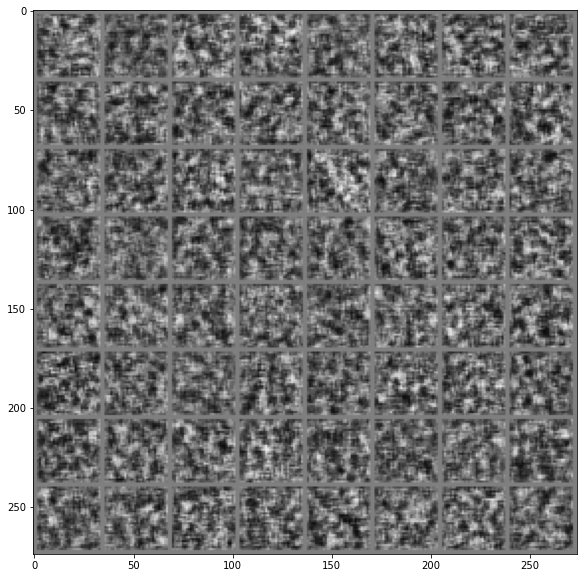

[Epoch 0/200] [Batch 100/937] [D loss: 0.672107] [G loss: 0.785779]
[Epoch 0/200] [Batch 200/937] [D loss: 0.701093] [G loss: 0.737740]
[Epoch 0/200] [Batch 300/937] [D loss: 0.682985] [G loss: 0.774897]
[Epoch 0/200] [Batch 400/937] [D loss: 0.670344] [G loss: 0.683216]
[Epoch 0/200] [Batch 500/937] [D loss: 0.687812] [G loss: 0.704201]
[Epoch 0/200] [Batch 600/937] [D loss: 0.707712] [G loss: 0.695574]
[Epoch 0/200] [Batch 700/937] [D loss: 0.708281] [G loss: 0.739382]
[Epoch 0/200] [Batch 800/937] [D loss: 0.660882] [G loss: 0.734017]
[Epoch 0/200] [Batch 900/937] [D loss: 0.665450] [G loss: 0.731137]
[Epoch 1/200] [Batch 63/937] [D loss: 0.677011] [G loss: 0.704254]
[Epoch 1/200] [Batch 163/937] [D loss: 0.680530] [G loss: 0.713822]
[Epoch 1/200] [Batch 263/937] [D loss: 0.685922] [G loss: 0.738768]
[Epoch 1/200] [Batch 363/937] [D loss: 0.713482] [G loss: 0.674889]
[Epoch 1/200] [Batch 463/937] [D loss: 0.669250] [G loss: 0.734066]
[Epoch 1/200] [Batch 563/937] [D loss: 0.672244] 

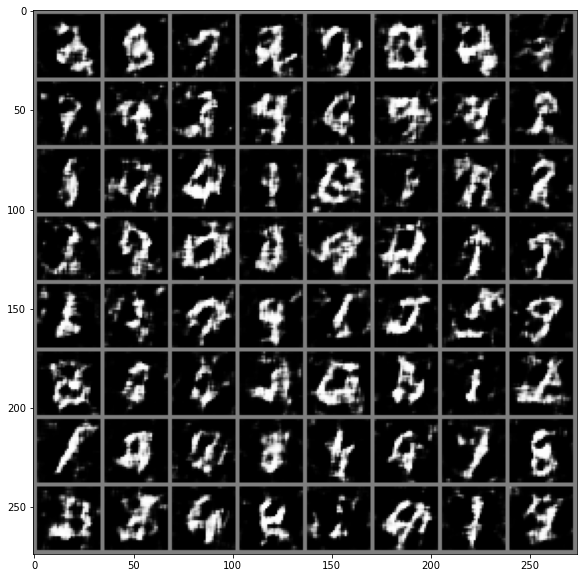

[Epoch 2/200] [Batch 226/937] [D loss: 0.669283] [G loss: 0.809475]
[Epoch 2/200] [Batch 326/937] [D loss: 0.684307] [G loss: 0.748389]
[Epoch 2/200] [Batch 426/937] [D loss: 0.649953] [G loss: 0.789725]
[Epoch 2/200] [Batch 526/937] [D loss: 0.633575] [G loss: 0.842685]
[Epoch 2/200] [Batch 626/937] [D loss: 0.647806] [G loss: 0.787107]
[Epoch 2/200] [Batch 726/937] [D loss: 0.671247] [G loss: 0.774233]
[Epoch 2/200] [Batch 826/937] [D loss: 0.660753] [G loss: 0.788776]
[Epoch 2/200] [Batch 926/937] [D loss: 0.667383] [G loss: 0.904369]
[Epoch 3/200] [Batch 89/937] [D loss: 0.606604] [G loss: 0.838025]
[Epoch 3/200] [Batch 189/937] [D loss: 0.633579] [G loss: 0.835149]
[Epoch 3/200] [Batch 289/937] [D loss: 0.665370] [G loss: 0.833507]
[Epoch 3/200] [Batch 389/937] [D loss: 0.586076] [G loss: 0.918728]
[Epoch 3/200] [Batch 489/937] [D loss: 0.676186] [G loss: 0.926126]
[Epoch 3/200] [Batch 589/937] [D loss: 0.578596] [G loss: 0.877290]
[Epoch 3/200] [Batch 689/937] [D loss: 0.594314] 

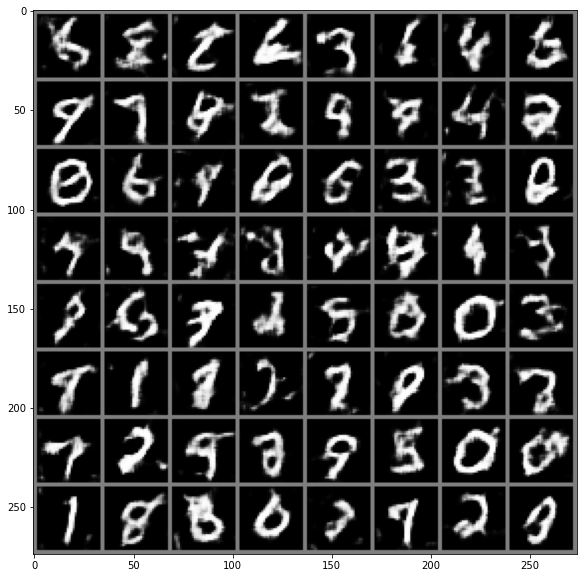

[Epoch 4/200] [Batch 352/937] [D loss: 0.586729] [G loss: 0.902428]
[Epoch 4/200] [Batch 452/937] [D loss: 0.610575] [G loss: 1.169900]
[Epoch 4/200] [Batch 552/937] [D loss: 0.563720] [G loss: 0.986638]
[Epoch 4/200] [Batch 652/937] [D loss: 0.492867] [G loss: 0.908836]
[Epoch 4/200] [Batch 752/937] [D loss: 0.531866] [G loss: 0.996152]
[Epoch 4/200] [Batch 852/937] [D loss: 0.540099] [G loss: 1.203079]
[Epoch 5/200] [Batch 15/937] [D loss: 0.629211] [G loss: 0.907889]
[Epoch 5/200] [Batch 115/937] [D loss: 0.559551] [G loss: 1.215870]
[Epoch 5/200] [Batch 215/937] [D loss: 0.625364] [G loss: 0.969552]
[Epoch 5/200] [Batch 315/937] [D loss: 0.545930] [G loss: 0.842699]
[Epoch 5/200] [Batch 415/937] [D loss: 0.536840] [G loss: 1.128346]
[Epoch 5/200] [Batch 515/937] [D loss: 0.524537] [G loss: 1.183666]
[Epoch 5/200] [Batch 615/937] [D loss: 0.455528] [G loss: 0.916236]
[Epoch 5/200] [Batch 715/937] [D loss: 0.534475] [G loss: 1.471259]
[Epoch 5/200] [Batch 815/937] [D loss: 0.607793] 

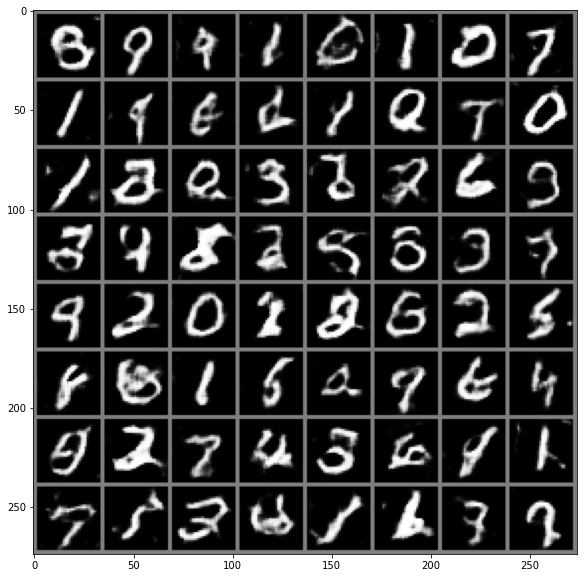

[Epoch 6/200] [Batch 478/937] [D loss: 0.436375] [G loss: 1.247076]
[Epoch 6/200] [Batch 578/937] [D loss: 0.563495] [G loss: 1.576281]
[Epoch 6/200] [Batch 678/937] [D loss: 0.467950] [G loss: 1.563266]
[Epoch 6/200] [Batch 778/937] [D loss: 0.476960] [G loss: 1.787977]
[Epoch 6/200] [Batch 878/937] [D loss: 0.646839] [G loss: 1.000071]
[Epoch 7/200] [Batch 41/937] [D loss: 0.439265] [G loss: 1.202378]
[Epoch 7/200] [Batch 141/937] [D loss: 0.455143] [G loss: 1.252407]
[Epoch 7/200] [Batch 241/937] [D loss: 0.679662] [G loss: 1.031064]
[Epoch 7/200] [Batch 341/937] [D loss: 0.486681] [G loss: 1.423702]
[Epoch 7/200] [Batch 441/937] [D loss: 0.338175] [G loss: 1.699152]
[Epoch 7/200] [Batch 541/937] [D loss: 0.452385] [G loss: 1.103093]
[Epoch 7/200] [Batch 641/937] [D loss: 0.428631] [G loss: 1.473852]
[Epoch 7/200] [Batch 741/937] [D loss: 0.384615] [G loss: 1.027958]
[Epoch 7/200] [Batch 841/937] [D loss: 0.509440] [G loss: 1.559543]
[Epoch 8/200] [Batch 4/937] [D loss: 0.476815] [G

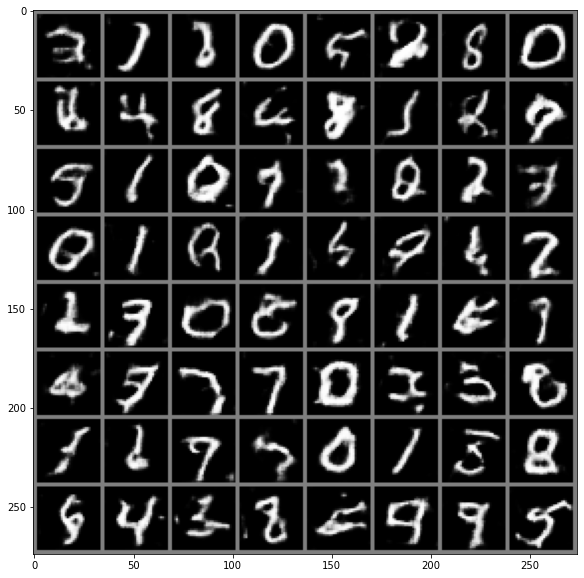

[Epoch 8/200] [Batch 604/937] [D loss: 0.305270] [G loss: 2.114635]
[Epoch 8/200] [Batch 704/937] [D loss: 0.270326] [G loss: 1.379415]
[Epoch 8/200] [Batch 804/937] [D loss: 0.256212] [G loss: 1.890008]
[Epoch 8/200] [Batch 904/937] [D loss: 0.353951] [G loss: 2.246600]
[Epoch 9/200] [Batch 67/937] [D loss: 0.488677] [G loss: 1.319631]
[Epoch 9/200] [Batch 167/937] [D loss: 0.323431] [G loss: 1.554366]
[Epoch 9/200] [Batch 267/937] [D loss: 0.290322] [G loss: 1.478591]
[Epoch 9/200] [Batch 367/937] [D loss: 0.374747] [G loss: 1.324233]
[Epoch 9/200] [Batch 467/937] [D loss: 0.369760] [G loss: 1.822335]
[Epoch 9/200] [Batch 567/937] [D loss: 0.472675] [G loss: 1.313506]
[Epoch 9/200] [Batch 667/937] [D loss: 0.286361] [G loss: 1.287700]
[Epoch 9/200] [Batch 767/937] [D loss: 0.478630] [G loss: 0.969759]
[Epoch 9/200] [Batch 867/937] [D loss: 0.534277] [G loss: 1.017224]
[Epoch 10/200] [Batch 30/937] [D loss: 0.529411] [G loss: 1.620419]
[Epoch 10/200] [Batch 130/937] [D loss: 0.289114]

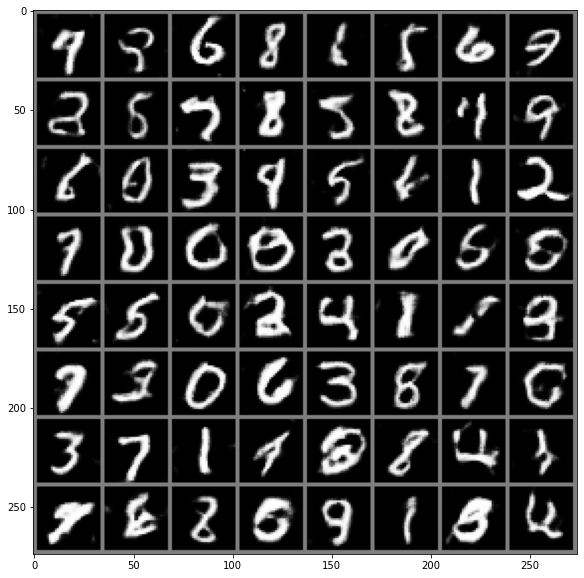

[Epoch 10/200] [Batch 730/937] [D loss: 0.316881] [G loss: 1.569805]
[Epoch 10/200] [Batch 830/937] [D loss: 0.321949] [G loss: 1.120711]
[Epoch 10/200] [Batch 930/937] [D loss: 0.220420] [G loss: 1.468221]
[Epoch 11/200] [Batch 93/937] [D loss: 0.488729] [G loss: 2.599143]
[Epoch 11/200] [Batch 193/937] [D loss: 0.344564] [G loss: 1.350510]
[Epoch 11/200] [Batch 293/937] [D loss: 0.348746] [G loss: 1.829447]
[Epoch 11/200] [Batch 393/937] [D loss: 0.416395] [G loss: 1.069603]
[Epoch 11/200] [Batch 493/937] [D loss: 0.303050] [G loss: 1.127234]
[Epoch 11/200] [Batch 593/937] [D loss: 0.354674] [G loss: 1.100152]
[Epoch 11/200] [Batch 693/937] [D loss: 0.295107] [G loss: 2.546155]
[Epoch 11/200] [Batch 793/937] [D loss: 0.325843] [G loss: 1.076635]
[Epoch 11/200] [Batch 893/937] [D loss: 0.509772] [G loss: 2.018435]
[Epoch 12/200] [Batch 56/937] [D loss: 0.258175] [G loss: 1.961251]
[Epoch 12/200] [Batch 156/937] [D loss: 0.303272] [G loss: 2.052812]
[Epoch 12/200] [Batch 256/937] [D lo

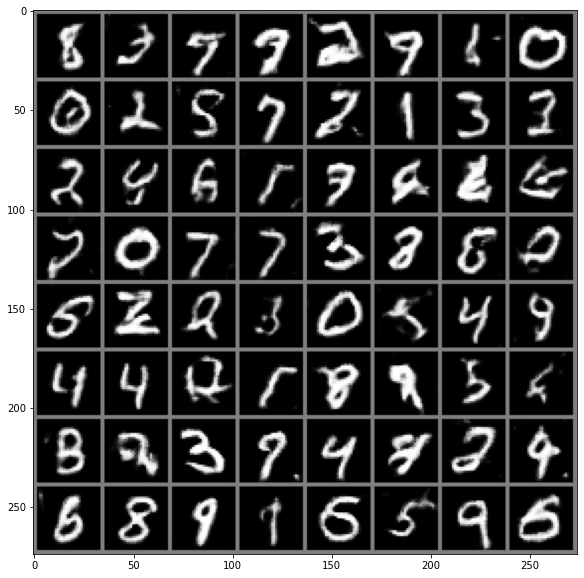

[Epoch 12/200] [Batch 856/937] [D loss: 0.243755] [G loss: 1.451658]
[Epoch 13/200] [Batch 19/937] [D loss: 0.318786] [G loss: 2.264943]
[Epoch 13/200] [Batch 119/937] [D loss: 0.197226] [G loss: 2.401947]
[Epoch 13/200] [Batch 219/937] [D loss: 0.547267] [G loss: 0.978779]
[Epoch 13/200] [Batch 319/937] [D loss: 0.307532] [G loss: 1.676599]
[Epoch 13/200] [Batch 419/937] [D loss: 0.302090] [G loss: 3.209234]
[Epoch 13/200] [Batch 519/937] [D loss: 0.321266] [G loss: 1.831085]
[Epoch 13/200] [Batch 619/937] [D loss: 0.322705] [G loss: 1.539103]
[Epoch 13/200] [Batch 719/937] [D loss: 0.142631] [G loss: 1.845007]
[Epoch 13/200] [Batch 819/937] [D loss: 0.391666] [G loss: 1.571280]
[Epoch 13/200] [Batch 919/937] [D loss: 0.421237] [G loss: 1.933662]
[Epoch 14/200] [Batch 82/937] [D loss: 0.225944] [G loss: 1.124893]
[Epoch 14/200] [Batch 182/937] [D loss: 0.582464] [G loss: 1.468200]
[Epoch 14/200] [Batch 282/937] [D loss: 0.342288] [G loss: 1.528655]
[Epoch 14/200] [Batch 382/937] [D lo

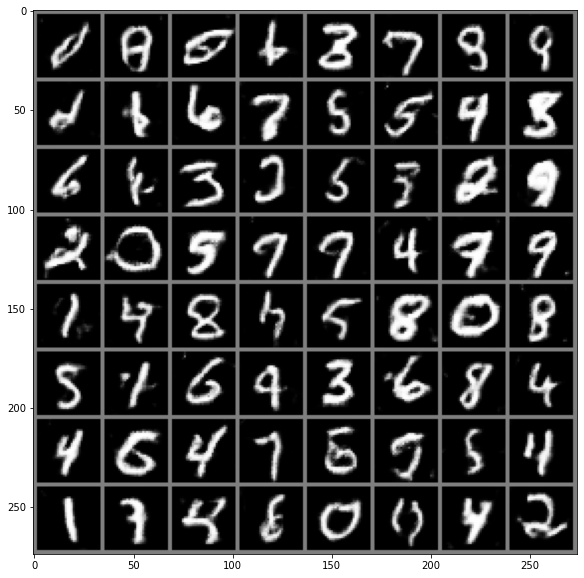

[Epoch 15/200] [Batch 45/937] [D loss: 0.316800] [G loss: 2.190822]
[Epoch 15/200] [Batch 145/937] [D loss: 0.264697] [G loss: 2.070262]
[Epoch 15/200] [Batch 245/937] [D loss: 0.183871] [G loss: 1.994107]
[Epoch 15/200] [Batch 345/937] [D loss: 0.403754] [G loss: 2.573882]
[Epoch 15/200] [Batch 445/937] [D loss: 0.115660] [G loss: 1.795843]
[Epoch 15/200] [Batch 545/937] [D loss: 0.154342] [G loss: 1.002824]
[Epoch 15/200] [Batch 645/937] [D loss: 0.313118] [G loss: 1.663589]
[Epoch 15/200] [Batch 745/937] [D loss: 0.376680] [G loss: 2.827266]
[Epoch 15/200] [Batch 845/937] [D loss: 0.115017] [G loss: 3.643031]
[Epoch 16/200] [Batch 8/937] [D loss: 0.468090] [G loss: 2.117815]
[Epoch 16/200] [Batch 108/937] [D loss: 0.277787] [G loss: 1.218745]
[Epoch 16/200] [Batch 208/937] [D loss: 0.220097] [G loss: 1.961274]
[Epoch 16/200] [Batch 308/937] [D loss: 0.296764] [G loss: 2.100360]
[Epoch 16/200] [Batch 408/937] [D loss: 0.176500] [G loss: 3.444664]
[Epoch 16/200] [Batch 508/937] [D los

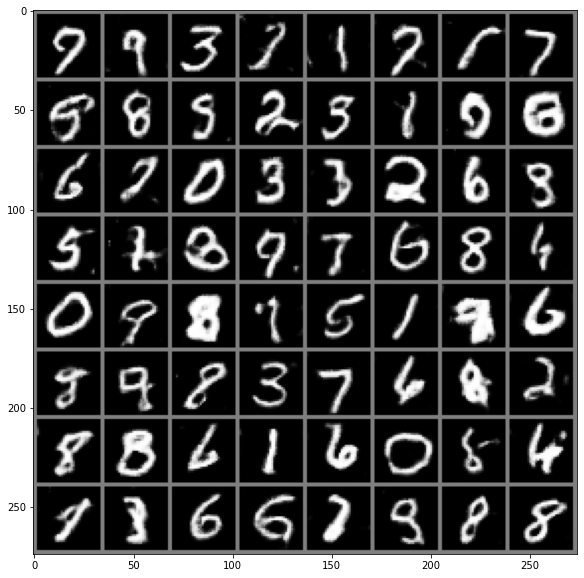

[Epoch 17/200] [Batch 171/937] [D loss: 0.353988] [G loss: 1.761769]
[Epoch 17/200] [Batch 271/937] [D loss: 0.238847] [G loss: 1.207911]
[Epoch 17/200] [Batch 371/937] [D loss: 0.196768] [G loss: 1.845954]
[Epoch 17/200] [Batch 471/937] [D loss: 0.212238] [G loss: 1.565699]
[Epoch 17/200] [Batch 571/937] [D loss: 0.076470] [G loss: 1.869887]
[Epoch 17/200] [Batch 671/937] [D loss: 0.400856] [G loss: 1.117155]
[Epoch 17/200] [Batch 771/937] [D loss: 0.341170] [G loss: 4.068459]
[Epoch 17/200] [Batch 871/937] [D loss: 0.217619] [G loss: 3.933714]
[Epoch 18/200] [Batch 34/937] [D loss: 0.276335] [G loss: 2.337878]
[Epoch 18/200] [Batch 134/937] [D loss: 0.153487] [G loss: 1.456208]
[Epoch 18/200] [Batch 234/937] [D loss: 0.260309] [G loss: 2.696582]
[Epoch 18/200] [Batch 334/937] [D loss: 0.317186] [G loss: 1.075395]
[Epoch 18/200] [Batch 434/937] [D loss: 0.184182] [G loss: 2.311526]
[Epoch 18/200] [Batch 534/937] [D loss: 0.366172] [G loss: 1.456148]
[Epoch 18/200] [Batch 634/937] [D l

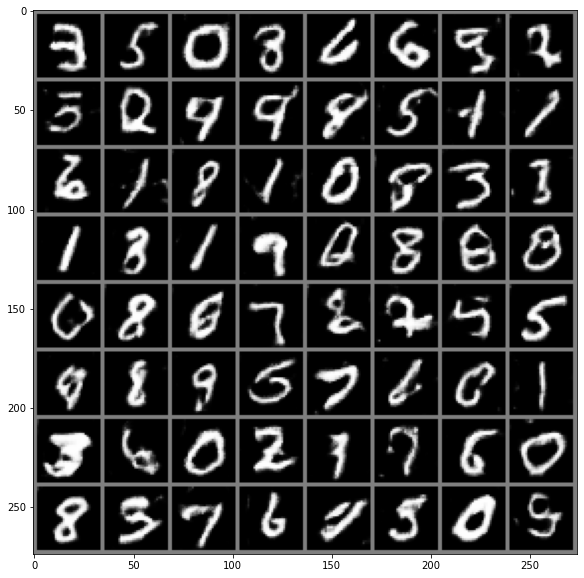

[Epoch 19/200] [Batch 297/937] [D loss: 0.235868] [G loss: 1.520528]
[Epoch 19/200] [Batch 397/937] [D loss: 0.504122] [G loss: 0.753360]
[Epoch 19/200] [Batch 497/937] [D loss: 0.376919] [G loss: 2.404303]
[Epoch 19/200] [Batch 597/937] [D loss: 0.488355] [G loss: 0.955473]
[Epoch 19/200] [Batch 697/937] [D loss: 0.314323] [G loss: 2.632028]
[Epoch 19/200] [Batch 797/937] [D loss: 0.072207] [G loss: 1.692508]
[Epoch 19/200] [Batch 897/937] [D loss: 0.262345] [G loss: 1.097425]
[Epoch 20/200] [Batch 60/937] [D loss: 0.173872] [G loss: 1.514780]
[Epoch 20/200] [Batch 160/937] [D loss: 0.293081] [G loss: 1.976001]
[Epoch 20/200] [Batch 260/937] [D loss: 0.406244] [G loss: 1.337317]
[Epoch 20/200] [Batch 360/937] [D loss: 0.143712] [G loss: 2.173098]
[Epoch 20/200] [Batch 460/937] [D loss: 0.178269] [G loss: 1.877506]
[Epoch 20/200] [Batch 560/937] [D loss: 0.160763] [G loss: 3.391107]
[Epoch 20/200] [Batch 660/937] [D loss: 0.199337] [G loss: 0.982638]
[Epoch 20/200] [Batch 760/937] [D l

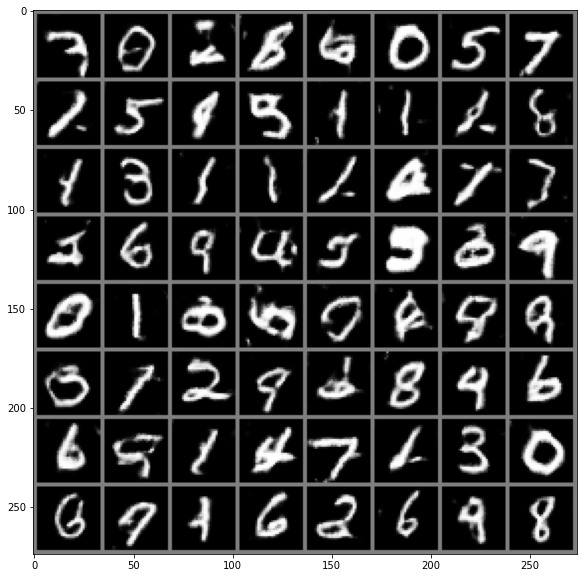

[Epoch 21/200] [Batch 423/937] [D loss: 0.297954] [G loss: 4.423492]
[Epoch 21/200] [Batch 523/937] [D loss: 0.285672] [G loss: 2.456322]
[Epoch 21/200] [Batch 623/937] [D loss: 0.380976] [G loss: 1.794847]
[Epoch 21/200] [Batch 723/937] [D loss: 0.534564] [G loss: 2.031743]
[Epoch 21/200] [Batch 823/937] [D loss: 0.386994] [G loss: 1.455868]
[Epoch 21/200] [Batch 923/937] [D loss: 0.072814] [G loss: 2.391842]
[Epoch 22/200] [Batch 86/937] [D loss: 0.175329] [G loss: 2.181890]
[Epoch 22/200] [Batch 186/937] [D loss: 0.156390] [G loss: 3.115920]
[Epoch 22/200] [Batch 286/937] [D loss: 0.216102] [G loss: 2.417355]
[Epoch 22/200] [Batch 386/937] [D loss: 0.060465] [G loss: 2.310109]
[Epoch 22/200] [Batch 486/937] [D loss: 0.111929] [G loss: 1.939360]
[Epoch 22/200] [Batch 586/937] [D loss: 0.108994] [G loss: 1.468768]
[Epoch 22/200] [Batch 686/937] [D loss: 0.141483] [G loss: 2.529942]
[Epoch 22/200] [Batch 786/937] [D loss: 0.367090] [G loss: 1.523852]
[Epoch 22/200] [Batch 886/937] [D l

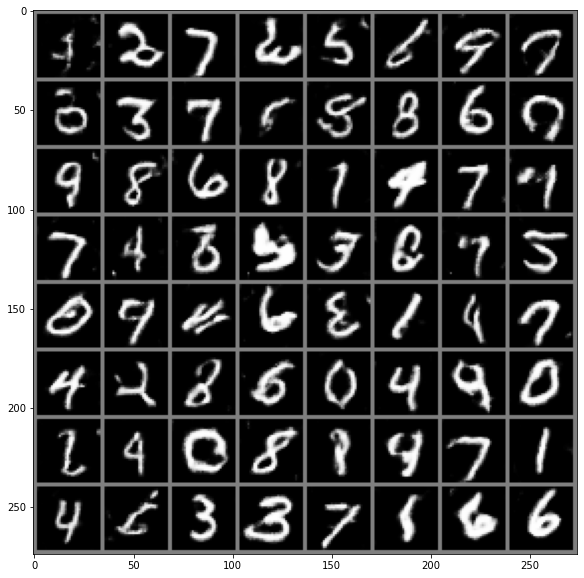

[Epoch 23/200] [Batch 549/937] [D loss: 0.417172] [G loss: 2.020678]
[Epoch 23/200] [Batch 649/937] [D loss: 0.206826] [G loss: 2.037593]
[Epoch 23/200] [Batch 749/937] [D loss: 0.060190] [G loss: 3.040196]
[Epoch 23/200] [Batch 849/937] [D loss: 0.102984] [G loss: 2.843162]
[Epoch 24/200] [Batch 12/937] [D loss: 0.087325] [G loss: 3.657014]
[Epoch 24/200] [Batch 112/937] [D loss: 0.240188] [G loss: 1.922566]
[Epoch 24/200] [Batch 212/937] [D loss: 0.301968] [G loss: 3.576849]
[Epoch 24/200] [Batch 312/937] [D loss: 0.202431] [G loss: 2.167167]
[Epoch 24/200] [Batch 412/937] [D loss: 0.262685] [G loss: 2.456478]
[Epoch 24/200] [Batch 512/937] [D loss: 0.161350] [G loss: 3.821136]
[Epoch 24/200] [Batch 612/937] [D loss: 0.259471] [G loss: 2.693213]
[Epoch 24/200] [Batch 712/937] [D loss: 0.107027] [G loss: 1.604400]
[Epoch 24/200] [Batch 812/937] [D loss: 0.372085] [G loss: 1.012176]
[Epoch 24/200] [Batch 912/937] [D loss: 0.138883] [G loss: 3.163160]
[Epoch 25/200] [Batch 75/937] [D lo

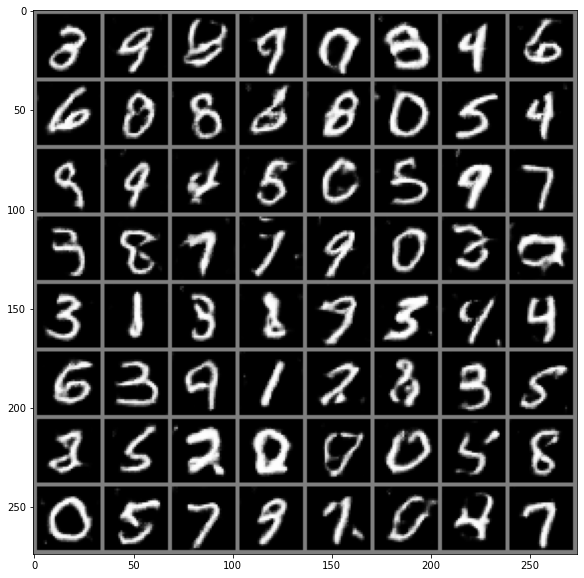

[Epoch 25/200] [Batch 675/937] [D loss: 0.113654] [G loss: 1.975073]
[Epoch 25/200] [Batch 775/937] [D loss: 0.079895] [G loss: 2.737291]
[Epoch 25/200] [Batch 875/937] [D loss: 0.183178] [G loss: 2.689741]
[Epoch 26/200] [Batch 38/937] [D loss: 0.413968] [G loss: 4.186185]
[Epoch 26/200] [Batch 138/937] [D loss: 0.380659] [G loss: 2.735455]
[Epoch 26/200] [Batch 238/937] [D loss: 0.162034] [G loss: 2.457852]
[Epoch 26/200] [Batch 338/937] [D loss: 0.242872] [G loss: 4.143106]
[Epoch 26/200] [Batch 438/937] [D loss: 0.081215] [G loss: 1.703449]
[Epoch 26/200] [Batch 538/937] [D loss: 0.188908] [G loss: 3.271792]
[Epoch 26/200] [Batch 638/937] [D loss: 0.289683] [G loss: 2.657227]
[Epoch 26/200] [Batch 738/937] [D loss: 0.093512] [G loss: 2.251924]
[Epoch 26/200] [Batch 838/937] [D loss: 0.421798] [G loss: 3.506430]
[Epoch 27/200] [Batch 1/937] [D loss: 0.350575] [G loss: 1.905494]
[Epoch 27/200] [Batch 101/937] [D loss: 0.401665] [G loss: 2.112329]
[Epoch 27/200] [Batch 201/937] [D los

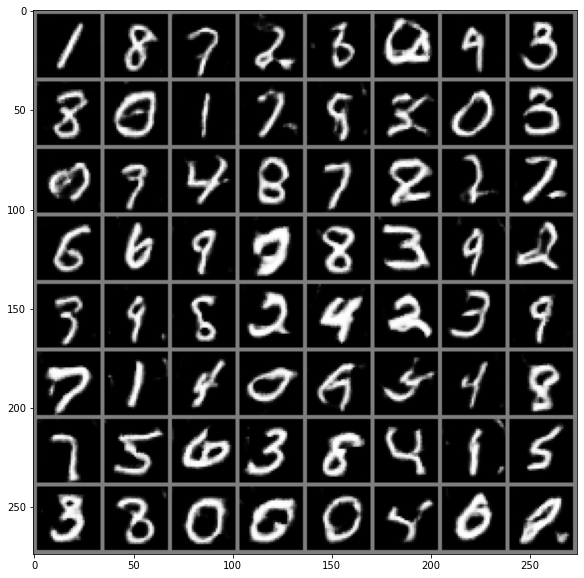

[Epoch 27/200] [Batch 801/937] [D loss: 0.108290] [G loss: 2.069783]
[Epoch 27/200] [Batch 901/937] [D loss: 0.357208] [G loss: 1.576210]
[Epoch 28/200] [Batch 64/937] [D loss: 0.504279] [G loss: 4.691668]
[Epoch 28/200] [Batch 164/937] [D loss: 0.307363] [G loss: 2.619494]
[Epoch 28/200] [Batch 264/937] [D loss: 0.095658] [G loss: 1.814353]
[Epoch 28/200] [Batch 364/937] [D loss: 0.107333] [G loss: 3.197970]
[Epoch 28/200] [Batch 464/937] [D loss: 0.143193] [G loss: 3.215973]
[Epoch 28/200] [Batch 564/937] [D loss: 0.242034] [G loss: 1.269722]
[Epoch 28/200] [Batch 664/937] [D loss: 0.243525] [G loss: 1.455827]
[Epoch 28/200] [Batch 764/937] [D loss: 0.200985] [G loss: 1.460481]
[Epoch 28/200] [Batch 864/937] [D loss: 0.151854] [G loss: 3.314738]
[Epoch 29/200] [Batch 27/937] [D loss: 0.220408] [G loss: 3.132642]
[Epoch 29/200] [Batch 127/937] [D loss: 0.212306] [G loss: 1.462520]
[Epoch 29/200] [Batch 227/937] [D loss: 0.273539] [G loss: 2.797817]
[Epoch 29/200] [Batch 327/937] [D lo

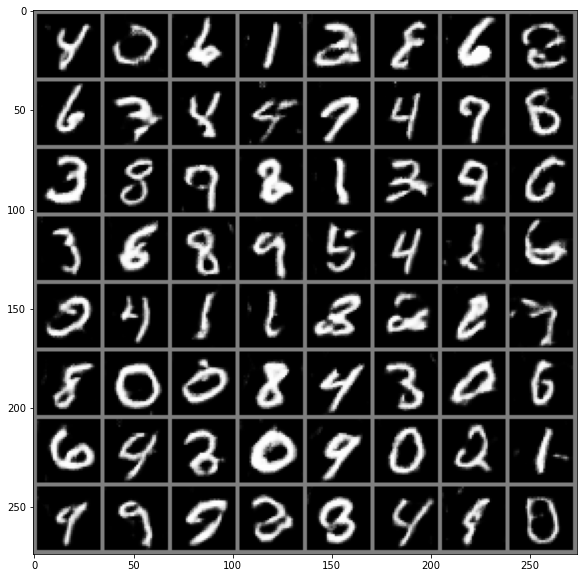

[Epoch 29/200] [Batch 927/937] [D loss: 0.580762] [G loss: 2.375226]
[Epoch 30/200] [Batch 90/937] [D loss: 0.287958] [G loss: 2.146056]
[Epoch 30/200] [Batch 190/937] [D loss: 0.185996] [G loss: 3.575234]
[Epoch 30/200] [Batch 290/937] [D loss: 0.169655] [G loss: 1.707075]
[Epoch 30/200] [Batch 390/937] [D loss: 0.450592] [G loss: 1.699488]
[Epoch 30/200] [Batch 490/937] [D loss: 0.199043] [G loss: 4.612228]
[Epoch 30/200] [Batch 590/937] [D loss: 0.188269] [G loss: 1.008195]
[Epoch 30/200] [Batch 690/937] [D loss: 0.161375] [G loss: 0.849859]
[Epoch 30/200] [Batch 790/937] [D loss: 0.104528] [G loss: 0.939481]
[Epoch 30/200] [Batch 890/937] [D loss: 0.354653] [G loss: 1.115141]
[Epoch 31/200] [Batch 53/937] [D loss: 0.180055] [G loss: 2.791986]
[Epoch 31/200] [Batch 153/937] [D loss: 0.139259] [G loss: 1.318587]
[Epoch 31/200] [Batch 253/937] [D loss: 0.260031] [G loss: 2.077266]
[Epoch 31/200] [Batch 353/937] [D loss: 0.106975] [G loss: 2.038998]
[Epoch 31/200] [Batch 453/937] [D lo

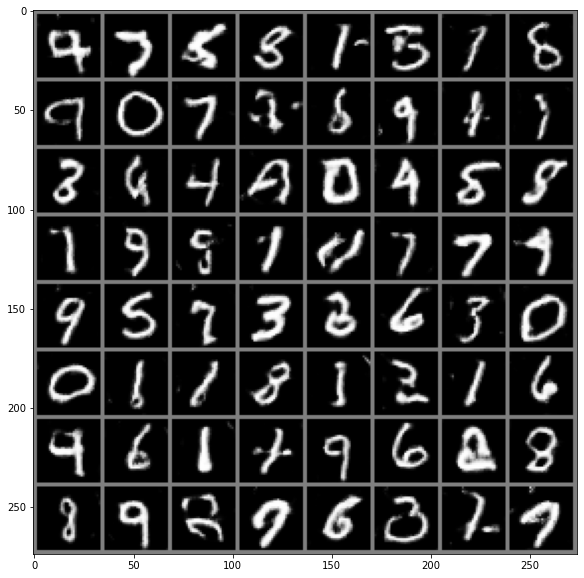

[Epoch 32/200] [Batch 116/937] [D loss: 0.299079] [G loss: 4.020800]
[Epoch 32/200] [Batch 216/937] [D loss: 0.193285] [G loss: 3.525314]
[Epoch 32/200] [Batch 316/937] [D loss: 0.095105] [G loss: 1.226317]
[Epoch 32/200] [Batch 416/937] [D loss: 0.048300] [G loss: 3.620163]
[Epoch 32/200] [Batch 516/937] [D loss: 0.258916] [G loss: 1.406694]
[Epoch 32/200] [Batch 616/937] [D loss: 0.070982] [G loss: 2.800517]
[Epoch 32/200] [Batch 716/937] [D loss: 0.040392] [G loss: 2.501898]
[Epoch 32/200] [Batch 816/937] [D loss: 0.303130] [G loss: 2.775841]
[Epoch 32/200] [Batch 916/937] [D loss: 0.154747] [G loss: 3.700762]
[Epoch 33/200] [Batch 79/937] [D loss: 0.313031] [G loss: 2.574478]
[Epoch 33/200] [Batch 179/937] [D loss: 0.246923] [G loss: 2.168642]
[Epoch 33/200] [Batch 279/937] [D loss: 0.061129] [G loss: 1.802941]
[Epoch 33/200] [Batch 379/937] [D loss: 0.043177] [G loss: 4.528974]
[Epoch 33/200] [Batch 479/937] [D loss: 0.176492] [G loss: 0.680263]
[Epoch 33/200] [Batch 579/937] [D l

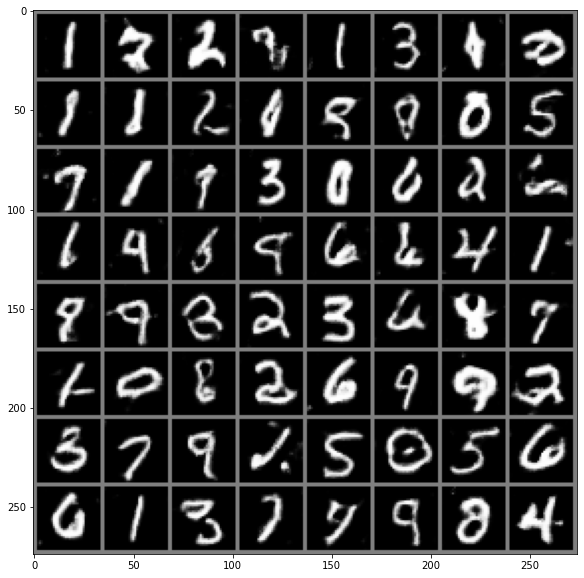

[Epoch 34/200] [Batch 242/937] [D loss: 0.141521] [G loss: 1.838886]
[Epoch 34/200] [Batch 342/937] [D loss: 0.194550] [G loss: 2.401011]
[Epoch 34/200] [Batch 442/937] [D loss: 0.210458] [G loss: 0.922675]
[Epoch 34/200] [Batch 542/937] [D loss: 0.420539] [G loss: 3.167382]
[Epoch 34/200] [Batch 642/937] [D loss: 0.050429] [G loss: 4.193409]
[Epoch 34/200] [Batch 742/937] [D loss: 0.145648] [G loss: 2.861437]
[Epoch 34/200] [Batch 842/937] [D loss: 0.094219] [G loss: 2.108935]
[Epoch 35/200] [Batch 5/937] [D loss: 0.121117] [G loss: 4.518790]
[Epoch 35/200] [Batch 105/937] [D loss: 0.210323] [G loss: 4.864991]
[Epoch 35/200] [Batch 205/937] [D loss: 0.144698] [G loss: 3.618001]
[Epoch 35/200] [Batch 305/937] [D loss: 0.339875] [G loss: 4.294994]
[Epoch 35/200] [Batch 405/937] [D loss: 0.306050] [G loss: 5.098799]
[Epoch 35/200] [Batch 505/937] [D loss: 0.086761] [G loss: 1.892759]
[Epoch 35/200] [Batch 605/937] [D loss: 0.076328] [G loss: 0.724273]
[Epoch 35/200] [Batch 705/937] [D lo

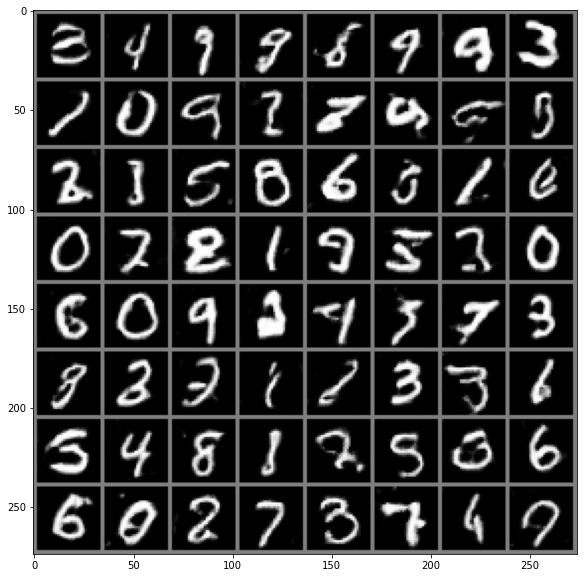

[Epoch 36/200] [Batch 368/937] [D loss: 0.403434] [G loss: 3.444086]
[Epoch 36/200] [Batch 468/937] [D loss: 0.160829] [G loss: 2.512042]
[Epoch 36/200] [Batch 568/937] [D loss: 0.260658] [G loss: 0.252501]
[Epoch 36/200] [Batch 668/937] [D loss: 0.209820] [G loss: 1.180209]
[Epoch 36/200] [Batch 768/937] [D loss: 0.291644] [G loss: 1.894260]
[Epoch 36/200] [Batch 868/937] [D loss: 0.161557] [G loss: 1.427082]
[Epoch 37/200] [Batch 31/937] [D loss: 0.124790] [G loss: 3.546889]
[Epoch 37/200] [Batch 131/937] [D loss: 0.277644] [G loss: 2.615059]
[Epoch 37/200] [Batch 231/937] [D loss: 0.184508] [G loss: 2.345387]
[Epoch 37/200] [Batch 331/937] [D loss: 0.152088] [G loss: 4.340419]
[Epoch 37/200] [Batch 431/937] [D loss: 0.133271] [G loss: 0.986443]
[Epoch 37/200] [Batch 531/937] [D loss: 0.162512] [G loss: 1.196548]
[Epoch 37/200] [Batch 631/937] [D loss: 0.216832] [G loss: 2.302987]
[Epoch 37/200] [Batch 731/937] [D loss: 0.534622] [G loss: 3.895927]
[Epoch 37/200] [Batch 831/937] [D l

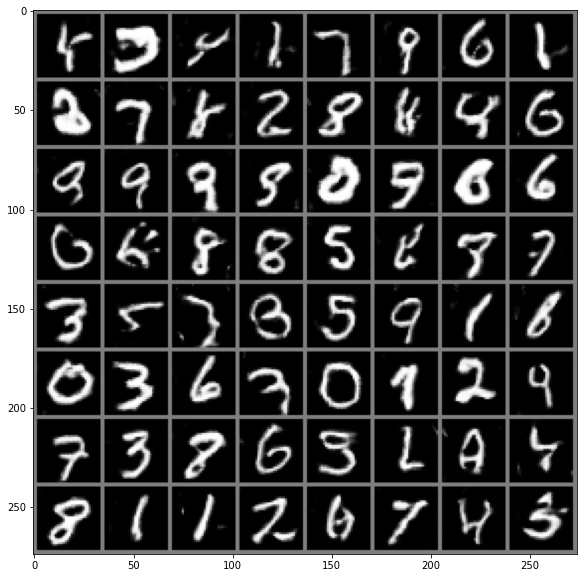

[Epoch 38/200] [Batch 494/937] [D loss: 0.098722] [G loss: 2.627437]
[Epoch 38/200] [Batch 594/937] [D loss: 0.130853] [G loss: 4.185825]
[Epoch 38/200] [Batch 694/937] [D loss: 0.042251] [G loss: 4.331044]
[Epoch 38/200] [Batch 794/937] [D loss: 0.064844] [G loss: 3.246278]
[Epoch 38/200] [Batch 894/937] [D loss: 0.112332] [G loss: 5.115584]
[Epoch 39/200] [Batch 57/937] [D loss: 0.224797] [G loss: 2.600017]
[Epoch 39/200] [Batch 157/937] [D loss: 0.180745] [G loss: 0.220526]
[Epoch 39/200] [Batch 257/937] [D loss: 0.062829] [G loss: 4.153074]
[Epoch 39/200] [Batch 357/937] [D loss: 0.065245] [G loss: 3.864028]
[Epoch 39/200] [Batch 457/937] [D loss: 0.234434] [G loss: 3.531151]
[Epoch 39/200] [Batch 557/937] [D loss: 0.078702] [G loss: 4.856311]
[Epoch 39/200] [Batch 657/937] [D loss: 0.080807] [G loss: 5.210895]
[Epoch 39/200] [Batch 757/937] [D loss: 0.240913] [G loss: 4.128148]
[Epoch 39/200] [Batch 857/937] [D loss: 0.294712] [G loss: 1.724876]
[Epoch 40/200] [Batch 20/937] [D lo

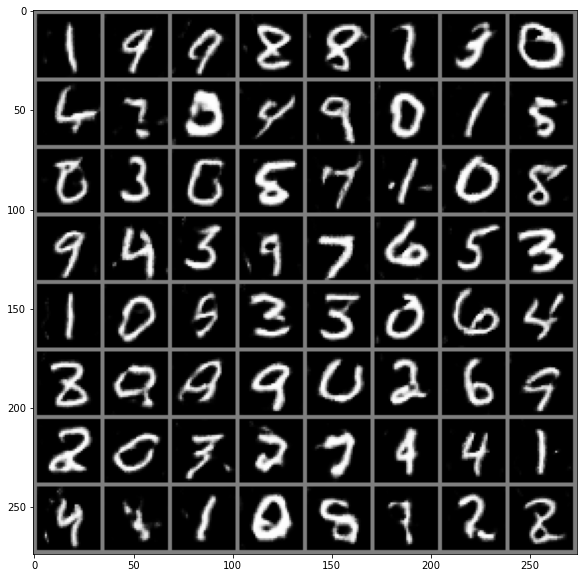

[Epoch 40/200] [Batch 620/937] [D loss: 0.045196] [G loss: 2.321916]
[Epoch 40/200] [Batch 720/937] [D loss: 0.181236] [G loss: 2.739661]
[Epoch 40/200] [Batch 820/937] [D loss: 0.223099] [G loss: 4.906152]
[Epoch 40/200] [Batch 920/937] [D loss: 0.275505] [G loss: 2.674178]
[Epoch 41/200] [Batch 83/937] [D loss: 0.379493] [G loss: 0.803623]
[Epoch 41/200] [Batch 183/937] [D loss: 0.182963] [G loss: 2.883255]
[Epoch 41/200] [Batch 283/937] [D loss: 0.295878] [G loss: 3.219077]
[Epoch 41/200] [Batch 383/937] [D loss: 0.068546] [G loss: 2.725950]
[Epoch 41/200] [Batch 483/937] [D loss: 0.115872] [G loss: 2.734993]
[Epoch 41/200] [Batch 583/937] [D loss: 0.136316] [G loss: 4.631073]
[Epoch 41/200] [Batch 683/937] [D loss: 0.051738] [G loss: 2.333585]
[Epoch 41/200] [Batch 783/937] [D loss: 0.170090] [G loss: 3.269861]
[Epoch 41/200] [Batch 883/937] [D loss: 0.065075] [G loss: 4.479218]
[Epoch 42/200] [Batch 46/937] [D loss: 0.507542] [G loss: 2.050965]
[Epoch 42/200] [Batch 146/937] [D lo

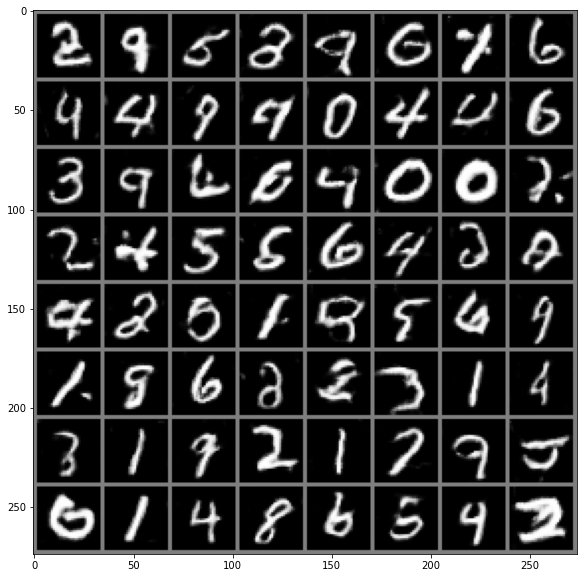

[Epoch 42/200] [Batch 746/937] [D loss: 0.168211] [G loss: 4.359466]
[Epoch 42/200] [Batch 846/937] [D loss: 0.021021] [G loss: 4.208238]
[Epoch 43/200] [Batch 9/937] [D loss: 0.084976] [G loss: 2.492612]
[Epoch 43/200] [Batch 109/937] [D loss: 0.204945] [G loss: 2.904923]
[Epoch 43/200] [Batch 209/937] [D loss: 0.220063] [G loss: 3.376379]
[Epoch 43/200] [Batch 309/937] [D loss: 0.200790] [G loss: 2.036889]
[Epoch 43/200] [Batch 409/937] [D loss: 0.142275] [G loss: 4.185098]
[Epoch 43/200] [Batch 509/937] [D loss: 0.033650] [G loss: 2.680056]
[Epoch 43/200] [Batch 609/937] [D loss: 0.184182] [G loss: 3.401222]
[Epoch 43/200] [Batch 709/937] [D loss: 0.193475] [G loss: 4.778796]
[Epoch 43/200] [Batch 809/937] [D loss: 0.459163] [G loss: 2.005819]
[Epoch 43/200] [Batch 909/937] [D loss: 0.119925] [G loss: 4.082764]
[Epoch 44/200] [Batch 72/937] [D loss: 0.057952] [G loss: 4.135543]
[Epoch 44/200] [Batch 172/937] [D loss: 0.048496] [G loss: 6.906370]
[Epoch 44/200] [Batch 272/937] [D los

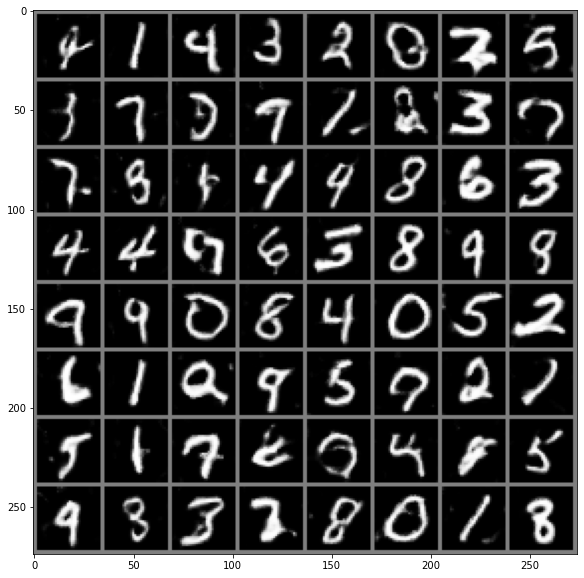

[Epoch 44/200] [Batch 872/937] [D loss: 0.127809] [G loss: 2.146664]
[Epoch 45/200] [Batch 35/937] [D loss: 0.101063] [G loss: 2.720388]
[Epoch 45/200] [Batch 135/937] [D loss: 0.155756] [G loss: 3.825953]
[Epoch 45/200] [Batch 235/937] [D loss: 0.052049] [G loss: 1.279746]
[Epoch 45/200] [Batch 335/937] [D loss: 0.190633] [G loss: 3.614949]
[Epoch 45/200] [Batch 435/937] [D loss: 0.367376] [G loss: 2.486109]
[Epoch 45/200] [Batch 535/937] [D loss: 0.261621] [G loss: 3.951252]
[Epoch 45/200] [Batch 635/937] [D loss: 0.478251] [G loss: 1.395854]
[Epoch 45/200] [Batch 735/937] [D loss: 0.048042] [G loss: 3.100643]
[Epoch 45/200] [Batch 835/937] [D loss: 0.367498] [G loss: 3.861329]
[Epoch 45/200] [Batch 935/937] [D loss: 0.211093] [G loss: 5.900781]
[Epoch 46/200] [Batch 98/937] [D loss: 0.252988] [G loss: 2.396398]
[Epoch 46/200] [Batch 198/937] [D loss: 0.095353] [G loss: 5.626738]
[Epoch 46/200] [Batch 298/937] [D loss: 0.178072] [G loss: 3.453590]
[Epoch 46/200] [Batch 398/937] [D lo

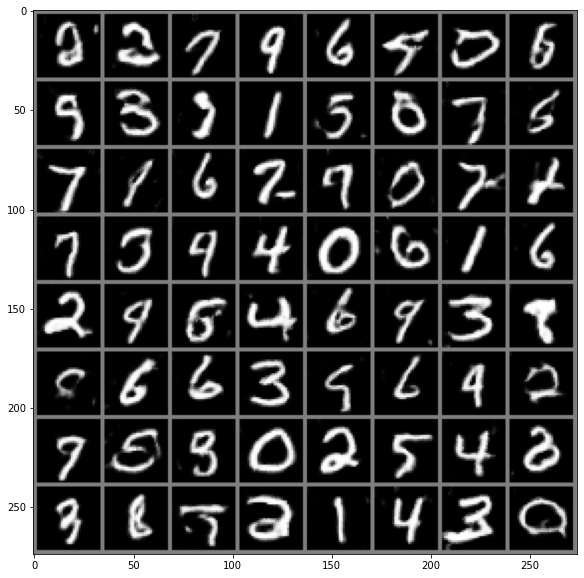

[Epoch 47/200] [Batch 61/937] [D loss: 0.275860] [G loss: 1.515017]
[Epoch 47/200] [Batch 161/937] [D loss: 0.071952] [G loss: 5.265145]
[Epoch 47/200] [Batch 261/937] [D loss: 0.250053] [G loss: 3.658576]
[Epoch 47/200] [Batch 361/937] [D loss: 0.072606] [G loss: 4.962814]
[Epoch 47/200] [Batch 461/937] [D loss: 0.066250] [G loss: 2.146046]
[Epoch 47/200] [Batch 561/937] [D loss: 0.251690] [G loss: 4.321367]
[Epoch 47/200] [Batch 661/937] [D loss: 0.209569] [G loss: 4.508220]
[Epoch 47/200] [Batch 761/937] [D loss: 0.058663] [G loss: 5.326643]
[Epoch 47/200] [Batch 861/937] [D loss: 0.099462] [G loss: 1.935173]
[Epoch 48/200] [Batch 24/937] [D loss: 0.176978] [G loss: 4.576727]
[Epoch 48/200] [Batch 124/937] [D loss: 0.039609] [G loss: 3.083626]
[Epoch 48/200] [Batch 224/937] [D loss: 0.334227] [G loss: 3.983581]
[Epoch 48/200] [Batch 324/937] [D loss: 0.113322] [G loss: 4.020179]
[Epoch 48/200] [Batch 424/937] [D loss: 0.033729] [G loss: 3.657996]
[Epoch 48/200] [Batch 524/937] [D lo

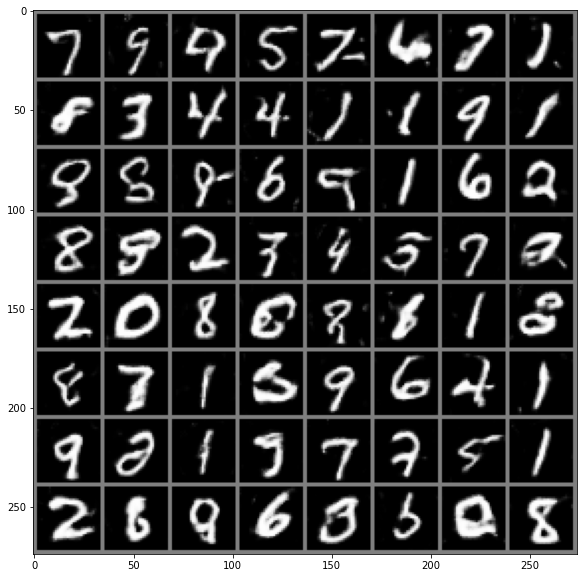

[Epoch 49/200] [Batch 187/937] [D loss: 0.100598] [G loss: 3.004429]
[Epoch 49/200] [Batch 287/937] [D loss: 0.073025] [G loss: 2.957325]
[Epoch 49/200] [Batch 387/937] [D loss: 0.074353] [G loss: 2.647106]
[Epoch 49/200] [Batch 487/937] [D loss: 1.181529] [G loss: 4.761185]
[Epoch 49/200] [Batch 587/937] [D loss: 0.100731] [G loss: 2.791520]
[Epoch 49/200] [Batch 687/937] [D loss: 0.317873] [G loss: 4.910239]
[Epoch 49/200] [Batch 787/937] [D loss: 0.018438] [G loss: 3.618713]
[Epoch 49/200] [Batch 887/937] [D loss: 0.171540] [G loss: 3.299347]
[Epoch 50/200] [Batch 50/937] [D loss: 0.141561] [G loss: 4.818299]
[Epoch 50/200] [Batch 150/937] [D loss: 0.251666] [G loss: 3.588577]
[Epoch 50/200] [Batch 250/937] [D loss: 0.106043] [G loss: 3.120128]
[Epoch 50/200] [Batch 350/937] [D loss: 0.020788] [G loss: 1.800195]
[Epoch 50/200] [Batch 450/937] [D loss: 0.440654] [G loss: 1.221314]
[Epoch 50/200] [Batch 550/937] [D loss: 0.260274] [G loss: 1.096712]
[Epoch 50/200] [Batch 650/937] [D l

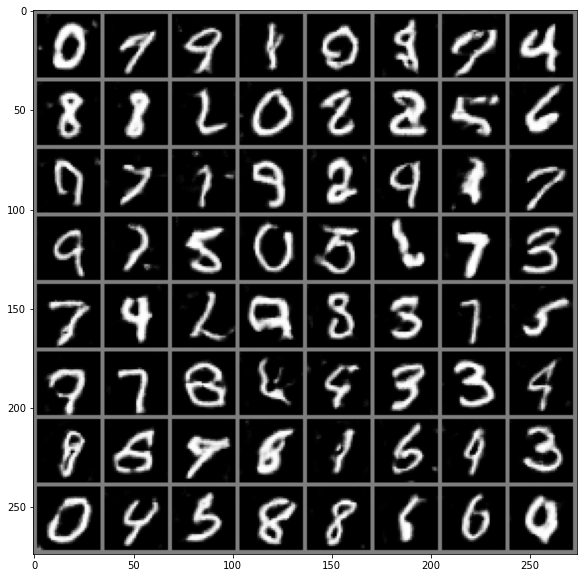

[Epoch 51/200] [Batch 313/937] [D loss: 0.087450] [G loss: 3.795995]
[Epoch 51/200] [Batch 413/937] [D loss: 0.006758] [G loss: 4.496582]
[Epoch 51/200] [Batch 513/937] [D loss: 0.288579] [G loss: 3.148005]
[Epoch 51/200] [Batch 613/937] [D loss: 0.047790] [G loss: 1.346058]
[Epoch 51/200] [Batch 713/937] [D loss: 0.040915] [G loss: 6.518669]
[Epoch 51/200] [Batch 813/937] [D loss: 0.048527] [G loss: 1.679600]
[Epoch 51/200] [Batch 913/937] [D loss: 0.270222] [G loss: 2.333630]
[Epoch 52/200] [Batch 76/937] [D loss: 0.069634] [G loss: 3.187058]
[Epoch 52/200] [Batch 176/937] [D loss: 0.045749] [G loss: 3.827766]
[Epoch 52/200] [Batch 276/937] [D loss: 0.087081] [G loss: 6.593138]
[Epoch 52/200] [Batch 376/937] [D loss: 0.213080] [G loss: 4.514937]
[Epoch 52/200] [Batch 476/937] [D loss: 0.025515] [G loss: 2.219784]
[Epoch 52/200] [Batch 576/937] [D loss: 0.032229] [G loss: 6.398298]
[Epoch 52/200] [Batch 676/937] [D loss: 0.063193] [G loss: 4.561623]
[Epoch 52/200] [Batch 776/937] [D l

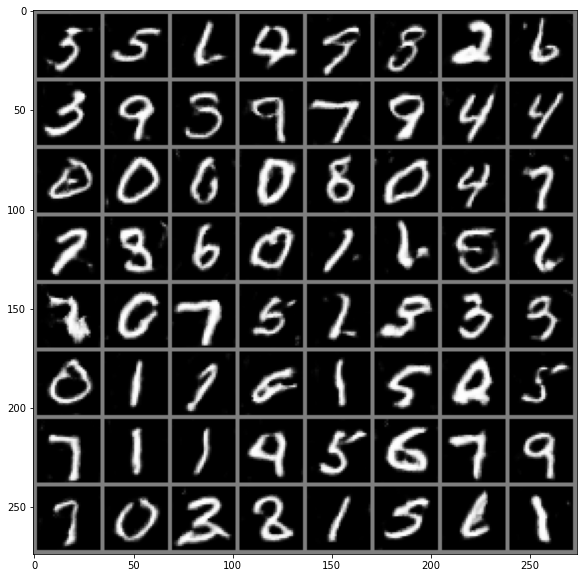

[Epoch 53/200] [Batch 439/937] [D loss: 0.129734] [G loss: 1.380108]
[Epoch 53/200] [Batch 539/937] [D loss: 0.067321] [G loss: 5.532961]
[Epoch 53/200] [Batch 639/937] [D loss: 0.028604] [G loss: 3.776589]
[Epoch 53/200] [Batch 739/937] [D loss: 0.049776] [G loss: 5.158842]
[Epoch 53/200] [Batch 839/937] [D loss: 0.029054] [G loss: 6.162941]
[Epoch 54/200] [Batch 2/937] [D loss: 0.017381] [G loss: 6.458458]
[Epoch 54/200] [Batch 102/937] [D loss: 0.101911] [G loss: 1.969534]
[Epoch 54/200] [Batch 202/937] [D loss: 0.013183] [G loss: 3.708106]
[Epoch 54/200] [Batch 302/937] [D loss: 0.180479] [G loss: 1.326512]
[Epoch 54/200] [Batch 402/937] [D loss: 0.062271] [G loss: 2.298796]
[Epoch 54/200] [Batch 502/937] [D loss: 0.060740] [G loss: 3.308404]
[Epoch 54/200] [Batch 602/937] [D loss: 0.143395] [G loss: 4.108684]
[Epoch 54/200] [Batch 702/937] [D loss: 0.057626] [G loss: 3.129250]
[Epoch 54/200] [Batch 802/937] [D loss: 0.141007] [G loss: 3.190602]
[Epoch 54/200] [Batch 902/937] [D lo

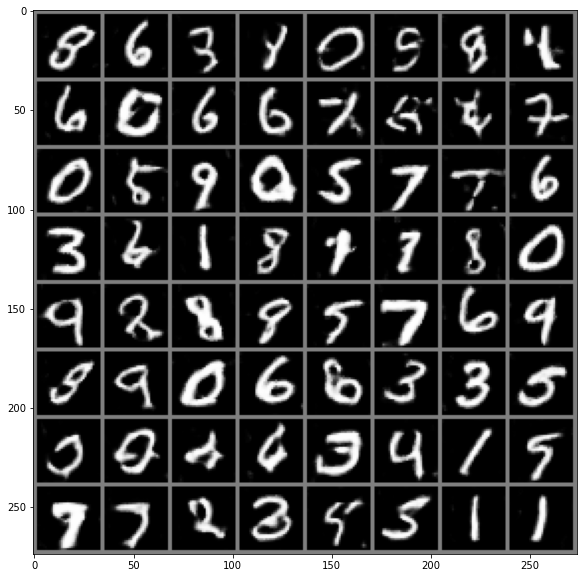

[Epoch 55/200] [Batch 565/937] [D loss: 0.176049] [G loss: 2.921574]
[Epoch 55/200] [Batch 665/937] [D loss: 0.128100] [G loss: 2.981915]
[Epoch 55/200] [Batch 765/937] [D loss: 0.152198] [G loss: 2.566456]
[Epoch 55/200] [Batch 865/937] [D loss: 0.164520] [G loss: 1.545115]
[Epoch 56/200] [Batch 28/937] [D loss: 0.032859] [G loss: 3.125100]
[Epoch 56/200] [Batch 128/937] [D loss: 0.084699] [G loss: 3.948153]
[Epoch 56/200] [Batch 228/937] [D loss: 0.012266] [G loss: 6.355324]
[Epoch 56/200] [Batch 328/937] [D loss: 0.162254] [G loss: 5.615586]
[Epoch 56/200] [Batch 428/937] [D loss: 0.029428] [G loss: 0.867315]
[Epoch 56/200] [Batch 528/937] [D loss: 0.037897] [G loss: 2.697687]
[Epoch 56/200] [Batch 628/937] [D loss: 0.064278] [G loss: 6.088698]
[Epoch 56/200] [Batch 728/937] [D loss: 0.059126] [G loss: 2.945617]
[Epoch 56/200] [Batch 828/937] [D loss: 0.092512] [G loss: 6.068089]
[Epoch 56/200] [Batch 928/937] [D loss: 0.314326] [G loss: 5.224882]
[Epoch 57/200] [Batch 91/937] [D lo

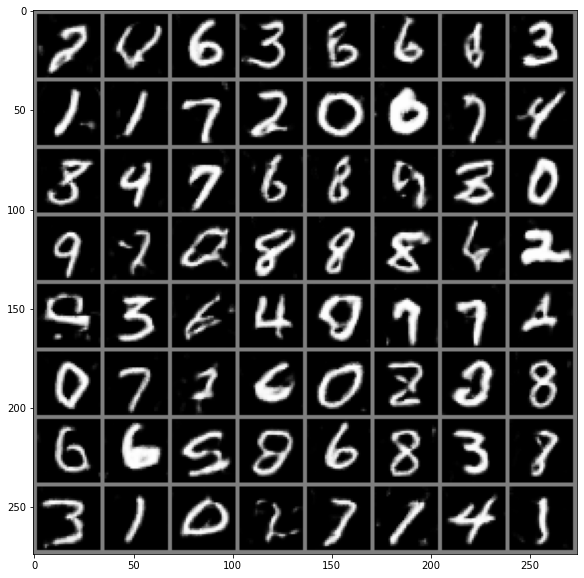

[Epoch 57/200] [Batch 691/937] [D loss: 0.426104] [G loss: 5.020629]
[Epoch 57/200] [Batch 791/937] [D loss: 0.031440] [G loss: 3.536746]
[Epoch 57/200] [Batch 891/937] [D loss: 0.205213] [G loss: 3.817873]
[Epoch 58/200] [Batch 54/937] [D loss: 0.022945] [G loss: 5.772018]
[Epoch 58/200] [Batch 154/937] [D loss: 0.134414] [G loss: 6.741518]
[Epoch 58/200] [Batch 254/937] [D loss: 0.059301] [G loss: 2.555263]
[Epoch 58/200] [Batch 354/937] [D loss: 0.367139] [G loss: 4.609766]
[Epoch 58/200] [Batch 454/937] [D loss: 0.032803] [G loss: 1.248807]
[Epoch 58/200] [Batch 554/937] [D loss: 0.769493] [G loss: 2.983123]
[Epoch 58/200] [Batch 654/937] [D loss: 0.063236] [G loss: 1.849279]
[Epoch 58/200] [Batch 754/937] [D loss: 0.203607] [G loss: 3.063005]
[Epoch 58/200] [Batch 854/937] [D loss: 0.036796] [G loss: 4.244884]
[Epoch 59/200] [Batch 17/937] [D loss: 0.062696] [G loss: 3.009578]
[Epoch 59/200] [Batch 117/937] [D loss: 0.047618] [G loss: 3.089345]
[Epoch 59/200] [Batch 217/937] [D lo

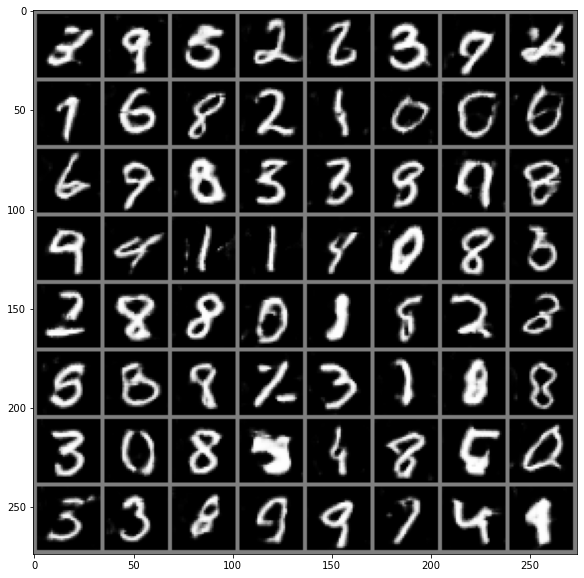

[Epoch 59/200] [Batch 817/937] [D loss: 0.102634] [G loss: 3.709312]
[Epoch 59/200] [Batch 917/937] [D loss: 0.036357] [G loss: 0.913875]
[Epoch 60/200] [Batch 80/937] [D loss: 0.053753] [G loss: 1.927956]
[Epoch 60/200] [Batch 180/937] [D loss: 0.013957] [G loss: 5.128194]
[Epoch 60/200] [Batch 280/937] [D loss: 0.174221] [G loss: 4.409272]
[Epoch 60/200] [Batch 380/937] [D loss: 0.027635] [G loss: 5.985326]
[Epoch 60/200] [Batch 480/937] [D loss: 0.200049] [G loss: 8.749057]
[Epoch 60/200] [Batch 580/937] [D loss: 0.103831] [G loss: 2.670562]
[Epoch 60/200] [Batch 680/937] [D loss: 0.034317] [G loss: 3.309578]
[Epoch 60/200] [Batch 780/937] [D loss: 0.487005] [G loss: 3.985357]
[Epoch 60/200] [Batch 880/937] [D loss: 0.026327] [G loss: 7.422654]
[Epoch 61/200] [Batch 43/937] [D loss: 0.012725] [G loss: 2.722786]
[Epoch 61/200] [Batch 143/937] [D loss: 0.092439] [G loss: 3.358043]
[Epoch 61/200] [Batch 243/937] [D loss: 0.142622] [G loss: 3.963456]
[Epoch 61/200] [Batch 343/937] [D lo

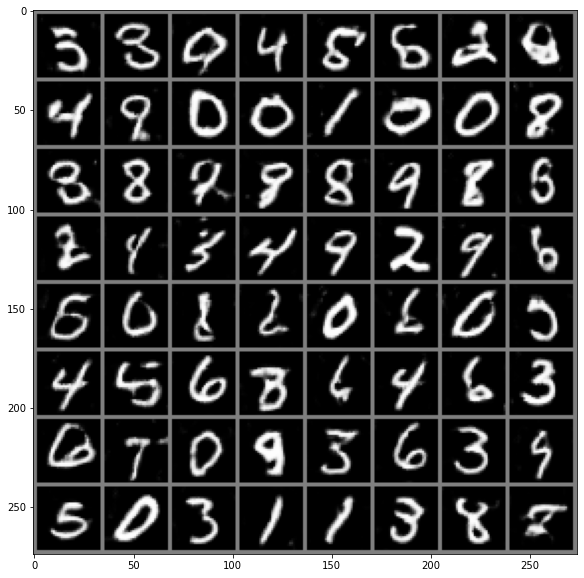

[Epoch 62/200] [Batch 6/937] [D loss: 0.015117] [G loss: 3.474126]
[Epoch 62/200] [Batch 106/937] [D loss: 0.070146] [G loss: 1.365907]
[Epoch 62/200] [Batch 206/937] [D loss: 0.426112] [G loss: 5.066307]
[Epoch 62/200] [Batch 306/937] [D loss: 0.036762] [G loss: 3.057665]
[Epoch 62/200] [Batch 406/937] [D loss: 0.014996] [G loss: 1.229904]
[Epoch 62/200] [Batch 506/937] [D loss: 0.039963] [G loss: 4.102397]
[Epoch 62/200] [Batch 606/937] [D loss: 0.202086] [G loss: 1.138654]
[Epoch 62/200] [Batch 706/937] [D loss: 0.089581] [G loss: 4.138919]
[Epoch 62/200] [Batch 806/937] [D loss: 0.026396] [G loss: 1.602591]
[Epoch 62/200] [Batch 906/937] [D loss: 0.032781] [G loss: 6.418655]
[Epoch 63/200] [Batch 69/937] [D loss: 0.019764] [G loss: 5.484661]
[Epoch 63/200] [Batch 169/937] [D loss: 0.018354] [G loss: 4.669115]
[Epoch 63/200] [Batch 269/937] [D loss: 0.054444] [G loss: 4.361359]
[Epoch 63/200] [Batch 369/937] [D loss: 0.016704] [G loss: 5.046281]
[Epoch 63/200] [Batch 469/937] [D los

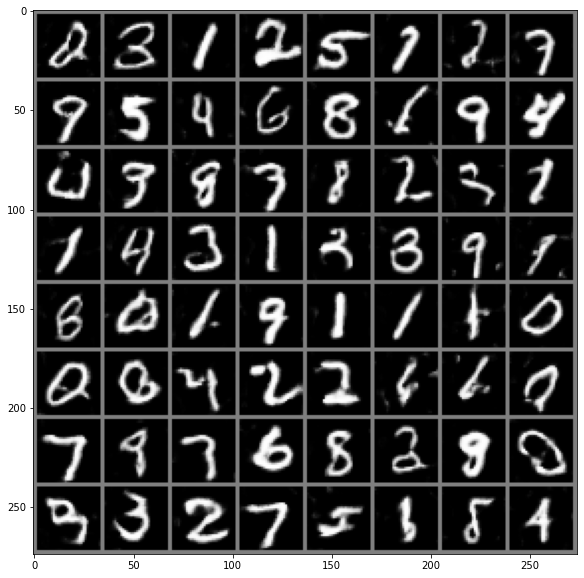

[Epoch 64/200] [Batch 132/937] [D loss: 0.033359] [G loss: 4.561472]
[Epoch 64/200] [Batch 232/937] [D loss: 0.027988] [G loss: 2.585250]
[Epoch 64/200] [Batch 332/937] [D loss: 0.027233] [G loss: 3.639615]
[Epoch 64/200] [Batch 432/937] [D loss: 0.083875] [G loss: 8.038460]
[Epoch 64/200] [Batch 532/937] [D loss: 0.189239] [G loss: 2.145133]
[Epoch 64/200] [Batch 632/937] [D loss: 0.497465] [G loss: 4.829938]
[Epoch 64/200] [Batch 732/937] [D loss: 0.635756] [G loss: 3.571350]
[Epoch 64/200] [Batch 832/937] [D loss: 0.154875] [G loss: 6.064136]
[Epoch 64/200] [Batch 932/937] [D loss: 0.123003] [G loss: 6.100208]
[Epoch 65/200] [Batch 95/937] [D loss: 0.012412] [G loss: 3.969784]
[Epoch 65/200] [Batch 195/937] [D loss: 0.037119] [G loss: 3.907599]
[Epoch 65/200] [Batch 295/937] [D loss: 0.200520] [G loss: 1.340260]
[Epoch 65/200] [Batch 395/937] [D loss: 0.015552] [G loss: 4.902879]
[Epoch 65/200] [Batch 495/937] [D loss: 0.046932] [G loss: 5.987736]
[Epoch 65/200] [Batch 595/937] [D l

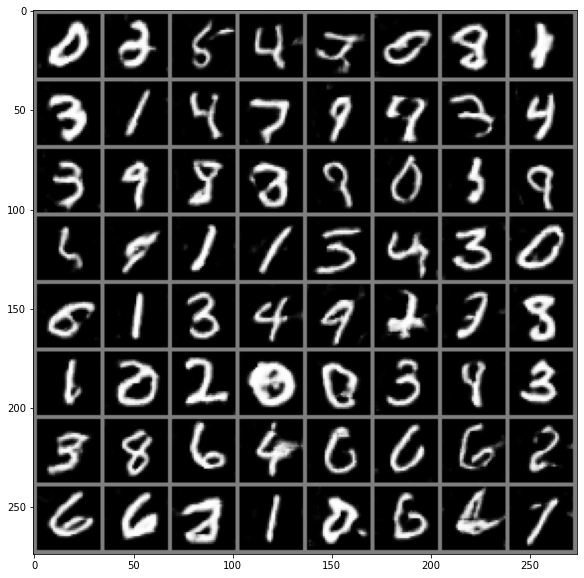

[Epoch 66/200] [Batch 258/937] [D loss: 0.085512] [G loss: 5.826120]
[Epoch 66/200] [Batch 358/937] [D loss: 0.022422] [G loss: 4.231898]
[Epoch 66/200] [Batch 458/937] [D loss: 0.045474] [G loss: 1.793776]
[Epoch 66/200] [Batch 558/937] [D loss: 0.008711] [G loss: 8.124148]
[Epoch 66/200] [Batch 658/937] [D loss: 0.120170] [G loss: 3.695487]
[Epoch 66/200] [Batch 758/937] [D loss: 0.034263] [G loss: 1.475487]
[Epoch 66/200] [Batch 858/937] [D loss: 0.141707] [G loss: 2.249916]
[Epoch 67/200] [Batch 21/937] [D loss: 0.021712] [G loss: 1.802225]
[Epoch 67/200] [Batch 121/937] [D loss: 0.016790] [G loss: 5.066872]
[Epoch 67/200] [Batch 221/937] [D loss: 0.052061] [G loss: 8.190445]
[Epoch 67/200] [Batch 321/937] [D loss: 0.102857] [G loss: 4.781738]
[Epoch 67/200] [Batch 421/937] [D loss: 0.141580] [G loss: 3.826466]
[Epoch 67/200] [Batch 521/937] [D loss: 0.155075] [G loss: 3.297109]
[Epoch 67/200] [Batch 621/937] [D loss: 0.021991] [G loss: 2.348487]
[Epoch 67/200] [Batch 721/937] [D l

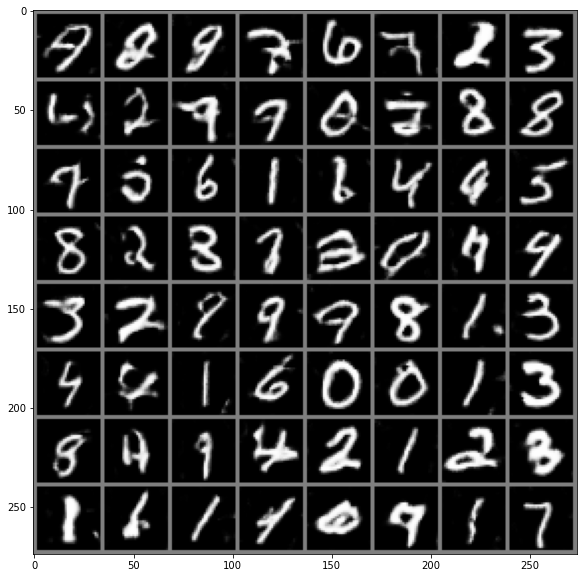

[Epoch 68/200] [Batch 384/937] [D loss: 0.056836] [G loss: 4.997617]
[Epoch 68/200] [Batch 484/937] [D loss: 0.127383] [G loss: 5.416205]
[Epoch 68/200] [Batch 584/937] [D loss: 0.076197] [G loss: 6.091878]
[Epoch 68/200] [Batch 684/937] [D loss: 0.023774] [G loss: 2.208555]
[Epoch 68/200] [Batch 784/937] [D loss: 0.186052] [G loss: 1.552725]
[Epoch 68/200] [Batch 884/937] [D loss: 0.014209] [G loss: 4.651838]
[Epoch 69/200] [Batch 47/937] [D loss: 0.185485] [G loss: 2.996396]
[Epoch 69/200] [Batch 147/937] [D loss: 0.142097] [G loss: 4.415316]
[Epoch 69/200] [Batch 247/937] [D loss: 0.024076] [G loss: 4.177256]
[Epoch 69/200] [Batch 347/937] [D loss: 0.006045] [G loss: 4.529896]
[Epoch 69/200] [Batch 447/937] [D loss: 0.026118] [G loss: 4.093151]
[Epoch 69/200] [Batch 547/937] [D loss: 0.009827] [G loss: 3.845198]
[Epoch 69/200] [Batch 647/937] [D loss: 0.007408] [G loss: 4.616570]
[Epoch 69/200] [Batch 747/937] [D loss: 0.033814] [G loss: 4.633398]
[Epoch 69/200] [Batch 847/937] [D l

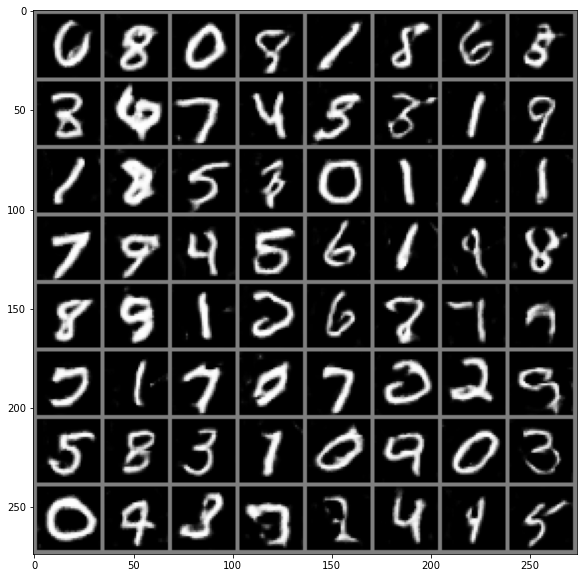

[Epoch 70/200] [Batch 510/937] [D loss: 0.016008] [G loss: 7.444216]
[Epoch 70/200] [Batch 610/937] [D loss: 0.008829] [G loss: 5.842402]
[Epoch 70/200] [Batch 710/937] [D loss: 0.087101] [G loss: 8.544603]
[Epoch 70/200] [Batch 810/937] [D loss: 0.049039] [G loss: 4.861246]
[Epoch 70/200] [Batch 910/937] [D loss: 0.041199] [G loss: 6.653891]
[Epoch 71/200] [Batch 73/937] [D loss: 0.213486] [G loss: 4.159974]
[Epoch 71/200] [Batch 173/937] [D loss: 0.015398] [G loss: 3.466432]
[Epoch 71/200] [Batch 273/937] [D loss: 0.218962] [G loss: 1.467286]
[Epoch 71/200] [Batch 373/937] [D loss: 0.114201] [G loss: 5.489918]
[Epoch 71/200] [Batch 473/937] [D loss: 0.084201] [G loss: 2.734121]
[Epoch 71/200] [Batch 573/937] [D loss: 0.019018] [G loss: 4.488607]
[Epoch 71/200] [Batch 673/937] [D loss: 0.049907] [G loss: 4.899377]
[Epoch 71/200] [Batch 773/937] [D loss: 0.048812] [G loss: 6.568502]
[Epoch 71/200] [Batch 873/937] [D loss: 0.036458] [G loss: 3.415233]
[Epoch 72/200] [Batch 36/937] [D lo

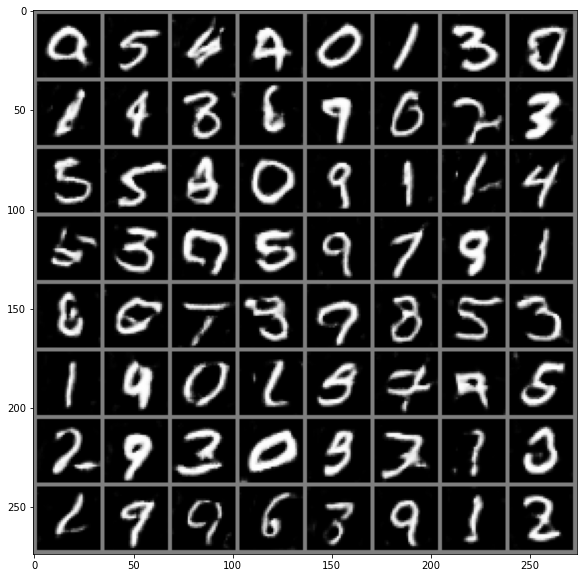

[Epoch 72/200] [Batch 636/937] [D loss: 0.050140] [G loss: 6.386252]
[Epoch 72/200] [Batch 736/937] [D loss: 0.033998] [G loss: 3.811228]
[Epoch 72/200] [Batch 836/937] [D loss: 0.026980] [G loss: 5.281008]
[Epoch 72/200] [Batch 936/937] [D loss: 0.009440] [G loss: 2.244236]
[Epoch 73/200] [Batch 99/937] [D loss: 0.129300] [G loss: 1.727641]
[Epoch 73/200] [Batch 199/937] [D loss: 0.047483] [G loss: 3.956779]
[Epoch 73/200] [Batch 299/937] [D loss: 0.027358] [G loss: 3.937708]
[Epoch 73/200] [Batch 399/937] [D loss: 0.003850] [G loss: 3.001675]
[Epoch 73/200] [Batch 499/937] [D loss: 0.107757] [G loss: 5.094563]
[Epoch 73/200] [Batch 599/937] [D loss: 0.034042] [G loss: 3.575942]
[Epoch 73/200] [Batch 699/937] [D loss: 0.045537] [G loss: 2.223733]
[Epoch 73/200] [Batch 799/937] [D loss: 0.490970] [G loss: 4.712302]
[Epoch 73/200] [Batch 899/937] [D loss: 0.054759] [G loss: 1.647504]
[Epoch 74/200] [Batch 62/937] [D loss: 0.029175] [G loss: 6.949275]
[Epoch 74/200] [Batch 162/937] [D lo

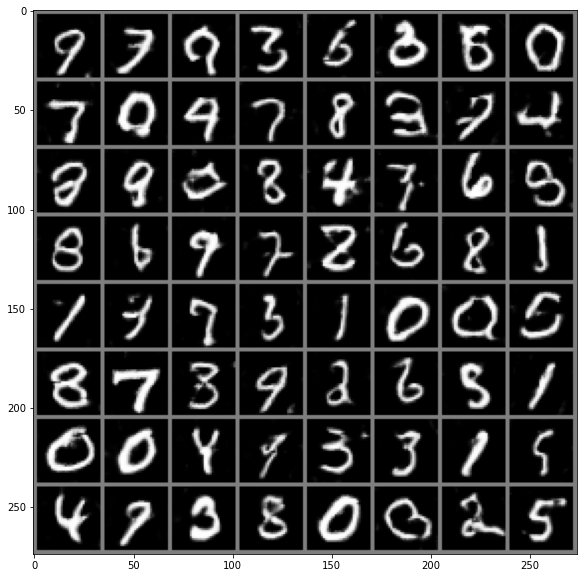

[Epoch 74/200] [Batch 762/937] [D loss: 0.012590] [G loss: 5.410360]
[Epoch 74/200] [Batch 862/937] [D loss: 0.167955] [G loss: 3.013714]
[Epoch 75/200] [Batch 25/937] [D loss: 0.122552] [G loss: 2.952504]
[Epoch 75/200] [Batch 125/937] [D loss: 0.397241] [G loss: 0.311424]
[Epoch 75/200] [Batch 225/937] [D loss: 0.058887] [G loss: 2.615599]
[Epoch 75/200] [Batch 325/937] [D loss: 0.164903] [G loss: 1.839571]
[Epoch 75/200] [Batch 425/937] [D loss: 0.004570] [G loss: 3.667850]
[Epoch 75/200] [Batch 525/937] [D loss: 0.549784] [G loss: 1.893328]
[Epoch 75/200] [Batch 625/937] [D loss: 0.007697] [G loss: 6.692929]
[Epoch 75/200] [Batch 725/937] [D loss: 0.078327] [G loss: 2.340184]
[Epoch 75/200] [Batch 825/937] [D loss: 0.109243] [G loss: 4.168284]
[Epoch 75/200] [Batch 925/937] [D loss: 0.006735] [G loss: 7.537906]
[Epoch 76/200] [Batch 88/937] [D loss: 0.009291] [G loss: 2.727720]
[Epoch 76/200] [Batch 188/937] [D loss: 0.046968] [G loss: 2.974542]
[Epoch 76/200] [Batch 288/937] [D lo

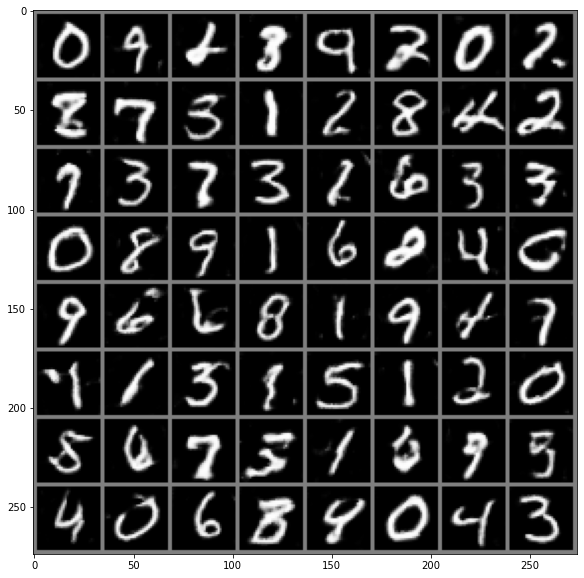

[Epoch 76/200] [Batch 888/937] [D loss: 0.019011] [G loss: 3.529182]
[Epoch 77/200] [Batch 51/937] [D loss: 0.014915] [G loss: 3.471440]
[Epoch 77/200] [Batch 151/937] [D loss: 0.111388] [G loss: 6.891668]
[Epoch 77/200] [Batch 251/937] [D loss: 0.195696] [G loss: 6.041198]
[Epoch 77/200] [Batch 351/937] [D loss: 0.140643] [G loss: 6.040499]
[Epoch 77/200] [Batch 451/937] [D loss: 0.052571] [G loss: 4.722658]
[Epoch 77/200] [Batch 551/937] [D loss: 0.039719] [G loss: 1.836082]
[Epoch 77/200] [Batch 651/937] [D loss: 0.154031] [G loss: 3.789945]
[Epoch 77/200] [Batch 751/937] [D loss: 0.288391] [G loss: 4.889375]
[Epoch 77/200] [Batch 851/937] [D loss: 0.013119] [G loss: 6.417511]
[Epoch 78/200] [Batch 14/937] [D loss: 0.193082] [G loss: 4.216878]
[Epoch 78/200] [Batch 114/937] [D loss: 0.052270] [G loss: 4.532557]
[Epoch 78/200] [Batch 214/937] [D loss: 0.152286] [G loss: 1.025700]
[Epoch 78/200] [Batch 314/937] [D loss: 0.023932] [G loss: 5.804180]
[Epoch 78/200] [Batch 414/937] [D lo

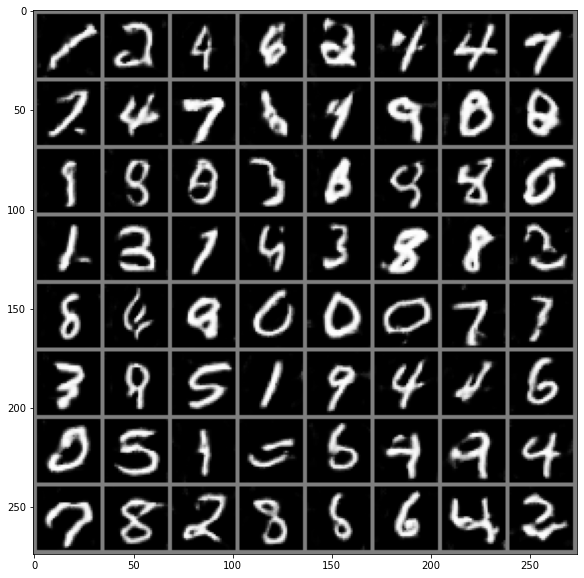

[Epoch 79/200] [Batch 77/937] [D loss: 0.023257] [G loss: 3.694980]
[Epoch 79/200] [Batch 177/937] [D loss: 0.037307] [G loss: 6.451992]
[Epoch 79/200] [Batch 277/937] [D loss: 0.176553] [G loss: 4.854079]
[Epoch 79/200] [Batch 377/937] [D loss: 0.019724] [G loss: 5.099258]
[Epoch 79/200] [Batch 477/937] [D loss: 0.278036] [G loss: 7.071399]
[Epoch 79/200] [Batch 577/937] [D loss: 0.158541] [G loss: 2.350530]
[Epoch 79/200] [Batch 677/937] [D loss: 0.142556] [G loss: 4.104427]
[Epoch 79/200] [Batch 777/937] [D loss: 0.098490] [G loss: 6.826530]
[Epoch 79/200] [Batch 877/937] [D loss: 0.017606] [G loss: 4.967801]
[Epoch 80/200] [Batch 40/937] [D loss: 0.153603] [G loss: 6.320472]
[Epoch 80/200] [Batch 140/937] [D loss: 0.025418] [G loss: 4.688621]
[Epoch 80/200] [Batch 240/937] [D loss: 0.010344] [G loss: 6.304513]
[Epoch 80/200] [Batch 340/937] [D loss: 0.012357] [G loss: 5.569468]
[Epoch 80/200] [Batch 440/937] [D loss: 0.043154] [G loss: 2.784853]
[Epoch 80/200] [Batch 540/937] [D lo

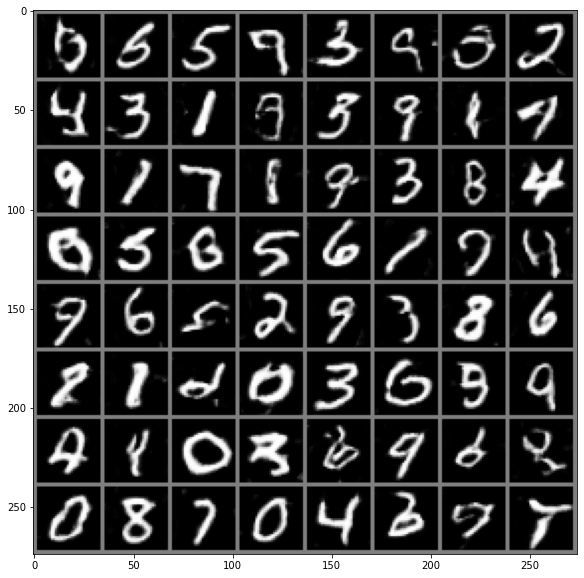

[Epoch 81/200] [Batch 203/937] [D loss: 0.122578] [G loss: 6.327932]
[Epoch 81/200] [Batch 303/937] [D loss: 0.014653] [G loss: 1.703634]
[Epoch 81/200] [Batch 403/937] [D loss: 0.206327] [G loss: 5.140571]
[Epoch 81/200] [Batch 503/937] [D loss: 0.057992] [G loss: 3.354087]
[Epoch 81/200] [Batch 603/937] [D loss: 0.105689] [G loss: 8.362612]
[Epoch 81/200] [Batch 703/937] [D loss: 0.087411] [G loss: 7.783410]
[Epoch 81/200] [Batch 803/937] [D loss: 0.052367] [G loss: 4.157309]
[Epoch 81/200] [Batch 903/937] [D loss: 0.018381] [G loss: 7.747538]
[Epoch 82/200] [Batch 66/937] [D loss: 0.002685] [G loss: 6.712049]
[Epoch 82/200] [Batch 166/937] [D loss: 0.008829] [G loss: 5.663064]
[Epoch 82/200] [Batch 266/937] [D loss: 0.087238] [G loss: 2.754555]
[Epoch 82/200] [Batch 366/937] [D loss: 0.021095] [G loss: 4.902586]
[Epoch 82/200] [Batch 466/937] [D loss: 0.024103] [G loss: 5.027691]
[Epoch 82/200] [Batch 566/937] [D loss: 0.028547] [G loss: 3.945284]
[Epoch 82/200] [Batch 666/937] [D l

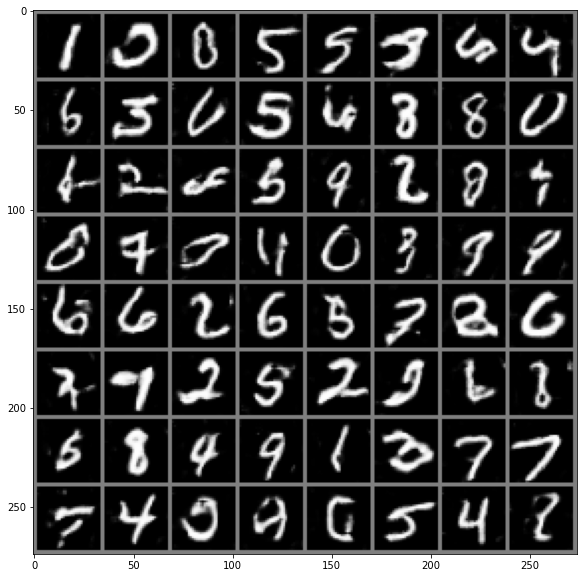

[Epoch 83/200] [Batch 329/937] [D loss: 0.425730] [G loss: 3.771151]
[Epoch 83/200] [Batch 429/937] [D loss: 0.061071] [G loss: 7.251227]
[Epoch 83/200] [Batch 529/937] [D loss: 0.065528] [G loss: 4.739118]
[Epoch 83/200] [Batch 629/937] [D loss: 0.008822] [G loss: 4.929125]
[Epoch 83/200] [Batch 729/937] [D loss: 0.003468] [G loss: 4.635072]
[Epoch 83/200] [Batch 829/937] [D loss: 0.037635] [G loss: 5.764001]
[Epoch 83/200] [Batch 929/937] [D loss: 0.032755] [G loss: 6.116484]
[Epoch 84/200] [Batch 92/937] [D loss: 0.033473] [G loss: 7.579216]
[Epoch 84/200] [Batch 192/937] [D loss: 0.027377] [G loss: 4.225132]
[Epoch 84/200] [Batch 292/937] [D loss: 0.010644] [G loss: 7.476874]
[Epoch 84/200] [Batch 392/937] [D loss: 0.048262] [G loss: 7.896027]
[Epoch 84/200] [Batch 492/937] [D loss: 0.049437] [G loss: 4.981813]
[Epoch 84/200] [Batch 592/937] [D loss: 0.025065] [G loss: 6.705574]
[Epoch 84/200] [Batch 692/937] [D loss: 0.808983] [G loss: 2.436272]
[Epoch 84/200] [Batch 792/937] [D l

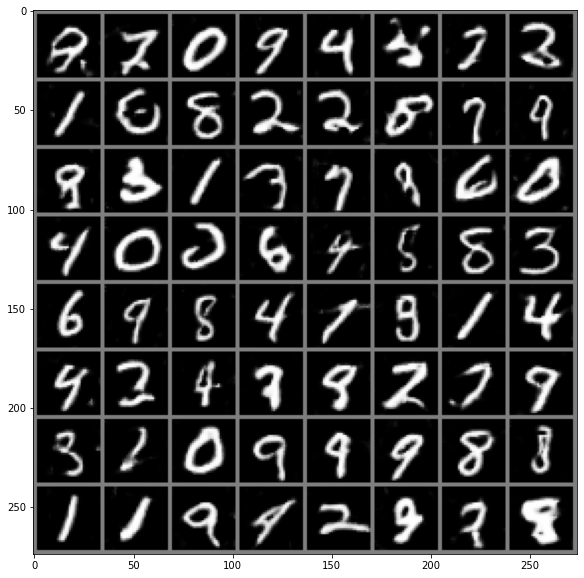

[Epoch 85/200] [Batch 455/937] [D loss: 0.006395] [G loss: 5.793491]
[Epoch 85/200] [Batch 555/937] [D loss: 0.236566] [G loss: 1.513289]
[Epoch 85/200] [Batch 655/937] [D loss: 0.025730] [G loss: 0.746082]
[Epoch 85/200] [Batch 755/937] [D loss: 0.009607] [G loss: 6.327067]
[Epoch 85/200] [Batch 855/937] [D loss: 0.048733] [G loss: 3.294785]
[Epoch 86/200] [Batch 18/937] [D loss: 0.005655] [G loss: 3.548023]
[Epoch 86/200] [Batch 118/937] [D loss: 0.073273] [G loss: 4.674892]
[Epoch 86/200] [Batch 218/937] [D loss: 0.080053] [G loss: 3.947509]
[Epoch 86/200] [Batch 318/937] [D loss: 0.040570] [G loss: 2.833060]
[Epoch 86/200] [Batch 418/937] [D loss: 0.150831] [G loss: 6.896341]
[Epoch 86/200] [Batch 518/937] [D loss: 0.035622] [G loss: 1.882543]
[Epoch 86/200] [Batch 618/937] [D loss: 0.234418] [G loss: 3.488253]
[Epoch 86/200] [Batch 718/937] [D loss: 0.017418] [G loss: 5.086414]
[Epoch 86/200] [Batch 818/937] [D loss: 0.049448] [G loss: 5.630626]
[Epoch 86/200] [Batch 918/937] [D l

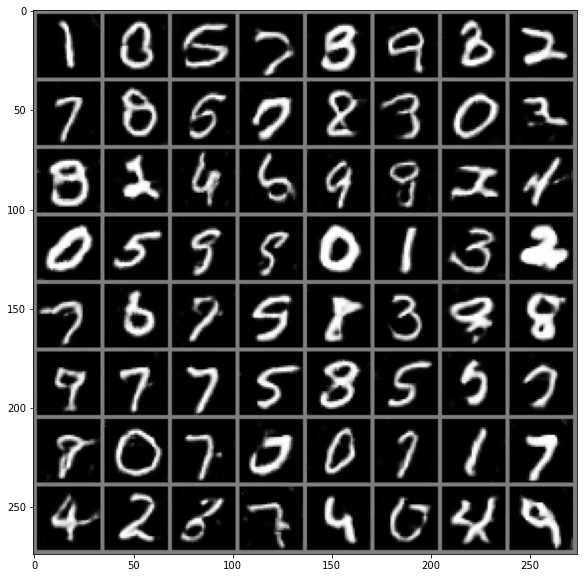

[Epoch 87/200] [Batch 581/937] [D loss: 0.147568] [G loss: 4.043396]
[Epoch 87/200] [Batch 681/937] [D loss: 0.111041] [G loss: 6.464717]
[Epoch 87/200] [Batch 781/937] [D loss: 0.027339] [G loss: 6.738139]
[Epoch 87/200] [Batch 881/937] [D loss: 0.028524] [G loss: 6.901582]
[Epoch 88/200] [Batch 44/937] [D loss: 0.028618] [G loss: 5.048457]
[Epoch 88/200] [Batch 144/937] [D loss: 0.004271] [G loss: 7.109615]
[Epoch 88/200] [Batch 244/937] [D loss: 0.064251] [G loss: 7.126782]
[Epoch 88/200] [Batch 344/937] [D loss: 0.046228] [G loss: 3.872342]
[Epoch 88/200] [Batch 444/937] [D loss: 0.056960] [G loss: 4.476656]
[Epoch 88/200] [Batch 544/937] [D loss: 0.009739] [G loss: 5.006562]
[Epoch 88/200] [Batch 644/937] [D loss: 0.065237] [G loss: 4.780404]
[Epoch 88/200] [Batch 744/937] [D loss: 0.048817] [G loss: 1.195712]
[Epoch 88/200] [Batch 844/937] [D loss: 0.112529] [G loss: 4.807949]
[Epoch 89/200] [Batch 7/937] [D loss: 0.088908] [G loss: 7.635724]
[Epoch 89/200] [Batch 107/937] [D los

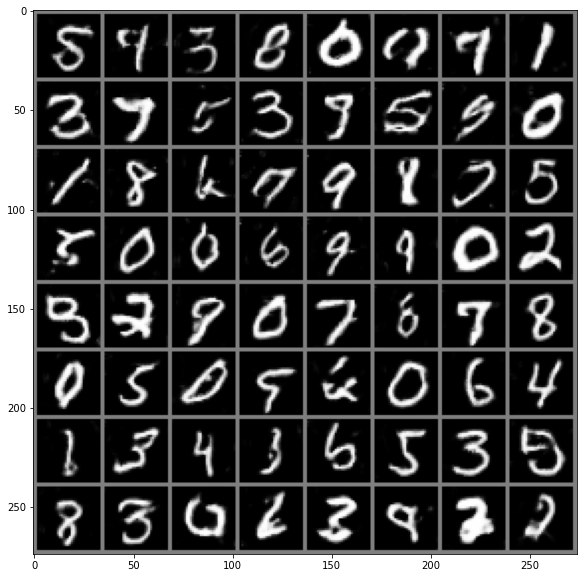

[Epoch 89/200] [Batch 707/937] [D loss: 0.203360] [G loss: 4.814133]
[Epoch 89/200] [Batch 807/937] [D loss: 0.890597] [G loss: 6.768595]
[Epoch 89/200] [Batch 907/937] [D loss: 0.002291] [G loss: 3.524440]
[Epoch 90/200] [Batch 70/937] [D loss: 0.005116] [G loss: 5.106998]
[Epoch 90/200] [Batch 170/937] [D loss: 0.011345] [G loss: 10.643901]
[Epoch 90/200] [Batch 270/937] [D loss: 0.097831] [G loss: 7.616534]
[Epoch 90/200] [Batch 370/937] [D loss: 0.034146] [G loss: 3.449627]
[Epoch 90/200] [Batch 470/937] [D loss: 0.106676] [G loss: 2.776285]
[Epoch 90/200] [Batch 570/937] [D loss: 0.090086] [G loss: 6.791793]
[Epoch 90/200] [Batch 670/937] [D loss: 0.045523] [G loss: 6.755654]
[Epoch 90/200] [Batch 770/937] [D loss: 0.026654] [G loss: 8.242651]
[Epoch 90/200] [Batch 870/937] [D loss: 0.044407] [G loss: 6.797704]
[Epoch 91/200] [Batch 33/937] [D loss: 0.207805] [G loss: 4.866933]
[Epoch 91/200] [Batch 133/937] [D loss: 0.051568] [G loss: 4.138872]
[Epoch 91/200] [Batch 233/937] [D l

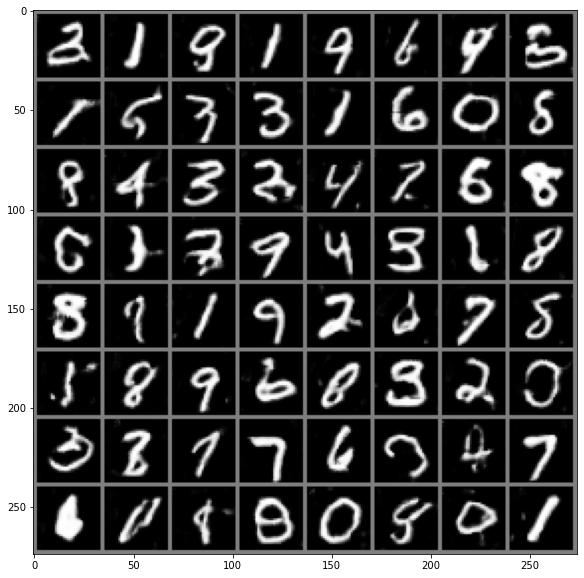

[Epoch 91/200] [Batch 833/937] [D loss: 0.013885] [G loss: 2.533362]
[Epoch 91/200] [Batch 933/937] [D loss: 0.008065] [G loss: 5.525837]
[Epoch 92/200] [Batch 96/937] [D loss: 0.023070] [G loss: 6.799536]
[Epoch 92/200] [Batch 196/937] [D loss: 0.006315] [G loss: 3.753374]
[Epoch 92/200] [Batch 296/937] [D loss: 0.016867] [G loss: 5.059850]
[Epoch 92/200] [Batch 396/937] [D loss: 0.075567] [G loss: 3.320149]
[Epoch 92/200] [Batch 496/937] [D loss: 0.021864] [G loss: 7.186861]
[Epoch 92/200] [Batch 596/937] [D loss: 0.011197] [G loss: 7.670963]
[Epoch 92/200] [Batch 696/937] [D loss: 0.142707] [G loss: 2.790381]
[Epoch 92/200] [Batch 796/937] [D loss: 0.065412] [G loss: 3.912981]
[Epoch 92/200] [Batch 896/937] [D loss: 0.016724] [G loss: 5.009958]
[Epoch 93/200] [Batch 59/937] [D loss: 0.001819] [G loss: 6.228838]
[Epoch 93/200] [Batch 159/937] [D loss: 0.480586] [G loss: 3.841354]
[Epoch 93/200] [Batch 259/937] [D loss: 0.002227] [G loss: 6.367487]
[Epoch 93/200] [Batch 359/937] [D lo

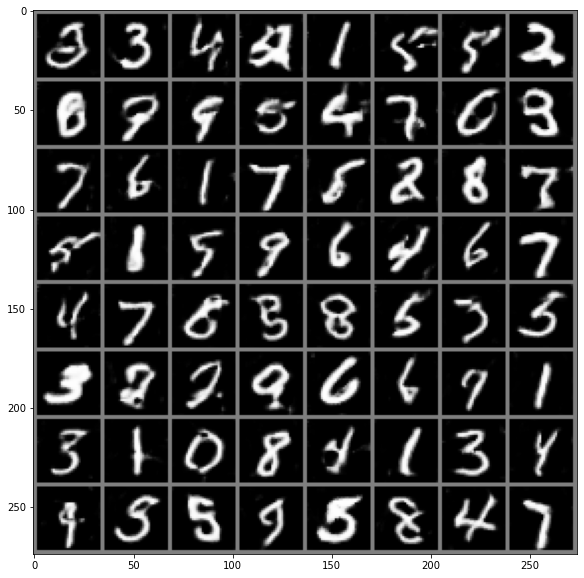

[Epoch 94/200] [Batch 22/937] [D loss: 0.055894] [G loss: 5.886303]
[Epoch 94/200] [Batch 122/937] [D loss: 0.015107] [G loss: 5.972017]
[Epoch 94/200] [Batch 222/937] [D loss: 0.004721] [G loss: 4.109518]
[Epoch 94/200] [Batch 322/937] [D loss: 0.200023] [G loss: 1.544818]
[Epoch 94/200] [Batch 422/937] [D loss: 0.030116] [G loss: 6.757756]
[Epoch 94/200] [Batch 522/937] [D loss: 0.017323] [G loss: 8.330635]
[Epoch 94/200] [Batch 622/937] [D loss: 0.233469] [G loss: 8.122568]
[Epoch 94/200] [Batch 722/937] [D loss: 0.125343] [G loss: 4.531638]
[Epoch 94/200] [Batch 822/937] [D loss: 0.001956] [G loss: 5.074998]
[Epoch 94/200] [Batch 922/937] [D loss: 0.001419] [G loss: 7.005368]
[Epoch 95/200] [Batch 85/937] [D loss: 0.015205] [G loss: 5.625736]
[Epoch 95/200] [Batch 185/937] [D loss: 0.018186] [G loss: 7.706323]
[Epoch 95/200] [Batch 285/937] [D loss: 0.018670] [G loss: 5.421780]
[Epoch 95/200] [Batch 385/937] [D loss: 0.093408] [G loss: 5.674703]
[Epoch 95/200] [Batch 485/937] [D lo

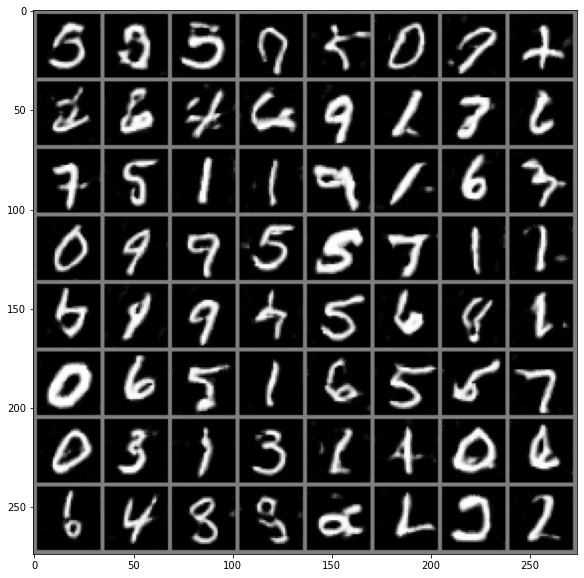

[Epoch 96/200] [Batch 148/937] [D loss: 0.005441] [G loss: 2.699710]
[Epoch 96/200] [Batch 248/937] [D loss: 0.009367] [G loss: 8.095388]
[Epoch 96/200] [Batch 348/937] [D loss: 0.194277] [G loss: 3.342444]
[Epoch 96/200] [Batch 448/937] [D loss: 0.029783] [G loss: 7.148146]
[Epoch 96/200] [Batch 548/937] [D loss: 0.061694] [G loss: 5.189099]
[Epoch 96/200] [Batch 648/937] [D loss: 0.055258] [G loss: 6.933198]
[Epoch 96/200] [Batch 748/937] [D loss: 0.040624] [G loss: 1.201171]
[Epoch 96/200] [Batch 848/937] [D loss: 0.086600] [G loss: 7.085837]
[Epoch 97/200] [Batch 11/937] [D loss: 0.014540] [G loss: 2.186673]
[Epoch 97/200] [Batch 111/937] [D loss: 0.042316] [G loss: 5.031400]
[Epoch 97/200] [Batch 211/937] [D loss: 0.055586] [G loss: 4.939360]
[Epoch 97/200] [Batch 311/937] [D loss: 0.009763] [G loss: 4.009637]
[Epoch 97/200] [Batch 411/937] [D loss: 0.026670] [G loss: 2.186217]
[Epoch 97/200] [Batch 511/937] [D loss: 0.064385] [G loss: 9.382939]
[Epoch 97/200] [Batch 611/937] [D l

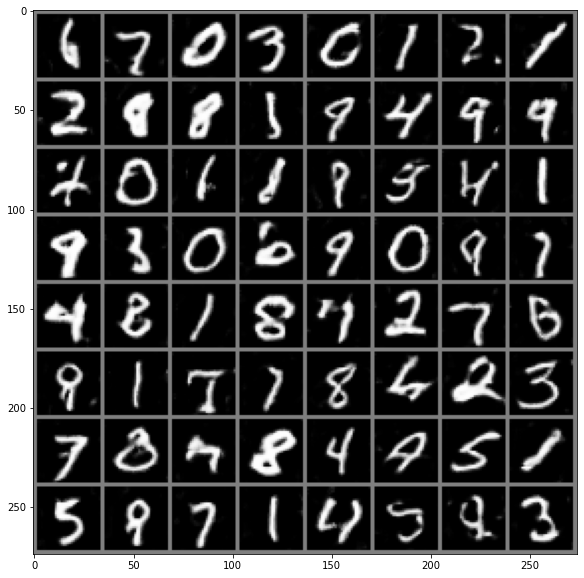

[Epoch 98/200] [Batch 274/937] [D loss: 0.057340] [G loss: 4.179706]
[Epoch 98/200] [Batch 374/937] [D loss: 0.016416] [G loss: 2.559485]
[Epoch 98/200] [Batch 474/937] [D loss: 0.008367] [G loss: 5.670570]
[Epoch 98/200] [Batch 574/937] [D loss: 0.032839] [G loss: 7.082094]
[Epoch 98/200] [Batch 674/937] [D loss: 0.005012] [G loss: 9.400186]
[Epoch 98/200] [Batch 774/937] [D loss: 0.032467] [G loss: 8.931911]
[Epoch 98/200] [Batch 874/937] [D loss: 0.048787] [G loss: 5.644772]
[Epoch 99/200] [Batch 37/937] [D loss: 0.006891] [G loss: 7.177185]
[Epoch 99/200] [Batch 137/937] [D loss: 0.013717] [G loss: 3.595282]
[Epoch 99/200] [Batch 237/937] [D loss: 0.019969] [G loss: 5.083747]
[Epoch 99/200] [Batch 337/937] [D loss: 0.063105] [G loss: 1.351008]
[Epoch 99/200] [Batch 437/937] [D loss: 0.135842] [G loss: 2.583186]
[Epoch 99/200] [Batch 537/937] [D loss: 0.022800] [G loss: 6.475473]
[Epoch 99/200] [Batch 637/937] [D loss: 0.010571] [G loss: 5.969797]
[Epoch 99/200] [Batch 737/937] [D l

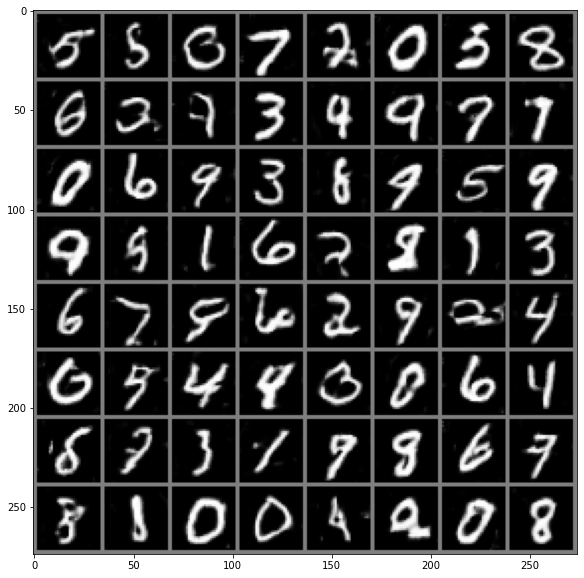

[Epoch 100/200] [Batch 400/937] [D loss: 0.015195] [G loss: 9.589485]
[Epoch 100/200] [Batch 500/937] [D loss: 0.017830] [G loss: 3.639307]
[Epoch 100/200] [Batch 600/937] [D loss: 0.119430] [G loss: 9.899984]
[Epoch 100/200] [Batch 700/937] [D loss: 0.018259] [G loss: 7.417484]
[Epoch 100/200] [Batch 800/937] [D loss: 0.008924] [G loss: 2.252905]
[Epoch 100/200] [Batch 900/937] [D loss: 0.073864] [G loss: 5.833682]
[Epoch 101/200] [Batch 63/937] [D loss: 0.136042] [G loss: 2.437335]
[Epoch 101/200] [Batch 163/937] [D loss: 0.013957] [G loss: 3.544680]
[Epoch 101/200] [Batch 263/937] [D loss: 0.050614] [G loss: 1.072147]
[Epoch 101/200] [Batch 363/937] [D loss: 0.045763] [G loss: 7.659270]
[Epoch 101/200] [Batch 463/937] [D loss: 0.021743] [G loss: 7.132880]
[Epoch 101/200] [Batch 563/937] [D loss: 0.065184] [G loss: 0.870808]
[Epoch 101/200] [Batch 663/937] [D loss: 0.018839] [G loss: 3.700653]
[Epoch 101/200] [Batch 763/937] [D loss: 0.057580] [G loss: 3.919950]
[Epoch 101/200] [Batc

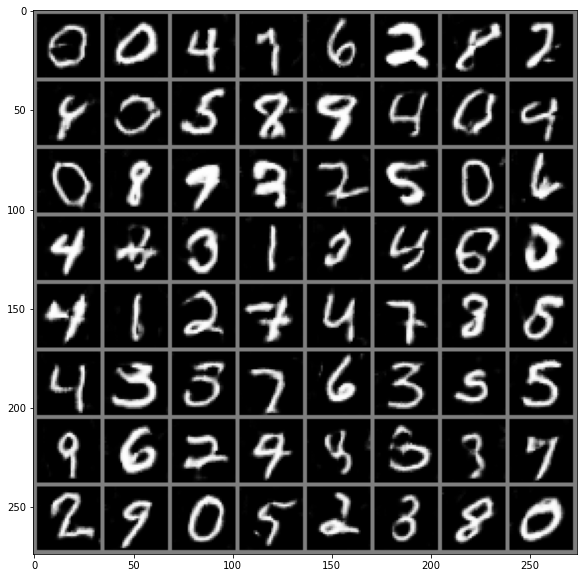

[Epoch 102/200] [Batch 526/937] [D loss: 0.022952] [G loss: 4.104681]
[Epoch 102/200] [Batch 626/937] [D loss: 0.038247] [G loss: 2.720414]
[Epoch 102/200] [Batch 726/937] [D loss: 0.175157] [G loss: 3.754335]
[Epoch 102/200] [Batch 826/937] [D loss: 0.037913] [G loss: 11.257393]
[Epoch 102/200] [Batch 926/937] [D loss: 0.373326] [G loss: 8.467257]
[Epoch 103/200] [Batch 89/937] [D loss: 0.018214] [G loss: 6.549738]
[Epoch 103/200] [Batch 189/937] [D loss: 0.017564] [G loss: 6.433377]
[Epoch 103/200] [Batch 289/937] [D loss: 0.001735] [G loss: 5.535425]
[Epoch 103/200] [Batch 389/937] [D loss: 0.287483] [G loss: 9.073278]
[Epoch 103/200] [Batch 489/937] [D loss: 0.073655] [G loss: 6.440405]
[Epoch 103/200] [Batch 589/937] [D loss: 0.028176] [G loss: 2.072945]
[Epoch 103/200] [Batch 689/937] [D loss: 0.004881] [G loss: 4.505542]
[Epoch 103/200] [Batch 789/937] [D loss: 0.012351] [G loss: 3.154009]
[Epoch 103/200] [Batch 889/937] [D loss: 0.007773] [G loss: 8.389984]
[Epoch 104/200] [Bat

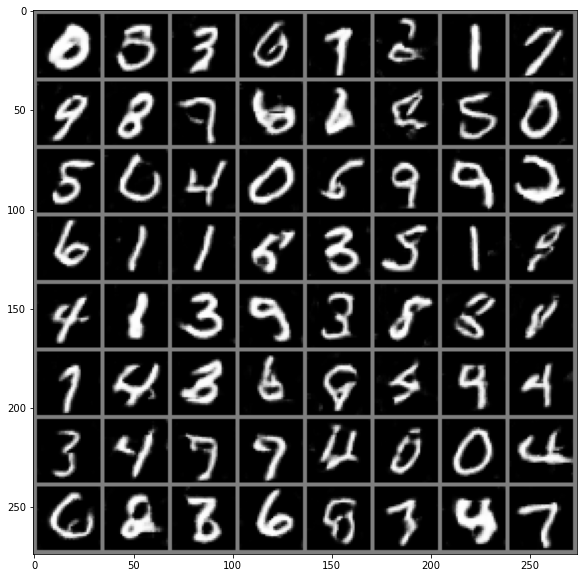

[Epoch 104/200] [Batch 652/937] [D loss: 0.028170] [G loss: 5.389797]
[Epoch 104/200] [Batch 752/937] [D loss: 0.030785] [G loss: 6.202225]
[Epoch 104/200] [Batch 852/937] [D loss: 0.059382] [G loss: 1.326905]
[Epoch 105/200] [Batch 15/937] [D loss: 0.009969] [G loss: 6.575024]
[Epoch 105/200] [Batch 115/937] [D loss: 0.033292] [G loss: 5.062960]
[Epoch 105/200] [Batch 215/937] [D loss: 0.037320] [G loss: 6.233506]
[Epoch 105/200] [Batch 315/937] [D loss: 0.104564] [G loss: 3.781250]
[Epoch 105/200] [Batch 415/937] [D loss: 0.031026] [G loss: 5.471082]
[Epoch 105/200] [Batch 515/937] [D loss: 0.070029] [G loss: 0.994219]
[Epoch 105/200] [Batch 615/937] [D loss: 0.006406] [G loss: 7.167780]
[Epoch 105/200] [Batch 715/937] [D loss: 0.007359] [G loss: 9.058031]
[Epoch 105/200] [Batch 815/937] [D loss: 0.013246] [G loss: 3.160904]
[Epoch 105/200] [Batch 915/937] [D loss: 0.001421] [G loss: 7.851020]
[Epoch 106/200] [Batch 78/937] [D loss: 0.014999] [G loss: 5.623949]
[Epoch 106/200] [Batch

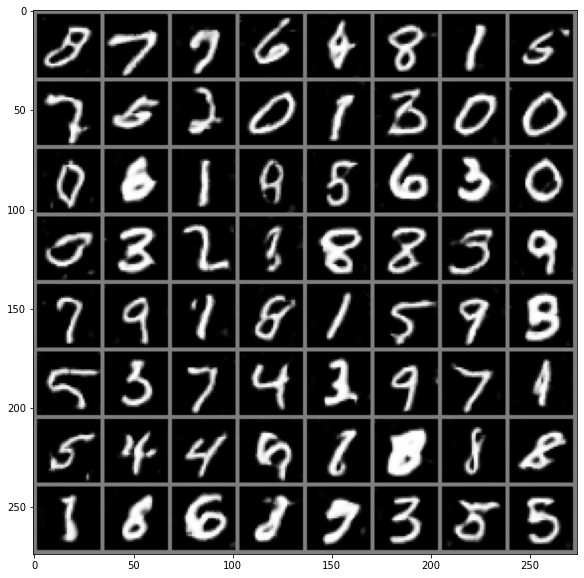

[Epoch 106/200] [Batch 778/937] [D loss: 0.066004] [G loss: 7.009757]
[Epoch 106/200] [Batch 878/937] [D loss: 0.013875] [G loss: 3.298625]
[Epoch 107/200] [Batch 41/937] [D loss: 0.008992] [G loss: 7.950293]
[Epoch 107/200] [Batch 141/937] [D loss: 0.030054] [G loss: 6.908090]
[Epoch 107/200] [Batch 241/937] [D loss: 0.318400] [G loss: 6.418736]
[Epoch 107/200] [Batch 341/937] [D loss: 0.060595] [G loss: 5.176648]
[Epoch 107/200] [Batch 441/937] [D loss: 0.028394] [G loss: 6.795866]
[Epoch 107/200] [Batch 541/937] [D loss: 0.018090] [G loss: 3.373842]
[Epoch 107/200] [Batch 641/937] [D loss: 0.027429] [G loss: 2.907941]
[Epoch 107/200] [Batch 741/937] [D loss: 0.096370] [G loss: 2.827915]
[Epoch 107/200] [Batch 841/937] [D loss: 0.610654] [G loss: 9.739582]
[Epoch 108/200] [Batch 4/937] [D loss: 0.009999] [G loss: 6.662232]
[Epoch 108/200] [Batch 104/937] [D loss: 0.007799] [G loss: 7.492208]
[Epoch 108/200] [Batch 204/937] [D loss: 0.223648] [G loss: 1.971452]
[Epoch 108/200] [Batch 

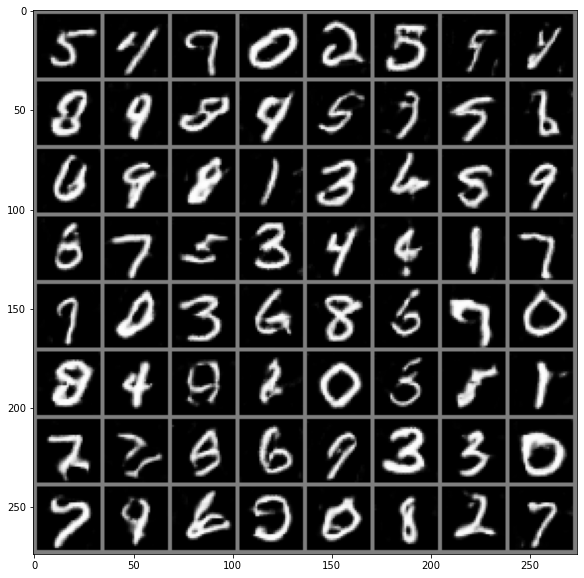

[Epoch 108/200] [Batch 904/937] [D loss: 0.041024] [G loss: 3.690209]
[Epoch 109/200] [Batch 67/937] [D loss: 0.003309] [G loss: 9.083817]
[Epoch 109/200] [Batch 167/937] [D loss: 0.334468] [G loss: 1.226717]
[Epoch 109/200] [Batch 267/937] [D loss: 0.002266] [G loss: 4.909957]
[Epoch 109/200] [Batch 367/937] [D loss: 0.007689] [G loss: 3.687196]
[Epoch 109/200] [Batch 467/937] [D loss: 0.008001] [G loss: 4.051829]
[Epoch 109/200] [Batch 567/937] [D loss: 0.005651] [G loss: 7.571409]
[Epoch 109/200] [Batch 667/937] [D loss: 0.242599] [G loss: 7.232713]
[Epoch 109/200] [Batch 767/937] [D loss: 0.022615] [G loss: 1.513154]
[Epoch 109/200] [Batch 867/937] [D loss: 0.005160] [G loss: 2.190025]
[Epoch 110/200] [Batch 30/937] [D loss: 0.013764] [G loss: 4.434413]
[Epoch 110/200] [Batch 130/937] [D loss: 0.102821] [G loss: 4.458986]
[Epoch 110/200] [Batch 230/937] [D loss: 0.021120] [G loss: 5.464825]
[Epoch 110/200] [Batch 330/937] [D loss: 0.003463] [G loss: 6.283306]
[Epoch 110/200] [Batch

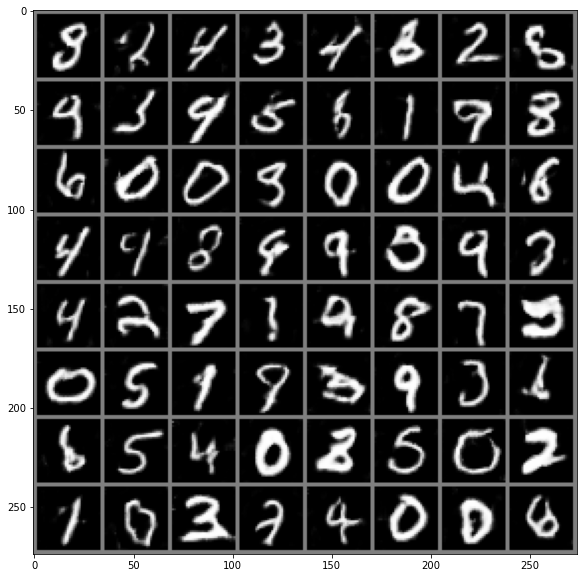

[Epoch 111/200] [Batch 93/937] [D loss: 0.030419] [G loss: 8.032221]
[Epoch 111/200] [Batch 193/937] [D loss: 0.147709] [G loss: 6.011000]
[Epoch 111/200] [Batch 293/937] [D loss: 0.057603] [G loss: 3.930271]
[Epoch 111/200] [Batch 393/937] [D loss: 0.135683] [G loss: 4.417227]
[Epoch 111/200] [Batch 493/937] [D loss: 0.014806] [G loss: 7.968740]
[Epoch 111/200] [Batch 593/937] [D loss: 0.014250] [G loss: 3.383602]
[Epoch 111/200] [Batch 693/937] [D loss: 0.012717] [G loss: 5.218823]
[Epoch 111/200] [Batch 793/937] [D loss: 0.060208] [G loss: 6.704175]
[Epoch 111/200] [Batch 893/937] [D loss: 0.004087] [G loss: 4.940926]
[Epoch 112/200] [Batch 56/937] [D loss: 0.077333] [G loss: 4.544677]
[Epoch 112/200] [Batch 156/937] [D loss: 0.013399] [G loss: 4.913674]
[Epoch 112/200] [Batch 256/937] [D loss: 0.004103] [G loss: 5.985553]
[Epoch 112/200] [Batch 356/937] [D loss: 0.229311] [G loss: 7.431777]
[Epoch 112/200] [Batch 456/937] [D loss: 0.043952] [G loss: 4.279607]
[Epoch 112/200] [Batch

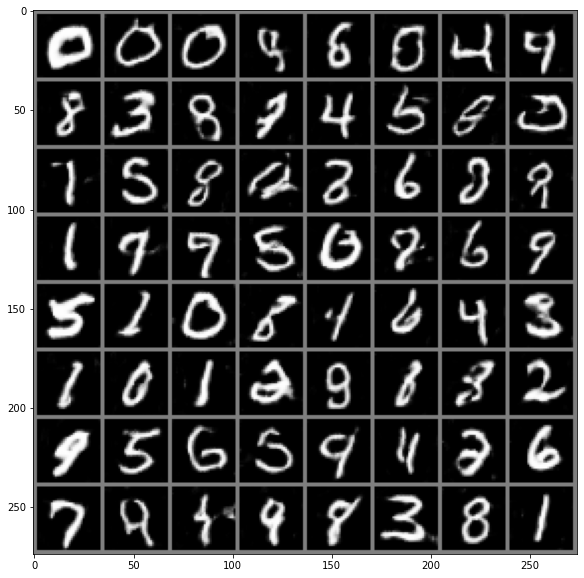

[Epoch 113/200] [Batch 219/937] [D loss: 0.006601] [G loss: 2.691782]
[Epoch 113/200] [Batch 319/937] [D loss: 0.246730] [G loss: 5.877676]
[Epoch 113/200] [Batch 419/937] [D loss: 0.069446] [G loss: 5.229103]
[Epoch 113/200] [Batch 519/937] [D loss: 0.035743] [G loss: 4.689734]
[Epoch 113/200] [Batch 619/937] [D loss: 0.017391] [G loss: 7.779144]
[Epoch 113/200] [Batch 719/937] [D loss: 0.343510] [G loss: 9.558554]
[Epoch 113/200] [Batch 819/937] [D loss: 0.079803] [G loss: 6.268181]
[Epoch 113/200] [Batch 919/937] [D loss: 0.125318] [G loss: 8.184748]
[Epoch 114/200] [Batch 82/937] [D loss: 0.019637] [G loss: 4.826749]
[Epoch 114/200] [Batch 182/937] [D loss: 0.079344] [G loss: 6.147705]
[Epoch 114/200] [Batch 282/937] [D loss: 0.018840] [G loss: 2.043079]
[Epoch 114/200] [Batch 382/937] [D loss: 0.035038] [G loss: 3.264037]
[Epoch 114/200] [Batch 482/937] [D loss: 0.057114] [G loss: 5.422939]
[Epoch 114/200] [Batch 582/937] [D loss: 0.002236] [G loss: 7.076402]
[Epoch 114/200] [Batc

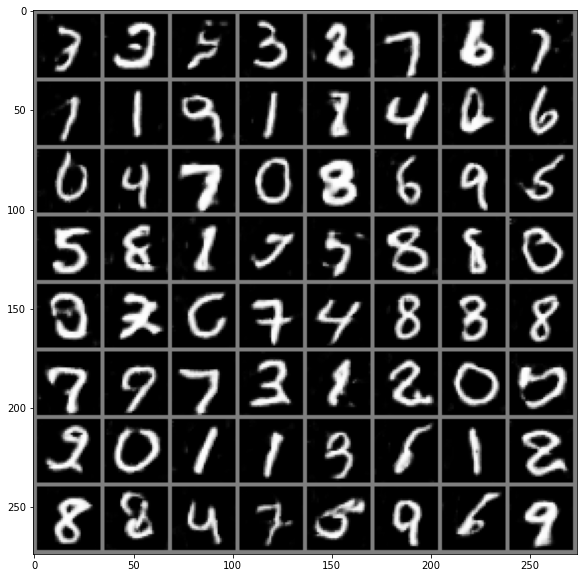

[Epoch 115/200] [Batch 345/937] [D loss: 0.033572] [G loss: 5.119302]
[Epoch 115/200] [Batch 445/937] [D loss: 0.028254] [G loss: 4.431462]
[Epoch 115/200] [Batch 545/937] [D loss: 0.013772] [G loss: 7.499063]
[Epoch 115/200] [Batch 645/937] [D loss: 0.042756] [G loss: 6.118785]
[Epoch 115/200] [Batch 745/937] [D loss: 0.020628] [G loss: 5.468965]
[Epoch 115/200] [Batch 845/937] [D loss: 0.010045] [G loss: 3.948920]
[Epoch 116/200] [Batch 8/937] [D loss: 0.013759] [G loss: 7.373245]
[Epoch 116/200] [Batch 108/937] [D loss: 0.065627] [G loss: 8.880981]
[Epoch 116/200] [Batch 208/937] [D loss: 0.180732] [G loss: 3.303154]
[Epoch 116/200] [Batch 308/937] [D loss: 0.736060] [G loss: 8.913574]
[Epoch 116/200] [Batch 408/937] [D loss: 0.000620] [G loss: 7.912674]
[Epoch 116/200] [Batch 508/937] [D loss: 0.013219] [G loss: 2.152381]
[Epoch 116/200] [Batch 608/937] [D loss: 0.003145] [G loss: 5.824450]
[Epoch 116/200] [Batch 708/937] [D loss: 0.017691] [G loss: 4.787431]
[Epoch 116/200] [Batch

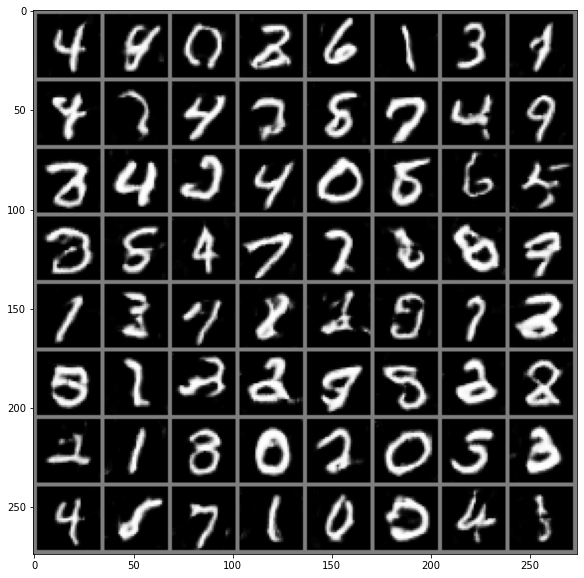

[Epoch 117/200] [Batch 471/937] [D loss: 0.085931] [G loss: 7.174555]
[Epoch 117/200] [Batch 571/937] [D loss: 0.066892] [G loss: 9.190563]
[Epoch 117/200] [Batch 671/937] [D loss: 0.178132] [G loss: 7.448581]
[Epoch 117/200] [Batch 771/937] [D loss: 0.001912] [G loss: 5.434450]
[Epoch 117/200] [Batch 871/937] [D loss: 0.022526] [G loss: 6.230624]
[Epoch 118/200] [Batch 34/937] [D loss: 0.073530] [G loss: 4.122227]
[Epoch 118/200] [Batch 134/937] [D loss: 0.378475] [G loss: 4.893103]
[Epoch 118/200] [Batch 234/937] [D loss: 0.075837] [G loss: 2.916646]
[Epoch 118/200] [Batch 334/937] [D loss: 0.042577] [G loss: 6.273748]
[Epoch 118/200] [Batch 434/937] [D loss: 0.049579] [G loss: 5.227416]
[Epoch 118/200] [Batch 534/937] [D loss: 0.091058] [G loss: 2.945773]
[Epoch 118/200] [Batch 634/937] [D loss: 0.019706] [G loss: 7.711803]
[Epoch 118/200] [Batch 734/937] [D loss: 0.011433] [G loss: 5.822131]
[Epoch 118/200] [Batch 834/937] [D loss: 0.081761] [G loss: 8.767072]
[Epoch 118/200] [Batc

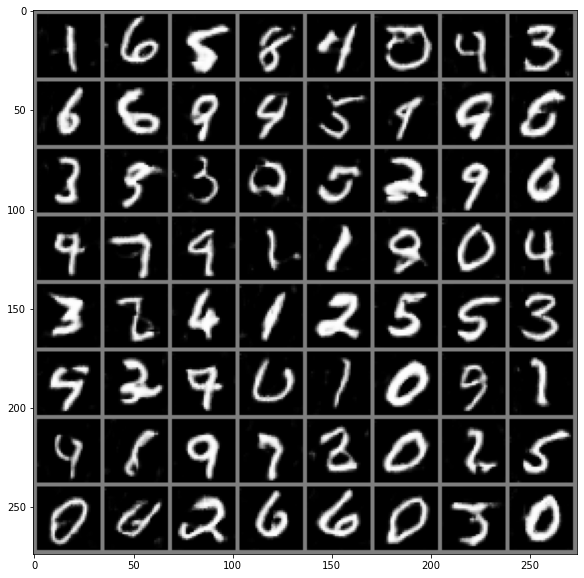

[Epoch 119/200] [Batch 597/937] [D loss: 0.005514] [G loss: 4.617789]
[Epoch 119/200] [Batch 697/937] [D loss: 0.042462] [G loss: 3.660803]
[Epoch 119/200] [Batch 797/937] [D loss: 0.008533] [G loss: 5.632821]
[Epoch 119/200] [Batch 897/937] [D loss: 0.036070] [G loss: 1.962477]
[Epoch 120/200] [Batch 60/937] [D loss: 0.050098] [G loss: 7.893342]
[Epoch 120/200] [Batch 160/937] [D loss: 0.317746] [G loss: 3.331770]
[Epoch 120/200] [Batch 260/937] [D loss: 0.007150] [G loss: 5.858300]
[Epoch 120/200] [Batch 360/937] [D loss: 0.196273] [G loss: 5.957596]
[Epoch 120/200] [Batch 460/937] [D loss: 0.028929] [G loss: 9.485788]
[Epoch 120/200] [Batch 560/937] [D loss: 0.035662] [G loss: 2.686327]
[Epoch 120/200] [Batch 660/937] [D loss: 0.006651] [G loss: 7.056829]
[Epoch 120/200] [Batch 760/937] [D loss: 0.107356] [G loss: 2.886594]
[Epoch 120/200] [Batch 860/937] [D loss: 0.353643] [G loss: 6.170327]
[Epoch 121/200] [Batch 23/937] [D loss: 0.097280] [G loss: 5.866324]
[Epoch 121/200] [Batch

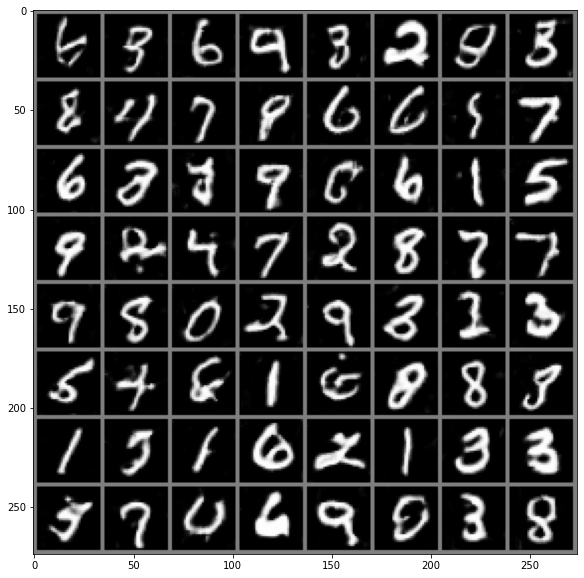

[Epoch 121/200] [Batch 723/937] [D loss: 0.041461] [G loss: 2.759259]
[Epoch 121/200] [Batch 823/937] [D loss: 0.048000] [G loss: 5.139629]
[Epoch 121/200] [Batch 923/937] [D loss: 0.265160] [G loss: 5.406928]
[Epoch 122/200] [Batch 86/937] [D loss: 0.168728] [G loss: 8.556198]
[Epoch 122/200] [Batch 186/937] [D loss: 0.038583] [G loss: 6.559947]
[Epoch 122/200] [Batch 286/937] [D loss: 0.009115] [G loss: 9.387032]
[Epoch 122/200] [Batch 386/937] [D loss: 0.036001] [G loss: 6.263847]
[Epoch 122/200] [Batch 486/937] [D loss: 0.049498] [G loss: 6.590571]
[Epoch 122/200] [Batch 586/937] [D loss: 0.004217] [G loss: 6.926877]
[Epoch 122/200] [Batch 686/937] [D loss: 0.253111] [G loss: 6.509055]
[Epoch 122/200] [Batch 786/937] [D loss: 0.055756] [G loss: 6.255423]
[Epoch 122/200] [Batch 886/937] [D loss: 0.147376] [G loss: 4.870695]
[Epoch 123/200] [Batch 49/937] [D loss: 0.076392] [G loss: 7.476785]
[Epoch 123/200] [Batch 149/937] [D loss: 0.014787] [G loss: 4.542551]
[Epoch 123/200] [Batch

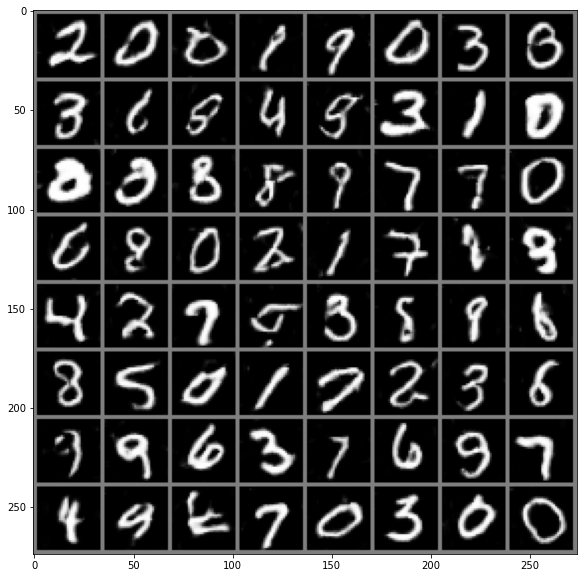

[Epoch 123/200] [Batch 849/937] [D loss: 0.324274] [G loss: 6.575178]
[Epoch 124/200] [Batch 12/937] [D loss: 0.041336] [G loss: 8.473877]
[Epoch 124/200] [Batch 112/937] [D loss: 0.041936] [G loss: 6.487953]
[Epoch 124/200] [Batch 212/937] [D loss: 0.021416] [G loss: 4.929869]
[Epoch 124/200] [Batch 312/937] [D loss: 0.004810] [G loss: 4.941496]
[Epoch 124/200] [Batch 412/937] [D loss: 0.005736] [G loss: 0.877996]
[Epoch 124/200] [Batch 512/937] [D loss: 0.010880] [G loss: 4.919049]
[Epoch 124/200] [Batch 612/937] [D loss: 0.005652] [G loss: 4.336958]
[Epoch 124/200] [Batch 712/937] [D loss: 0.020500] [G loss: 7.164624]
[Epoch 124/200] [Batch 812/937] [D loss: 0.011836] [G loss: 7.761997]
[Epoch 124/200] [Batch 912/937] [D loss: 0.036260] [G loss: 6.146763]
[Epoch 125/200] [Batch 75/937] [D loss: 0.036584] [G loss: 8.003150]
[Epoch 125/200] [Batch 175/937] [D loss: 0.009088] [G loss: 4.925359]
[Epoch 125/200] [Batch 275/937] [D loss: 0.027319] [G loss: 7.370337]
[Epoch 125/200] [Batch

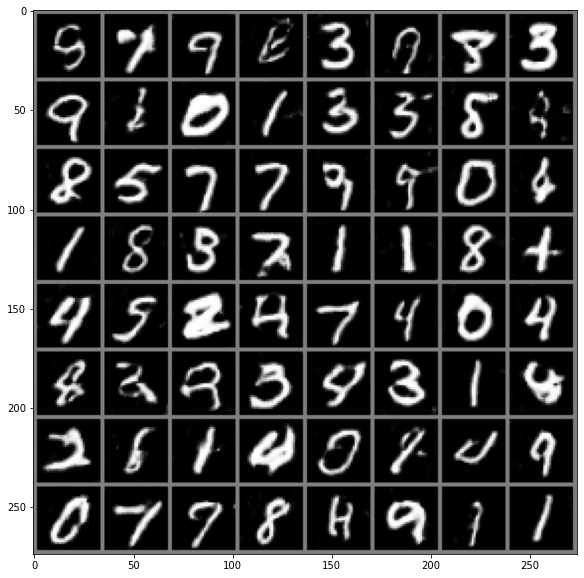

[Epoch 126/200] [Batch 38/937] [D loss: 0.007258] [G loss: 2.100982]
[Epoch 126/200] [Batch 138/937] [D loss: 0.142786] [G loss: 5.502599]
[Epoch 126/200] [Batch 238/937] [D loss: 0.056546] [G loss: 6.526194]
[Epoch 126/200] [Batch 338/937] [D loss: 0.011525] [G loss: 6.056076]
[Epoch 126/200] [Batch 438/937] [D loss: 0.012002] [G loss: 5.061994]
[Epoch 126/200] [Batch 538/937] [D loss: 0.006206] [G loss: 3.281971]
[Epoch 126/200] [Batch 638/937] [D loss: 0.027478] [G loss: 11.989848]
[Epoch 126/200] [Batch 738/937] [D loss: 0.011041] [G loss: 3.881176]
[Epoch 126/200] [Batch 838/937] [D loss: 0.001466] [G loss: 5.206580]
[Epoch 127/200] [Batch 1/937] [D loss: 0.017755] [G loss: 9.715565]
[Epoch 127/200] [Batch 101/937] [D loss: 0.012224] [G loss: 2.850939]
[Epoch 127/200] [Batch 201/937] [D loss: 0.089890] [G loss: 6.784543]
[Epoch 127/200] [Batch 301/937] [D loss: 0.055782] [G loss: 5.377831]
[Epoch 127/200] [Batch 401/937] [D loss: 0.007888] [G loss: 8.251884]
[Epoch 127/200] [Batch

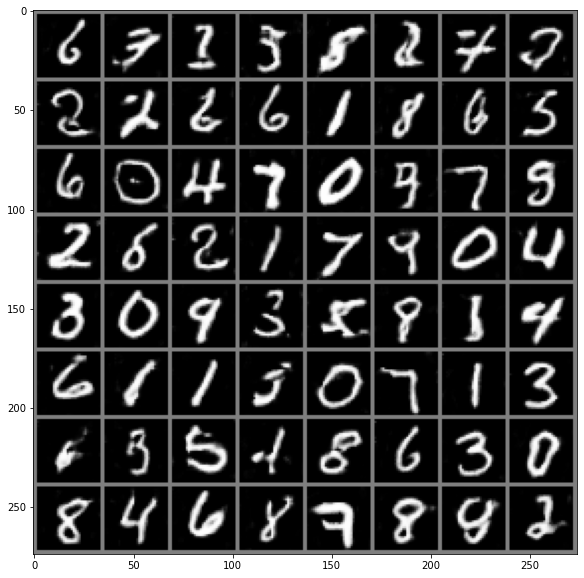

[Epoch 128/200] [Batch 164/937] [D loss: 0.363264] [G loss: 1.626430]
[Epoch 128/200] [Batch 264/937] [D loss: 0.053186] [G loss: 7.166080]
[Epoch 128/200] [Batch 364/937] [D loss: 0.000986] [G loss: 1.805173]
[Epoch 128/200] [Batch 464/937] [D loss: 0.144829] [G loss: 5.358356]
[Epoch 128/200] [Batch 564/937] [D loss: 0.009928] [G loss: 4.058167]
[Epoch 128/200] [Batch 664/937] [D loss: 0.012464] [G loss: 3.091396]
[Epoch 128/200] [Batch 764/937] [D loss: 0.030125] [G loss: 3.116464]
[Epoch 128/200] [Batch 864/937] [D loss: 0.104414] [G loss: 3.651479]
[Epoch 129/200] [Batch 27/937] [D loss: 0.350833] [G loss: 3.616899]
[Epoch 129/200] [Batch 127/937] [D loss: 0.023517] [G loss: 1.577060]
[Epoch 129/200] [Batch 227/937] [D loss: 0.019357] [G loss: 4.080721]
[Epoch 129/200] [Batch 327/937] [D loss: 0.073989] [G loss: 4.876513]
[Epoch 129/200] [Batch 427/937] [D loss: 0.513007] [G loss: 6.668921]
[Epoch 129/200] [Batch 527/937] [D loss: 0.005693] [G loss: 4.655246]
[Epoch 129/200] [Batc

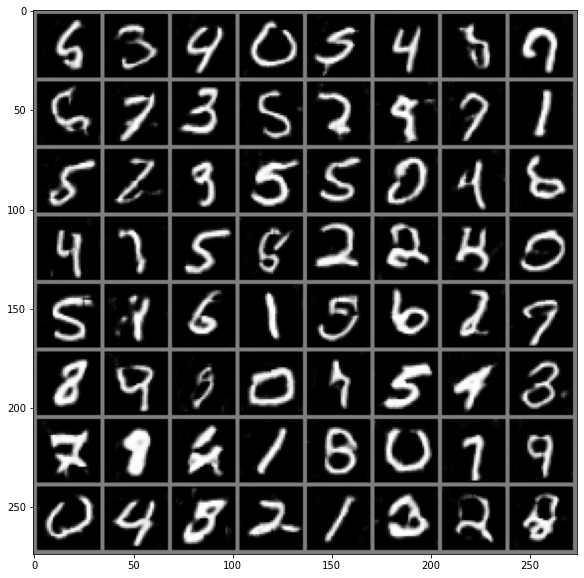

[Epoch 130/200] [Batch 290/937] [D loss: 0.018642] [G loss: 5.803038]
[Epoch 130/200] [Batch 390/937] [D loss: 0.013983] [G loss: 4.100835]
[Epoch 130/200] [Batch 490/937] [D loss: 0.004559] [G loss: 7.036343]
[Epoch 130/200] [Batch 590/937] [D loss: 0.004325] [G loss: 6.300874]
[Epoch 130/200] [Batch 690/937] [D loss: 0.028592] [G loss: 5.562379]
[Epoch 130/200] [Batch 790/937] [D loss: 0.581389] [G loss: 9.988259]
[Epoch 130/200] [Batch 890/937] [D loss: 0.033948] [G loss: 6.883791]
[Epoch 131/200] [Batch 53/937] [D loss: 0.018407] [G loss: 1.049619]
[Epoch 131/200] [Batch 153/937] [D loss: 0.036589] [G loss: 6.150501]
[Epoch 131/200] [Batch 253/937] [D loss: 0.009240] [G loss: 4.954327]
[Epoch 131/200] [Batch 353/937] [D loss: 0.021708] [G loss: 7.815737]
[Epoch 131/200] [Batch 453/937] [D loss: 0.004682] [G loss: 6.519197]
[Epoch 131/200] [Batch 553/937] [D loss: 0.002675] [G loss: 5.579737]
[Epoch 131/200] [Batch 653/937] [D loss: 0.009894] [G loss: 7.330685]
[Epoch 131/200] [Batc

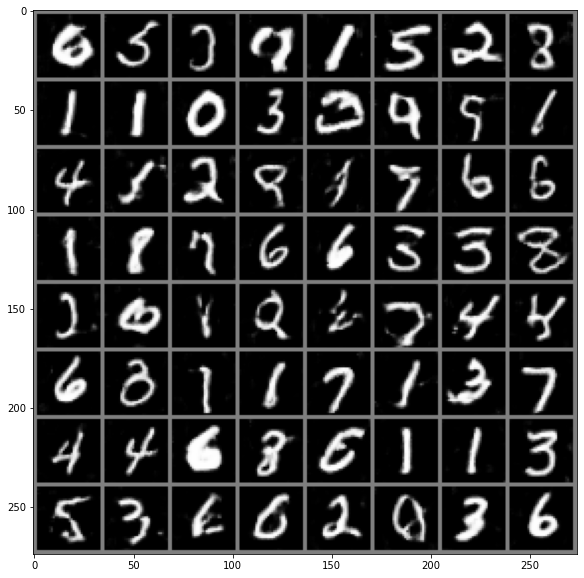

[Epoch 132/200] [Batch 416/937] [D loss: 0.031157] [G loss: 8.676371]
[Epoch 132/200] [Batch 516/937] [D loss: 0.003537] [G loss: 7.944313]
[Epoch 132/200] [Batch 616/937] [D loss: 0.003919] [G loss: 8.338941]
[Epoch 132/200] [Batch 716/937] [D loss: 0.028641] [G loss: 5.822283]
[Epoch 132/200] [Batch 816/937] [D loss: 0.001940] [G loss: 7.692599]
[Epoch 132/200] [Batch 916/937] [D loss: 0.056348] [G loss: 6.073949]
[Epoch 133/200] [Batch 79/937] [D loss: 0.032687] [G loss: 3.845662]
[Epoch 133/200] [Batch 179/937] [D loss: 0.015651] [G loss: 6.279923]
[Epoch 133/200] [Batch 279/937] [D loss: 0.010589] [G loss: 3.665851]
[Epoch 133/200] [Batch 379/937] [D loss: 0.003506] [G loss: 8.862795]
[Epoch 133/200] [Batch 479/937] [D loss: 0.019566] [G loss: 2.786808]
[Epoch 133/200] [Batch 579/937] [D loss: 0.029402] [G loss: 7.410082]
[Epoch 133/200] [Batch 679/937] [D loss: 0.118591] [G loss: 6.257360]
[Epoch 133/200] [Batch 779/937] [D loss: 0.243719] [G loss: 3.441799]
[Epoch 133/200] [Batc

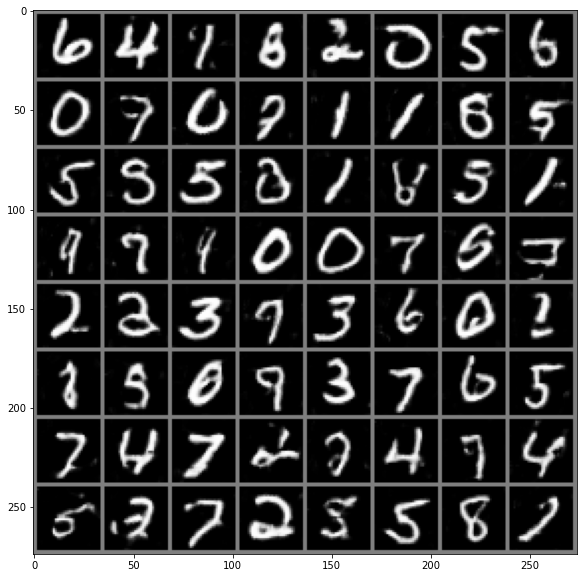

[Epoch 134/200] [Batch 542/937] [D loss: 0.066594] [G loss: 5.895769]
[Epoch 134/200] [Batch 642/937] [D loss: 0.008810] [G loss: 5.879960]
[Epoch 134/200] [Batch 742/937] [D loss: 0.084003] [G loss: 6.532077]
[Epoch 134/200] [Batch 842/937] [D loss: 0.016819] [G loss: 4.082563]
[Epoch 135/200] [Batch 5/937] [D loss: 0.455362] [G loss: 3.559947]
[Epoch 135/200] [Batch 105/937] [D loss: 0.010832] [G loss: 5.990746]
[Epoch 135/200] [Batch 205/937] [D loss: 0.029456] [G loss: 6.885685]
[Epoch 135/200] [Batch 305/937] [D loss: 0.007636] [G loss: 6.394485]
[Epoch 135/200] [Batch 405/937] [D loss: 0.102560] [G loss: 5.553422]
[Epoch 135/200] [Batch 505/937] [D loss: 0.026481] [G loss: 4.286530]
[Epoch 135/200] [Batch 605/937] [D loss: 0.070423] [G loss: 5.391962]
[Epoch 135/200] [Batch 705/937] [D loss: 0.059720] [G loss: 7.865998]
[Epoch 135/200] [Batch 805/937] [D loss: 0.015389] [G loss: 2.050764]
[Epoch 135/200] [Batch 905/937] [D loss: 0.062465] [G loss: 6.422663]
[Epoch 136/200] [Batch

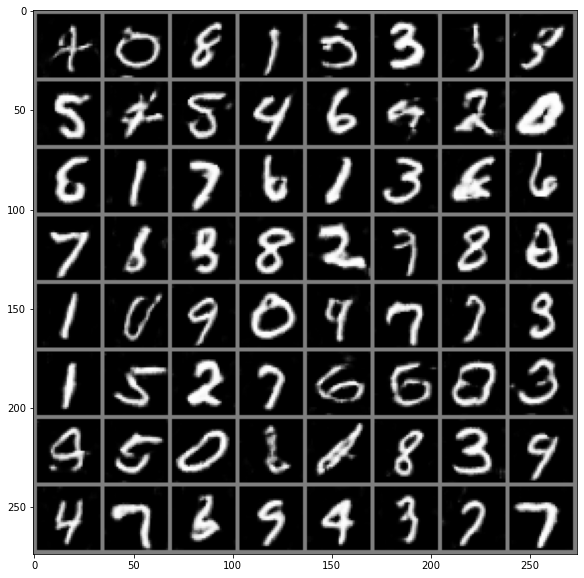

[Epoch 136/200] [Batch 668/937] [D loss: 0.091684] [G loss: 0.922977]
[Epoch 136/200] [Batch 768/937] [D loss: 0.028381] [G loss: 3.818028]
[Epoch 136/200] [Batch 868/937] [D loss: 0.444970] [G loss: 0.984293]
[Epoch 137/200] [Batch 31/937] [D loss: 0.652432] [G loss: 4.650176]
[Epoch 137/200] [Batch 131/937] [D loss: 0.012530] [G loss: 7.730090]
[Epoch 137/200] [Batch 231/937] [D loss: 0.024531] [G loss: 4.427995]
[Epoch 137/200] [Batch 331/937] [D loss: 0.136217] [G loss: 3.016107]
[Epoch 137/200] [Batch 431/937] [D loss: 0.061424] [G loss: 4.299958]
[Epoch 137/200] [Batch 531/937] [D loss: 0.099786] [G loss: 8.343754]
[Epoch 137/200] [Batch 631/937] [D loss: 0.016132] [G loss: 4.484869]
[Epoch 137/200] [Batch 731/937] [D loss: 0.008840] [G loss: 3.315855]
[Epoch 137/200] [Batch 831/937] [D loss: 0.002312] [G loss: 6.986968]
[Epoch 137/200] [Batch 931/937] [D loss: 0.007508] [G loss: 5.681275]
[Epoch 138/200] [Batch 94/937] [D loss: 0.168607] [G loss: 5.418121]
[Epoch 138/200] [Batch

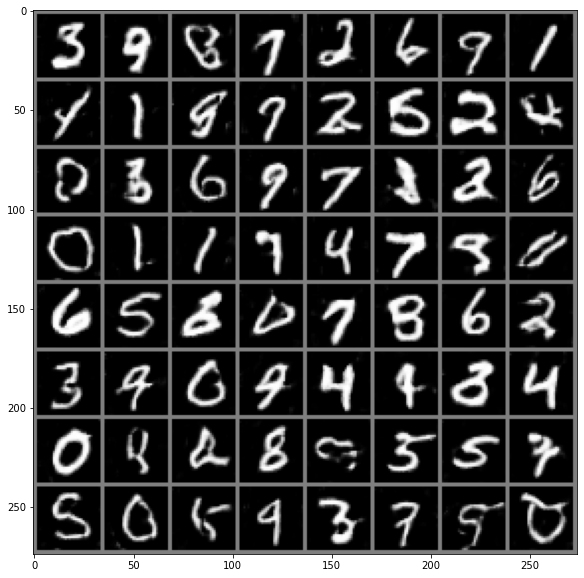

[Epoch 138/200] [Batch 794/937] [D loss: 0.002964] [G loss: 3.688305]
[Epoch 138/200] [Batch 894/937] [D loss: 0.090686] [G loss: 0.730484]
[Epoch 139/200] [Batch 57/937] [D loss: 0.098284] [G loss: 1.677202]
[Epoch 139/200] [Batch 157/937] [D loss: 0.039565] [G loss: 12.280165]
[Epoch 139/200] [Batch 257/937] [D loss: 0.007662] [G loss: 6.952899]
[Epoch 139/200] [Batch 357/937] [D loss: 0.479476] [G loss: 6.369161]
[Epoch 139/200] [Batch 457/937] [D loss: 0.161034] [G loss: 7.118778]
[Epoch 139/200] [Batch 557/937] [D loss: 0.015106] [G loss: 3.872248]
[Epoch 139/200] [Batch 657/937] [D loss: 0.063979] [G loss: 5.274290]
[Epoch 139/200] [Batch 757/937] [D loss: 0.001872] [G loss: 5.692736]
[Epoch 139/200] [Batch 857/937] [D loss: 0.008563] [G loss: 4.605526]
[Epoch 140/200] [Batch 20/937] [D loss: 0.006635] [G loss: 4.140730]
[Epoch 140/200] [Batch 120/937] [D loss: 0.063923] [G loss: 7.462109]
[Epoch 140/200] [Batch 220/937] [D loss: 0.017786] [G loss: 5.875981]
[Epoch 140/200] [Batc

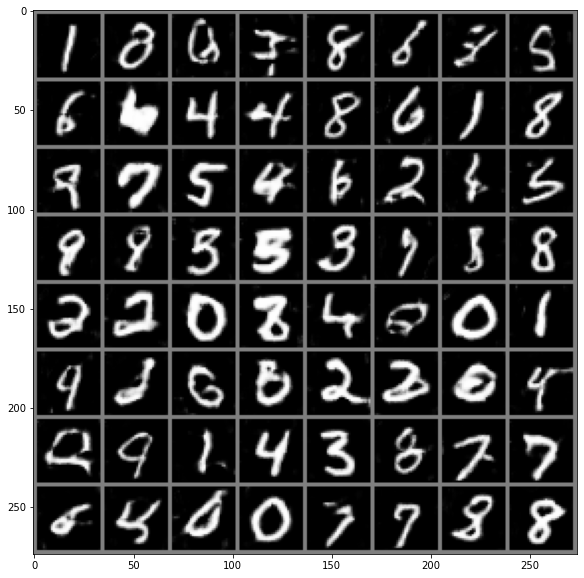

[Epoch 140/200] [Batch 920/937] [D loss: 0.000665] [G loss: 5.448689]
[Epoch 141/200] [Batch 83/937] [D loss: 0.085622] [G loss: 4.489814]
[Epoch 141/200] [Batch 183/937] [D loss: 0.021232] [G loss: 1.273205]
[Epoch 141/200] [Batch 283/937] [D loss: 0.004280] [G loss: 9.118443]
[Epoch 141/200] [Batch 383/937] [D loss: 0.010004] [G loss: 6.529987]
[Epoch 141/200] [Batch 483/937] [D loss: 0.002983] [G loss: 4.040729]
[Epoch 141/200] [Batch 583/937] [D loss: 0.077303] [G loss: 6.661252]
[Epoch 141/200] [Batch 683/937] [D loss: 0.235724] [G loss: 2.178331]
[Epoch 141/200] [Batch 783/937] [D loss: 0.042479] [G loss: 4.724868]
[Epoch 141/200] [Batch 883/937] [D loss: 0.061608] [G loss: 5.247138]
[Epoch 142/200] [Batch 46/937] [D loss: 0.204716] [G loss: 5.709365]
[Epoch 142/200] [Batch 146/937] [D loss: 0.031042] [G loss: 7.655053]
[Epoch 142/200] [Batch 246/937] [D loss: 0.003996] [G loss: 2.194890]
[Epoch 142/200] [Batch 346/937] [D loss: 0.012937] [G loss: 8.538410]
[Epoch 142/200] [Batch

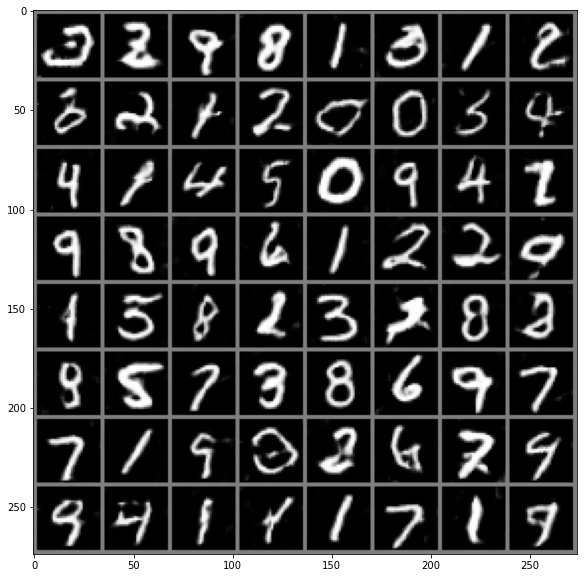

[Epoch 143/200] [Batch 109/937] [D loss: 0.010578] [G loss: 5.689384]
[Epoch 143/200] [Batch 209/937] [D loss: 0.002059] [G loss: 5.018617]
[Epoch 143/200] [Batch 309/937] [D loss: 0.001555] [G loss: 9.329869]
[Epoch 143/200] [Batch 409/937] [D loss: 0.066252] [G loss: 5.353480]
[Epoch 143/200] [Batch 509/937] [D loss: 0.003865] [G loss: 5.557723]
[Epoch 143/200] [Batch 609/937] [D loss: 0.011308] [G loss: 4.914551]
[Epoch 143/200] [Batch 709/937] [D loss: 0.003099] [G loss: 4.301157]
[Epoch 143/200] [Batch 809/937] [D loss: 0.001720] [G loss: 5.588816]
[Epoch 143/200] [Batch 909/937] [D loss: 0.001163] [G loss: 3.319934]
[Epoch 144/200] [Batch 72/937] [D loss: 0.001549] [G loss: 5.092539]
[Epoch 144/200] [Batch 172/937] [D loss: 0.038432] [G loss: 3.512577]
[Epoch 144/200] [Batch 272/937] [D loss: 0.050951] [G loss: 1.403687]
[Epoch 144/200] [Batch 372/937] [D loss: 0.005268] [G loss: 1.735569]
[Epoch 144/200] [Batch 472/937] [D loss: 0.016174] [G loss: 6.377422]
[Epoch 144/200] [Batc

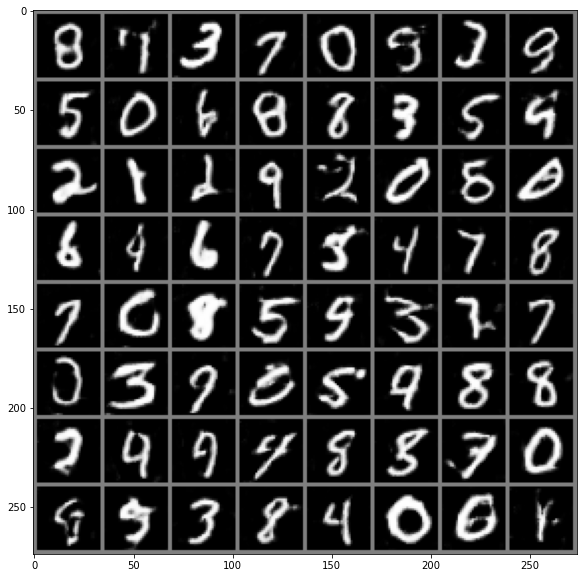

[Epoch 145/200] [Batch 235/937] [D loss: 0.009048] [G loss: 2.584328]
[Epoch 145/200] [Batch 335/937] [D loss: 0.008326] [G loss: 5.967746]
[Epoch 145/200] [Batch 435/937] [D loss: 0.012625] [G loss: 6.144347]
[Epoch 145/200] [Batch 535/937] [D loss: 0.020690] [G loss: 1.213289]
[Epoch 145/200] [Batch 635/937] [D loss: 0.458488] [G loss: 1.827891]
[Epoch 145/200] [Batch 735/937] [D loss: 0.094024] [G loss: 6.158345]
[Epoch 145/200] [Batch 835/937] [D loss: 0.020067] [G loss: 8.622637]
[Epoch 145/200] [Batch 935/937] [D loss: 0.065537] [G loss: 8.406490]
[Epoch 146/200] [Batch 98/937] [D loss: 0.011967] [G loss: 6.248235]
[Epoch 146/200] [Batch 198/937] [D loss: 0.018903] [G loss: 2.938267]
[Epoch 146/200] [Batch 298/937] [D loss: 0.013097] [G loss: 5.321146]
[Epoch 146/200] [Batch 398/937] [D loss: 0.040868] [G loss: 5.751612]
[Epoch 146/200] [Batch 498/937] [D loss: 0.012201] [G loss: 5.826375]
[Epoch 146/200] [Batch 598/937] [D loss: 0.017412] [G loss: 9.073982]
[Epoch 146/200] [Batc

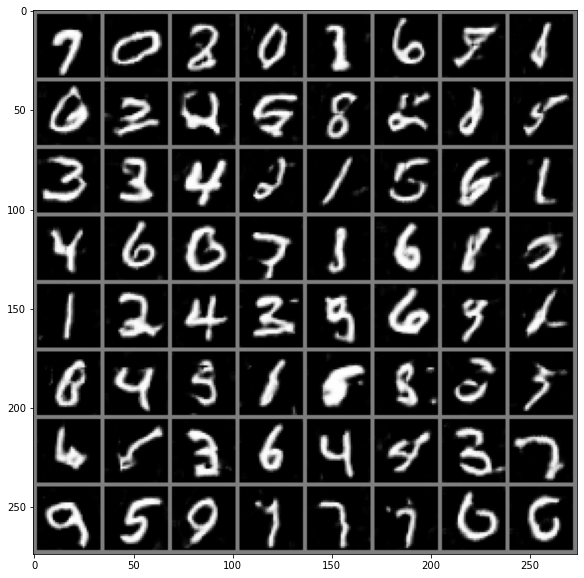

[Epoch 147/200] [Batch 361/937] [D loss: 0.020552] [G loss: 7.309397]
[Epoch 147/200] [Batch 461/937] [D loss: 0.009081] [G loss: 6.495065]
[Epoch 147/200] [Batch 561/937] [D loss: 0.067807] [G loss: 1.589612]
[Epoch 147/200] [Batch 661/937] [D loss: 0.491018] [G loss: 5.670165]
[Epoch 147/200] [Batch 761/937] [D loss: 0.017821] [G loss: 4.671193]
[Epoch 147/200] [Batch 861/937] [D loss: 0.008848] [G loss: 7.470743]
[Epoch 148/200] [Batch 24/937] [D loss: 0.119288] [G loss: 8.218648]
[Epoch 148/200] [Batch 124/937] [D loss: 0.016566] [G loss: 1.039533]
[Epoch 148/200] [Batch 224/937] [D loss: 0.011111] [G loss: 6.343760]
[Epoch 148/200] [Batch 324/937] [D loss: 0.154498] [G loss: 6.016632]
[Epoch 148/200] [Batch 424/937] [D loss: 0.006422] [G loss: 6.182555]
[Epoch 148/200] [Batch 524/937] [D loss: 0.040721] [G loss: 5.096355]
[Epoch 148/200] [Batch 624/937] [D loss: 0.034890] [G loss: 1.079643]
[Epoch 148/200] [Batch 724/937] [D loss: 0.042738] [G loss: 5.501057]
[Epoch 148/200] [Batc

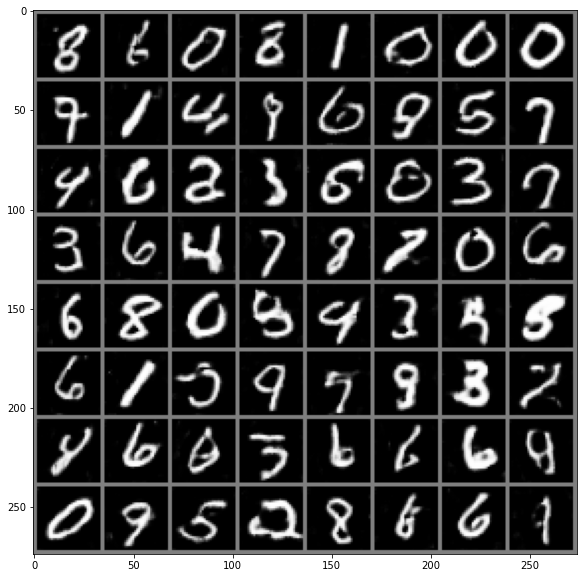

[Epoch 149/200] [Batch 487/937] [D loss: 0.021354] [G loss: 4.638258]
[Epoch 149/200] [Batch 587/937] [D loss: 0.010716] [G loss: 2.240706]
[Epoch 149/200] [Batch 687/937] [D loss: 0.107854] [G loss: 8.512054]
[Epoch 149/200] [Batch 787/937] [D loss: 0.000570] [G loss: 3.586034]
[Epoch 149/200] [Batch 887/937] [D loss: 0.036003] [G loss: 9.194798]
[Epoch 150/200] [Batch 50/937] [D loss: 0.023851] [G loss: 3.066424]
[Epoch 150/200] [Batch 150/937] [D loss: 0.032181] [G loss: 10.834473]
[Epoch 150/200] [Batch 250/937] [D loss: 0.019029] [G loss: 10.277849]
[Epoch 150/200] [Batch 350/937] [D loss: 0.012395] [G loss: 5.213181]
[Epoch 150/200] [Batch 450/937] [D loss: 0.006024] [G loss: 5.039504]
[Epoch 150/200] [Batch 550/937] [D loss: 0.013436] [G loss: 7.068703]
[Epoch 150/200] [Batch 650/937] [D loss: 0.009931] [G loss: 9.577156]
[Epoch 150/200] [Batch 750/937] [D loss: 0.023553] [G loss: 5.257670]
[Epoch 150/200] [Batch 850/937] [D loss: 0.091518] [G loss: 4.071587]
[Epoch 151/200] [Ba

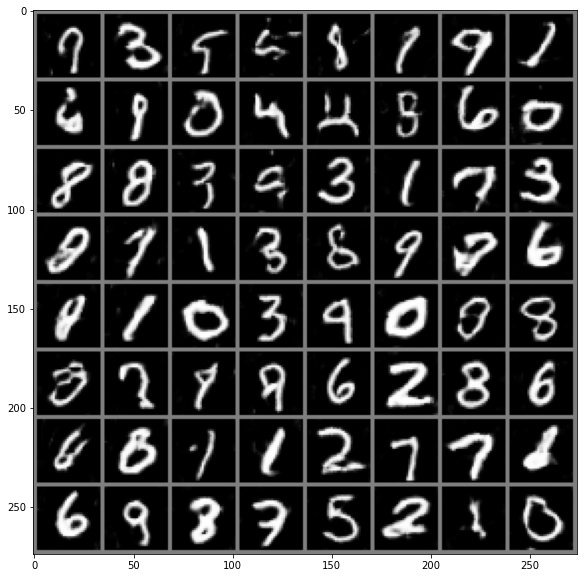

[Epoch 151/200] [Batch 613/937] [D loss: 0.002255] [G loss: 5.174151]
[Epoch 151/200] [Batch 713/937] [D loss: 0.091558] [G loss: 4.847390]
[Epoch 151/200] [Batch 813/937] [D loss: 0.044788] [G loss: 2.715095]
[Epoch 151/200] [Batch 913/937] [D loss: 0.007837] [G loss: 8.495087]
[Epoch 152/200] [Batch 76/937] [D loss: 0.025673] [G loss: 8.322193]
[Epoch 152/200] [Batch 176/937] [D loss: 0.004062] [G loss: 6.255581]
[Epoch 152/200] [Batch 276/937] [D loss: 0.011704] [G loss: 5.851374]
[Epoch 152/200] [Batch 376/937] [D loss: 0.014920] [G loss: 9.679790]
[Epoch 152/200] [Batch 476/937] [D loss: 0.441218] [G loss: 5.208592]
[Epoch 152/200] [Batch 576/937] [D loss: 0.053914] [G loss: 5.670784]
[Epoch 152/200] [Batch 676/937] [D loss: 0.335998] [G loss: 3.226101]
[Epoch 152/200] [Batch 776/937] [D loss: 0.036536] [G loss: 5.336118]
[Epoch 152/200] [Batch 876/937] [D loss: 0.024164] [G loss: 7.716209]
[Epoch 153/200] [Batch 39/937] [D loss: 0.034663] [G loss: 6.093708]
[Epoch 153/200] [Batch

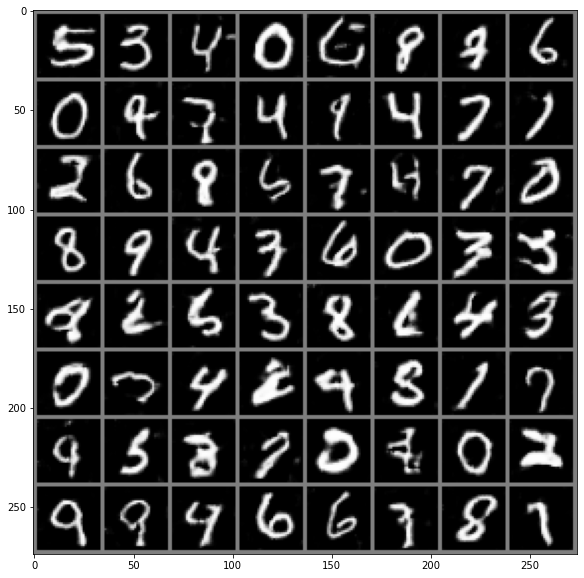

[Epoch 153/200] [Batch 739/937] [D loss: 0.221900] [G loss: 5.586514]
[Epoch 153/200] [Batch 839/937] [D loss: 0.096163] [G loss: 5.755397]
[Epoch 154/200] [Batch 2/937] [D loss: 0.047796] [G loss: 3.008591]
[Epoch 154/200] [Batch 102/937] [D loss: 0.110961] [G loss: 8.973141]
[Epoch 154/200] [Batch 202/937] [D loss: 0.001022] [G loss: 5.049915]
[Epoch 154/200] [Batch 302/937] [D loss: 0.010094] [G loss: 4.701954]
[Epoch 154/200] [Batch 402/937] [D loss: 0.069434] [G loss: 8.154505]
[Epoch 154/200] [Batch 502/937] [D loss: 0.006381] [G loss: 6.532244]
[Epoch 154/200] [Batch 602/937] [D loss: 0.001998] [G loss: 7.430113]
[Epoch 154/200] [Batch 702/937] [D loss: 0.004040] [G loss: 4.688406]
[Epoch 154/200] [Batch 802/937] [D loss: 0.030052] [G loss: 6.189627]
[Epoch 154/200] [Batch 902/937] [D loss: 0.130561] [G loss: 4.876927]
[Epoch 155/200] [Batch 65/937] [D loss: 0.229379] [G loss: 6.731015]
[Epoch 155/200] [Batch 165/937] [D loss: 0.043323] [G loss: 6.353241]
[Epoch 155/200] [Batch 

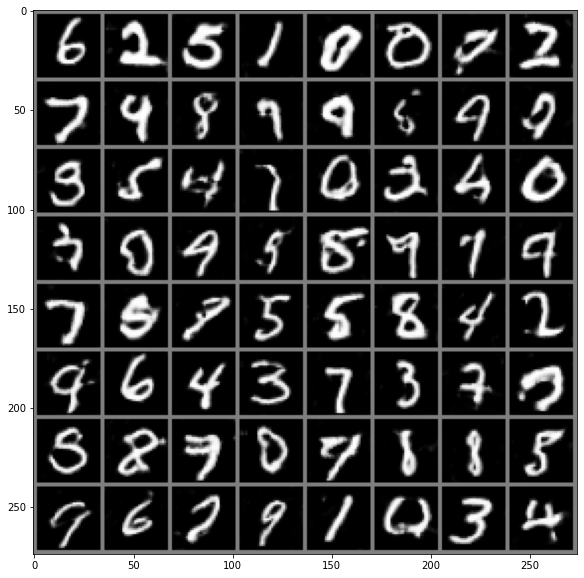

[Epoch 155/200] [Batch 865/937] [D loss: 0.011414] [G loss: 8.115224]
[Epoch 156/200] [Batch 28/937] [D loss: 0.038925] [G loss: 4.386985]
[Epoch 156/200] [Batch 128/937] [D loss: 0.060029] [G loss: 7.908194]
[Epoch 156/200] [Batch 228/937] [D loss: 0.009456] [G loss: 2.976204]
[Epoch 156/200] [Batch 328/937] [D loss: 0.083329] [G loss: 8.199835]
[Epoch 156/200] [Batch 428/937] [D loss: 0.009011] [G loss: 1.730061]
[Epoch 156/200] [Batch 528/937] [D loss: 0.044212] [G loss: 7.164173]
[Epoch 156/200] [Batch 628/937] [D loss: 0.000226] [G loss: 9.321808]
[Epoch 156/200] [Batch 728/937] [D loss: 0.019263] [G loss: 6.036703]
[Epoch 156/200] [Batch 828/937] [D loss: 0.028151] [G loss: 4.029001]
[Epoch 156/200] [Batch 928/937] [D loss: 0.116647] [G loss: 8.889303]
[Epoch 157/200] [Batch 91/937] [D loss: 0.018830] [G loss: 5.713827]
[Epoch 157/200] [Batch 191/937] [D loss: 0.008597] [G loss: 9.092670]
[Epoch 157/200] [Batch 291/937] [D loss: 0.006718] [G loss: 6.339883]
[Epoch 157/200] [Batch

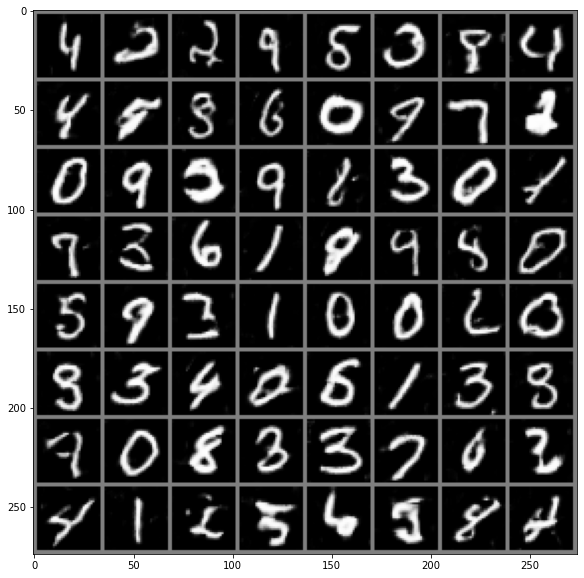

[Epoch 158/200] [Batch 54/937] [D loss: 0.002454] [G loss: 6.942358]
[Epoch 158/200] [Batch 154/937] [D loss: 0.021180] [G loss: 6.702592]
[Epoch 158/200] [Batch 254/937] [D loss: 0.015924] [G loss: 7.210230]
[Epoch 158/200] [Batch 354/937] [D loss: 0.040838] [G loss: 7.066911]
[Epoch 158/200] [Batch 454/937] [D loss: 0.211092] [G loss: 3.185135]
[Epoch 158/200] [Batch 554/937] [D loss: 0.017357] [G loss: 6.399992]
[Epoch 158/200] [Batch 654/937] [D loss: 0.011354] [G loss: 7.288352]
[Epoch 158/200] [Batch 754/937] [D loss: 0.035353] [G loss: 4.473976]
[Epoch 158/200] [Batch 854/937] [D loss: 0.032486] [G loss: 5.459758]
[Epoch 159/200] [Batch 17/937] [D loss: 0.005571] [G loss: 9.662062]
[Epoch 159/200] [Batch 117/937] [D loss: 0.008677] [G loss: 6.165939]
[Epoch 159/200] [Batch 217/937] [D loss: 0.031427] [G loss: 5.625266]
[Epoch 159/200] [Batch 317/937] [D loss: 0.107392] [G loss: 6.141809]
[Epoch 159/200] [Batch 417/937] [D loss: 0.023347] [G loss: 7.143304]
[Epoch 159/200] [Batch

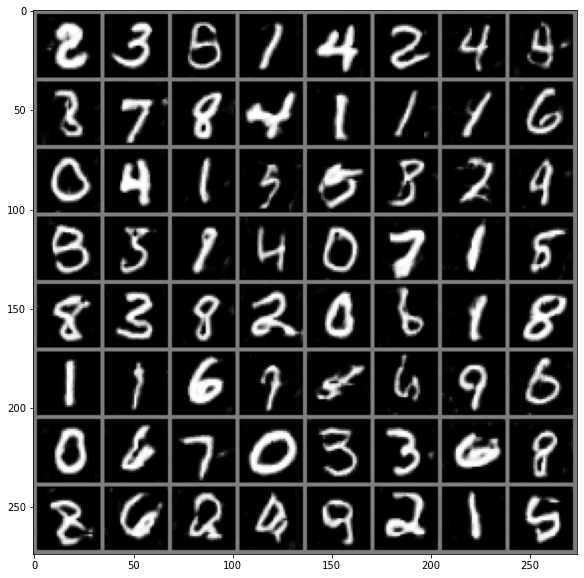

[Epoch 160/200] [Batch 180/937] [D loss: 0.018405] [G loss: 4.161695]
[Epoch 160/200] [Batch 280/937] [D loss: 0.005736] [G loss: 3.932321]
[Epoch 160/200] [Batch 380/937] [D loss: 0.000643] [G loss: 7.045972]
[Epoch 160/200] [Batch 480/937] [D loss: 0.026296] [G loss: 3.893711]
[Epoch 160/200] [Batch 580/937] [D loss: 0.051268] [G loss: 6.320180]
[Epoch 160/200] [Batch 680/937] [D loss: 0.040911] [G loss: 5.021785]
[Epoch 160/200] [Batch 780/937] [D loss: 0.079474] [G loss: 4.272172]
[Epoch 160/200] [Batch 880/937] [D loss: 0.010235] [G loss: 4.087001]
[Epoch 161/200] [Batch 43/937] [D loss: 0.169016] [G loss: 5.182141]
[Epoch 161/200] [Batch 143/937] [D loss: 0.012135] [G loss: 2.422599]
[Epoch 161/200] [Batch 243/937] [D loss: 0.004890] [G loss: 3.578112]
[Epoch 161/200] [Batch 343/937] [D loss: 0.139165] [G loss: 1.440314]
[Epoch 161/200] [Batch 443/937] [D loss: 0.007339] [G loss: 10.819881]
[Epoch 161/200] [Batch 543/937] [D loss: 0.011747] [G loss: 4.276829]
[Epoch 161/200] [Bat

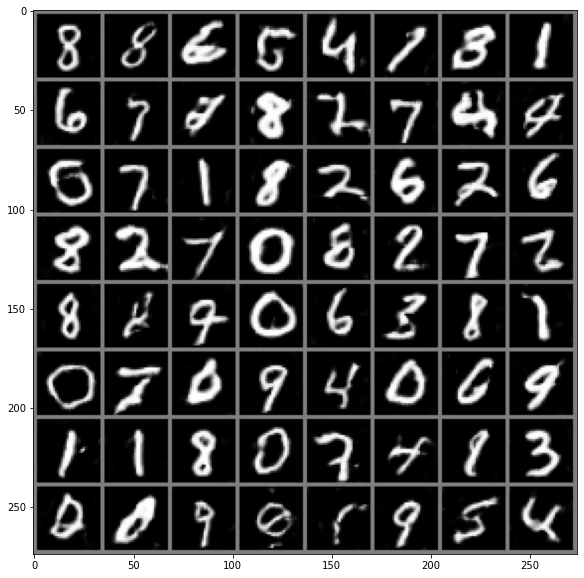

[Epoch 162/200] [Batch 306/937] [D loss: 0.001596] [G loss: 3.008944]
[Epoch 162/200] [Batch 406/937] [D loss: 0.204451] [G loss: 11.090478]
[Epoch 162/200] [Batch 506/937] [D loss: 0.002668] [G loss: 7.516824]
[Epoch 162/200] [Batch 606/937] [D loss: 0.000462] [G loss: 6.111868]
[Epoch 162/200] [Batch 706/937] [D loss: 0.017220] [G loss: 7.483808]
[Epoch 162/200] [Batch 806/937] [D loss: 0.009949] [G loss: 3.635821]
[Epoch 162/200] [Batch 906/937] [D loss: 0.001243] [G loss: 9.060869]
[Epoch 163/200] [Batch 69/937] [D loss: 0.010473] [G loss: 6.680406]
[Epoch 163/200] [Batch 169/937] [D loss: 0.025448] [G loss: 3.648666]
[Epoch 163/200] [Batch 269/937] [D loss: 0.030713] [G loss: 4.366627]
[Epoch 163/200] [Batch 369/937] [D loss: 0.001059] [G loss: 8.888165]
[Epoch 163/200] [Batch 469/937] [D loss: 0.014525] [G loss: 8.733124]
[Epoch 163/200] [Batch 569/937] [D loss: 0.005524] [G loss: 6.390805]
[Epoch 163/200] [Batch 669/937] [D loss: 0.040660] [G loss: 5.286765]
[Epoch 163/200] [Bat

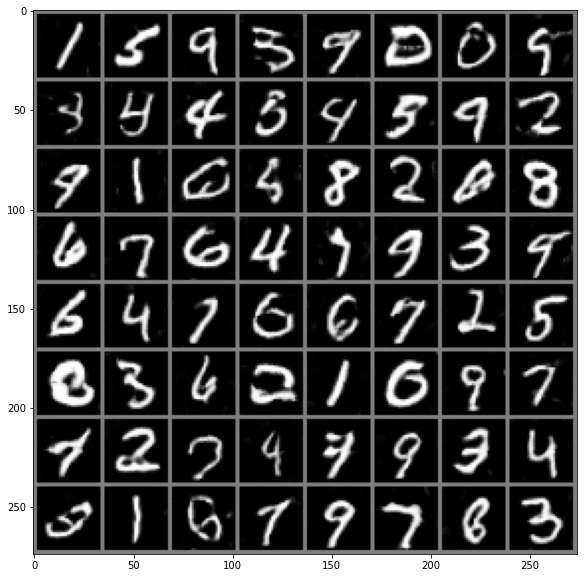

[Epoch 164/200] [Batch 432/937] [D loss: 0.019330] [G loss: 8.419037]
[Epoch 164/200] [Batch 532/937] [D loss: 0.044519] [G loss: 3.725337]
[Epoch 164/200] [Batch 632/937] [D loss: 0.019910] [G loss: 7.583234]
[Epoch 164/200] [Batch 732/937] [D loss: 0.069960] [G loss: 2.188746]
[Epoch 164/200] [Batch 832/937] [D loss: 0.008732] [G loss: 4.223429]
[Epoch 164/200] [Batch 932/937] [D loss: 0.025547] [G loss: 3.016771]
[Epoch 165/200] [Batch 95/937] [D loss: 0.002880] [G loss: 5.661100]
[Epoch 165/200] [Batch 195/937] [D loss: 0.077100] [G loss: 6.722900]
[Epoch 165/200] [Batch 295/937] [D loss: 0.010152] [G loss: 7.684143]
[Epoch 165/200] [Batch 395/937] [D loss: 0.009798] [G loss: 6.234808]
[Epoch 165/200] [Batch 495/937] [D loss: 0.007186] [G loss: 5.256178]
[Epoch 165/200] [Batch 595/937] [D loss: 0.010122] [G loss: 3.201004]
[Epoch 165/200] [Batch 695/937] [D loss: 0.008623] [G loss: 4.977313]
[Epoch 165/200] [Batch 795/937] [D loss: 0.012748] [G loss: 11.646030]
[Epoch 165/200] [Bat

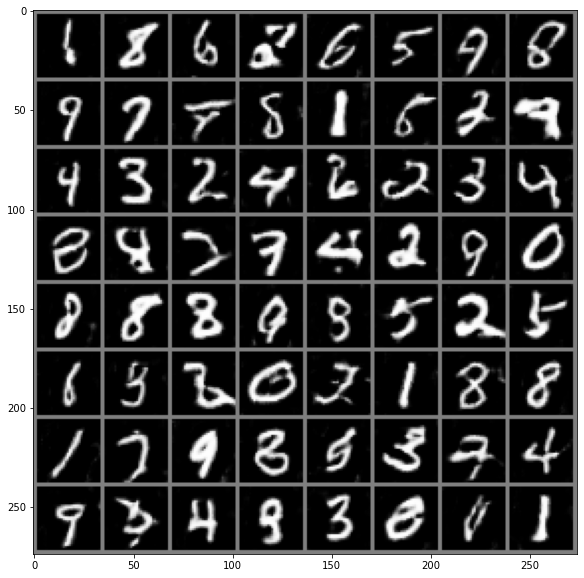

[Epoch 166/200] [Batch 558/937] [D loss: 0.063452] [G loss: 2.714968]
[Epoch 166/200] [Batch 658/937] [D loss: 0.083443] [G loss: 6.752842]
[Epoch 166/200] [Batch 758/937] [D loss: 0.002172] [G loss: 5.785968]
[Epoch 166/200] [Batch 858/937] [D loss: 0.077299] [G loss: 3.387601]
[Epoch 167/200] [Batch 21/937] [D loss: 0.038581] [G loss: 5.499020]
[Epoch 167/200] [Batch 121/937] [D loss: 0.000791] [G loss: 3.223237]
[Epoch 167/200] [Batch 221/937] [D loss: 0.016937] [G loss: 3.868304]
[Epoch 167/200] [Batch 321/937] [D loss: 0.022546] [G loss: 5.654929]
[Epoch 167/200] [Batch 421/937] [D loss: 0.004210] [G loss: 5.790566]
[Epoch 167/200] [Batch 521/937] [D loss: 0.046973] [G loss: 10.181683]
[Epoch 167/200] [Batch 621/937] [D loss: 0.019998] [G loss: 10.696157]
[Epoch 167/200] [Batch 721/937] [D loss: 0.032195] [G loss: 2.707865]
[Epoch 167/200] [Batch 821/937] [D loss: 0.022486] [G loss: 4.451391]
[Epoch 167/200] [Batch 921/937] [D loss: 0.059572] [G loss: 3.436107]
[Epoch 168/200] [Ba

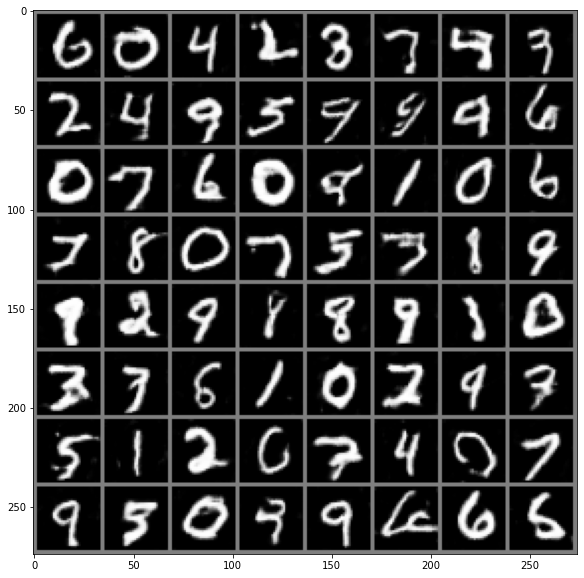

[Epoch 168/200] [Batch 684/937] [D loss: 0.007553] [G loss: 10.155669]
[Epoch 168/200] [Batch 784/937] [D loss: 0.030657] [G loss: 4.655555]
[Epoch 168/200] [Batch 884/937] [D loss: 0.002126] [G loss: 7.713603]
[Epoch 169/200] [Batch 47/937] [D loss: 0.069461] [G loss: 5.658295]
[Epoch 169/200] [Batch 147/937] [D loss: 0.021355] [G loss: 6.204123]
[Epoch 169/200] [Batch 247/937] [D loss: 0.102982] [G loss: 7.580696]
[Epoch 169/200] [Batch 347/937] [D loss: 0.010360] [G loss: 6.283165]
[Epoch 169/200] [Batch 447/937] [D loss: 0.108666] [G loss: 6.068980]
[Epoch 169/200] [Batch 547/937] [D loss: 0.120594] [G loss: 5.729642]
[Epoch 169/200] [Batch 647/937] [D loss: 0.023541] [G loss: 4.736638]
[Epoch 169/200] [Batch 747/937] [D loss: 0.062513] [G loss: 6.402674]
[Epoch 169/200] [Batch 847/937] [D loss: 0.004908] [G loss: 3.594575]
[Epoch 170/200] [Batch 10/937] [D loss: 0.019747] [G loss: 6.538531]
[Epoch 170/200] [Batch 110/937] [D loss: 0.043372] [G loss: 5.532776]
[Epoch 170/200] [Batc

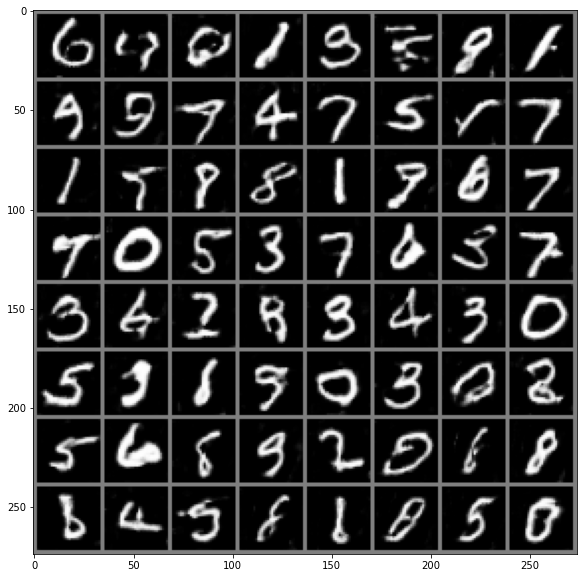

[Epoch 170/200] [Batch 810/937] [D loss: 0.012182] [G loss: 4.619652]
[Epoch 170/200] [Batch 910/937] [D loss: 0.007145] [G loss: 7.924326]
[Epoch 171/200] [Batch 73/937] [D loss: 0.002720] [G loss: 6.633037]
[Epoch 171/200] [Batch 173/937] [D loss: 0.030470] [G loss: 9.705256]
[Epoch 171/200] [Batch 273/937] [D loss: 0.112850] [G loss: 3.912217]
[Epoch 171/200] [Batch 373/937] [D loss: 0.046298] [G loss: 7.149903]
[Epoch 171/200] [Batch 473/937] [D loss: 0.001901] [G loss: 5.193648]
[Epoch 171/200] [Batch 573/937] [D loss: 0.007657] [G loss: 4.220148]
[Epoch 171/200] [Batch 673/937] [D loss: 0.031046] [G loss: 5.725987]
[Epoch 171/200] [Batch 773/937] [D loss: 0.000918] [G loss: 7.500546]
[Epoch 171/200] [Batch 873/937] [D loss: 0.022574] [G loss: 6.659770]
[Epoch 172/200] [Batch 36/937] [D loss: 0.011822] [G loss: 5.781483]
[Epoch 172/200] [Batch 136/937] [D loss: 0.006082] [G loss: 6.245227]
[Epoch 172/200] [Batch 236/937] [D loss: 0.022919] [G loss: 7.439198]
[Epoch 172/200] [Batch

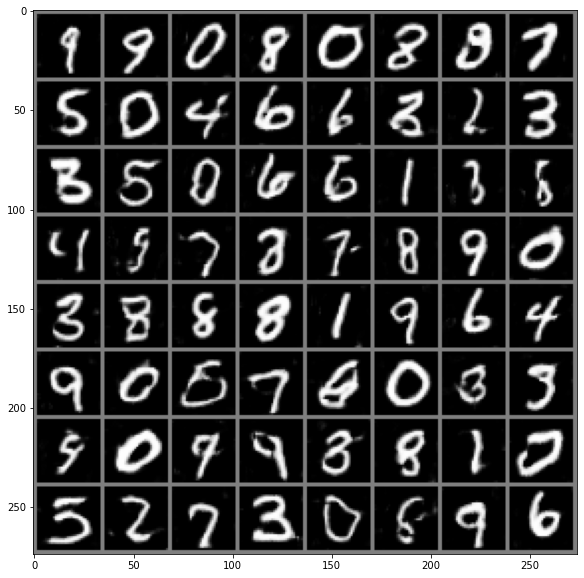

[Epoch 172/200] [Batch 936/937] [D loss: 0.079036] [G loss: 3.777958]
[Epoch 173/200] [Batch 99/937] [D loss: 0.004004] [G loss: 7.127697]
[Epoch 173/200] [Batch 199/937] [D loss: 0.036084] [G loss: 5.193429]
[Epoch 173/200] [Batch 299/937] [D loss: 0.071371] [G loss: 10.098507]
[Epoch 173/200] [Batch 399/937] [D loss: 0.025085] [G loss: 4.778821]
[Epoch 173/200] [Batch 499/937] [D loss: 0.003243] [G loss: 7.465172]
[Epoch 173/200] [Batch 599/937] [D loss: 0.005978] [G loss: 3.620142]
[Epoch 173/200] [Batch 699/937] [D loss: 0.065148] [G loss: 8.581216]
[Epoch 173/200] [Batch 799/937] [D loss: 0.005683] [G loss: 6.916992]
[Epoch 173/200] [Batch 899/937] [D loss: 0.013129] [G loss: 7.873350]
[Epoch 174/200] [Batch 62/937] [D loss: 0.150270] [G loss: 2.372060]
[Epoch 174/200] [Batch 162/937] [D loss: 0.041444] [G loss: 5.278992]
[Epoch 174/200] [Batch 262/937] [D loss: 0.062872] [G loss: 7.674623]
[Epoch 174/200] [Batch 362/937] [D loss: 0.008495] [G loss: 5.803625]
[Epoch 174/200] [Batc

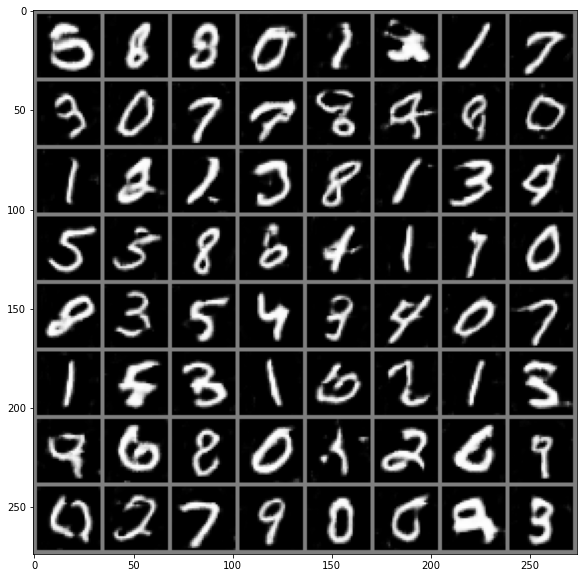

[Epoch 175/200] [Batch 125/937] [D loss: 0.002435] [G loss: 4.131293]
[Epoch 175/200] [Batch 225/937] [D loss: 0.014645] [G loss: 5.814890]
[Epoch 175/200] [Batch 325/937] [D loss: 0.034137] [G loss: 7.306864]
[Epoch 175/200] [Batch 425/937] [D loss: 0.008664] [G loss: 8.165503]
[Epoch 175/200] [Batch 525/937] [D loss: 0.465981] [G loss: 1.946411]
[Epoch 175/200] [Batch 625/937] [D loss: 0.003856] [G loss: 5.999052]
[Epoch 175/200] [Batch 725/937] [D loss: 0.006956] [G loss: 5.159038]
[Epoch 175/200] [Batch 825/937] [D loss: 0.004574] [G loss: 5.182304]
[Epoch 175/200] [Batch 925/937] [D loss: 0.416421] [G loss: 6.163310]
[Epoch 176/200] [Batch 88/937] [D loss: 0.043848] [G loss: 7.429077]
[Epoch 176/200] [Batch 188/937] [D loss: 0.004303] [G loss: 7.692156]
[Epoch 176/200] [Batch 288/937] [D loss: 0.006061] [G loss: 6.384636]
[Epoch 176/200] [Batch 388/937] [D loss: 0.100792] [G loss: 5.407167]
[Epoch 176/200] [Batch 488/937] [D loss: 0.234575] [G loss: 7.804152]
[Epoch 176/200] [Batc

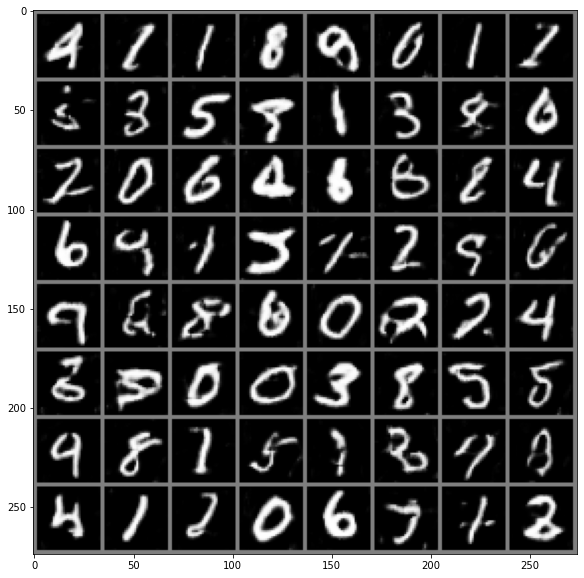

[Epoch 177/200] [Batch 251/937] [D loss: 0.116265] [G loss: 6.843558]
[Epoch 177/200] [Batch 351/937] [D loss: 0.055715] [G loss: 6.900722]
[Epoch 177/200] [Batch 451/937] [D loss: 0.010616] [G loss: 1.089402]
[Epoch 177/200] [Batch 551/937] [D loss: 0.024998] [G loss: 3.987466]
[Epoch 177/200] [Batch 651/937] [D loss: 0.008551] [G loss: 5.596682]
[Epoch 177/200] [Batch 751/937] [D loss: 0.008247] [G loss: 1.756054]
[Epoch 177/200] [Batch 851/937] [D loss: 0.310047] [G loss: 6.933982]
[Epoch 178/200] [Batch 14/937] [D loss: 0.004336] [G loss: 4.072337]
[Epoch 178/200] [Batch 114/937] [D loss: 0.031140] [G loss: 8.152777]
[Epoch 178/200] [Batch 214/937] [D loss: 0.009880] [G loss: 10.470326]
[Epoch 178/200] [Batch 314/937] [D loss: 0.018738] [G loss: 3.152699]
[Epoch 178/200] [Batch 414/937] [D loss: 0.089101] [G loss: 6.588133]
[Epoch 178/200] [Batch 514/937] [D loss: 0.103212] [G loss: 4.958075]
[Epoch 178/200] [Batch 614/937] [D loss: 0.009077] [G loss: 5.398034]
[Epoch 178/200] [Bat

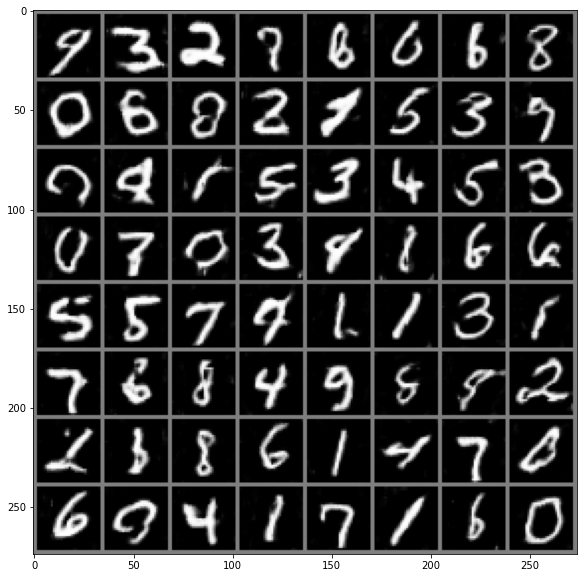

[Epoch 179/200] [Batch 377/937] [D loss: 0.001410] [G loss: 5.423838]
[Epoch 179/200] [Batch 477/937] [D loss: 0.041363] [G loss: 5.333848]
[Epoch 179/200] [Batch 577/937] [D loss: 0.040428] [G loss: 4.069810]
[Epoch 179/200] [Batch 677/937] [D loss: 0.007329] [G loss: 2.354985]
[Epoch 179/200] [Batch 777/937] [D loss: 0.001826] [G loss: 6.638145]
[Epoch 179/200] [Batch 877/937] [D loss: 0.004083] [G loss: 8.645054]
[Epoch 180/200] [Batch 40/937] [D loss: 0.001654] [G loss: 10.109364]
[Epoch 180/200] [Batch 140/937] [D loss: 0.020729] [G loss: 4.641278]
[Epoch 180/200] [Batch 240/937] [D loss: 0.021836] [G loss: 7.596282]
[Epoch 180/200] [Batch 340/937] [D loss: 0.012342] [G loss: 4.480504]
[Epoch 180/200] [Batch 440/937] [D loss: 0.093780] [G loss: 8.341359]
[Epoch 180/200] [Batch 540/937] [D loss: 0.002788] [G loss: 6.383935]
[Epoch 180/200] [Batch 640/937] [D loss: 0.046100] [G loss: 9.703757]
[Epoch 180/200] [Batch 740/937] [D loss: 0.071487] [G loss: 7.740656]
[Epoch 180/200] [Bat

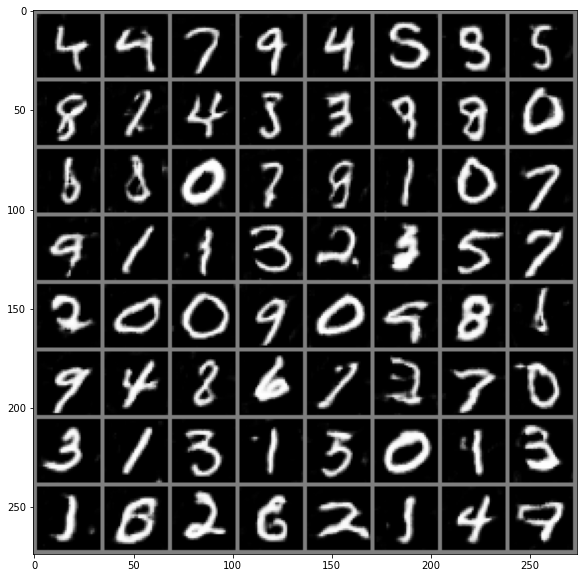

[Epoch 181/200] [Batch 503/937] [D loss: 0.128885] [G loss: 8.168369]
[Epoch 181/200] [Batch 603/937] [D loss: 0.021050] [G loss: 4.404239]
[Epoch 181/200] [Batch 703/937] [D loss: 0.018842] [G loss: 8.930347]
[Epoch 181/200] [Batch 803/937] [D loss: 0.046808] [G loss: 3.903904]
[Epoch 181/200] [Batch 903/937] [D loss: 0.010702] [G loss: 3.585763]
[Epoch 182/200] [Batch 66/937] [D loss: 0.068324] [G loss: 2.947560]
[Epoch 182/200] [Batch 166/937] [D loss: 0.021399] [G loss: 3.141730]
[Epoch 182/200] [Batch 266/937] [D loss: 0.016229] [G loss: 10.817343]
[Epoch 182/200] [Batch 366/937] [D loss: 0.004827] [G loss: 5.311266]
[Epoch 182/200] [Batch 466/937] [D loss: 0.006133] [G loss: 3.576040]
[Epoch 182/200] [Batch 566/937] [D loss: 0.002824] [G loss: 3.900036]
[Epoch 182/200] [Batch 666/937] [D loss: 0.039593] [G loss: 10.342167]
[Epoch 182/200] [Batch 766/937] [D loss: 0.173434] [G loss: 6.776239]
[Epoch 182/200] [Batch 866/937] [D loss: 0.008230] [G loss: 3.223842]
[Epoch 183/200] [Ba

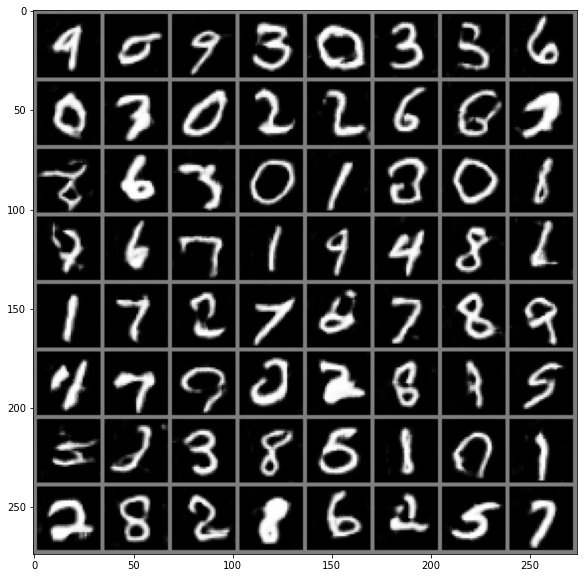

[Epoch 183/200] [Batch 629/937] [D loss: 0.029829] [G loss: 4.326222]
[Epoch 183/200] [Batch 729/937] [D loss: 0.005694] [G loss: 7.066941]
[Epoch 183/200] [Batch 829/937] [D loss: 0.765035] [G loss: 5.736656]
[Epoch 183/200] [Batch 929/937] [D loss: 0.005336] [G loss: 6.965788]
[Epoch 184/200] [Batch 92/937] [D loss: 0.041789] [G loss: 7.590776]
[Epoch 184/200] [Batch 192/937] [D loss: 0.013268] [G loss: 2.504317]
[Epoch 184/200] [Batch 292/937] [D loss: 0.007335] [G loss: 6.577329]
[Epoch 184/200] [Batch 392/937] [D loss: 0.336757] [G loss: 6.384657]
[Epoch 184/200] [Batch 492/937] [D loss: 0.056527] [G loss: 8.333227]
[Epoch 184/200] [Batch 592/937] [D loss: 0.220743] [G loss: 3.129517]
[Epoch 184/200] [Batch 692/937] [D loss: 0.005942] [G loss: 8.391052]
[Epoch 184/200] [Batch 792/937] [D loss: 0.031530] [G loss: 9.274937]
[Epoch 184/200] [Batch 892/937] [D loss: 0.047724] [G loss: 7.936184]
[Epoch 185/200] [Batch 55/937] [D loss: 0.154343] [G loss: 3.536158]
[Epoch 185/200] [Batch

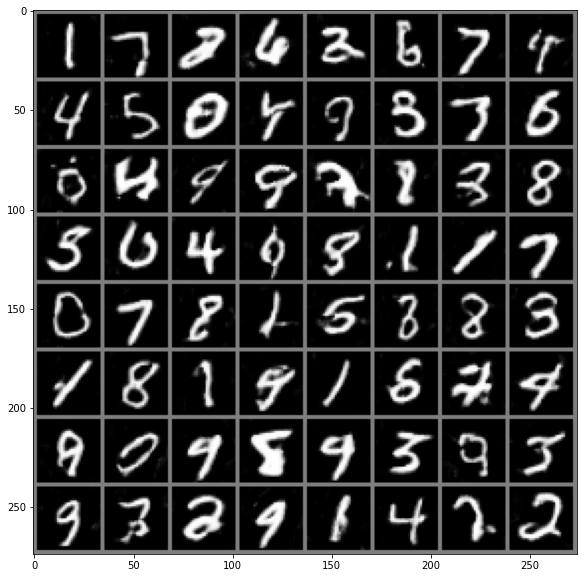

[Epoch 185/200] [Batch 755/937] [D loss: 0.003852] [G loss: 5.069785]
[Epoch 185/200] [Batch 855/937] [D loss: 0.045453] [G loss: 2.759297]
[Epoch 186/200] [Batch 18/937] [D loss: 0.016941] [G loss: 3.326554]
[Epoch 186/200] [Batch 118/937] [D loss: 0.002128] [G loss: 5.831601]
[Epoch 186/200] [Batch 218/937] [D loss: 0.031004] [G loss: 7.378254]
[Epoch 186/200] [Batch 318/937] [D loss: 0.001016] [G loss: 4.763359]
[Epoch 186/200] [Batch 418/937] [D loss: 0.132714] [G loss: 4.819811]
[Epoch 186/200] [Batch 518/937] [D loss: 0.021307] [G loss: 8.147474]
[Epoch 186/200] [Batch 618/937] [D loss: 0.007923] [G loss: 4.218939]
[Epoch 186/200] [Batch 718/937] [D loss: 0.021648] [G loss: 2.815565]
[Epoch 186/200] [Batch 818/937] [D loss: 0.158820] [G loss: 7.322269]
[Epoch 186/200] [Batch 918/937] [D loss: 0.031118] [G loss: 2.541440]
[Epoch 187/200] [Batch 81/937] [D loss: 0.001663] [G loss: 9.515438]
[Epoch 187/200] [Batch 181/937] [D loss: 0.055378] [G loss: 7.695119]
[Epoch 187/200] [Batch

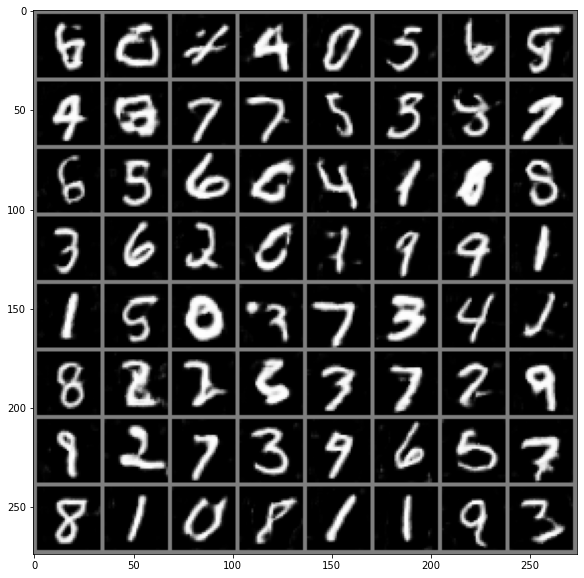

[Epoch 187/200] [Batch 881/937] [D loss: 0.220847] [G loss: 5.004807]
[Epoch 188/200] [Batch 44/937] [D loss: 0.015845] [G loss: 8.913767]
[Epoch 188/200] [Batch 144/937] [D loss: 0.012913] [G loss: 5.361260]
[Epoch 188/200] [Batch 244/937] [D loss: 0.023183] [G loss: 2.851398]
[Epoch 188/200] [Batch 344/937] [D loss: 0.092831] [G loss: 13.516071]
[Epoch 188/200] [Batch 444/937] [D loss: 0.009087] [G loss: 7.599649]
[Epoch 188/200] [Batch 544/937] [D loss: 0.054439] [G loss: 6.557610]
[Epoch 188/200] [Batch 644/937] [D loss: 0.013245] [G loss: 4.219079]
[Epoch 188/200] [Batch 744/937] [D loss: 0.007532] [G loss: 4.929755]
[Epoch 188/200] [Batch 844/937] [D loss: 0.000178] [G loss: 2.767479]
[Epoch 189/200] [Batch 7/937] [D loss: 0.007655] [G loss: 8.949104]
[Epoch 189/200] [Batch 107/937] [D loss: 0.008737] [G loss: 4.781488]
[Epoch 189/200] [Batch 207/937] [D loss: 0.391985] [G loss: 3.957162]
[Epoch 189/200] [Batch 307/937] [D loss: 0.042471] [G loss: 1.297243]
[Epoch 189/200] [Batch

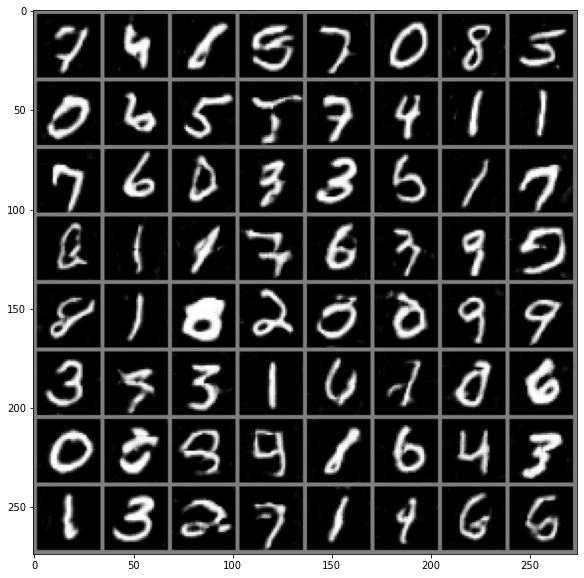

[Epoch 190/200] [Batch 70/937] [D loss: 0.052967] [G loss: 4.005500]
[Epoch 190/200] [Batch 170/937] [D loss: 0.000970] [G loss: 11.865028]
[Epoch 190/200] [Batch 270/937] [D loss: 0.035927] [G loss: 3.215345]
[Epoch 190/200] [Batch 370/937] [D loss: 0.010072] [G loss: 8.068442]
[Epoch 190/200] [Batch 470/937] [D loss: 0.026085] [G loss: 5.928441]
[Epoch 190/200] [Batch 570/937] [D loss: 0.126436] [G loss: 9.468856]
[Epoch 190/200] [Batch 670/937] [D loss: 0.071004] [G loss: 5.282725]
[Epoch 190/200] [Batch 770/937] [D loss: 0.078980] [G loss: 5.395463]
[Epoch 190/200] [Batch 870/937] [D loss: 0.004543] [G loss: 5.650092]
[Epoch 191/200] [Batch 33/937] [D loss: 0.004270] [G loss: 9.143465]
[Epoch 191/200] [Batch 133/937] [D loss: 0.021223] [G loss: 3.904950]
[Epoch 191/200] [Batch 233/937] [D loss: 0.109358] [G loss: 5.625933]
[Epoch 191/200] [Batch 333/937] [D loss: 0.044835] [G loss: 4.876179]
[Epoch 191/200] [Batch 433/937] [D loss: 0.058896] [G loss: 9.409836]
[Epoch 191/200] [Batc

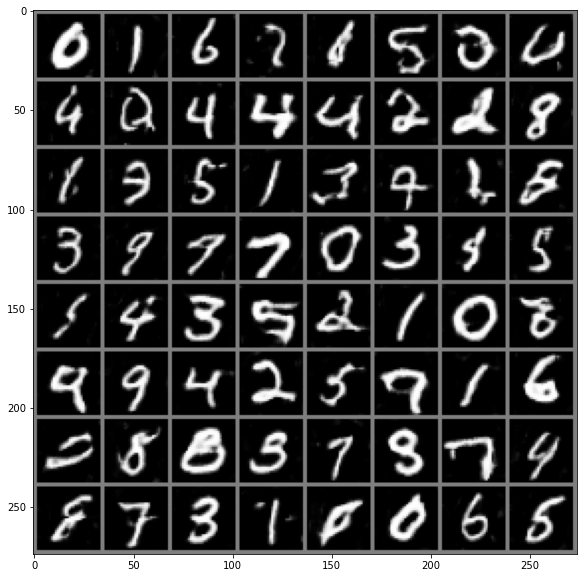

[Epoch 192/200] [Batch 196/937] [D loss: 0.002844] [G loss: 3.448628]
[Epoch 192/200] [Batch 296/937] [D loss: 0.003145] [G loss: 7.788240]
[Epoch 192/200] [Batch 396/937] [D loss: 0.102856] [G loss: 9.583724]
[Epoch 192/200] [Batch 496/937] [D loss: 0.007149] [G loss: 7.359349]
[Epoch 192/200] [Batch 596/937] [D loss: 0.037147] [G loss: 5.015097]
[Epoch 192/200] [Batch 696/937] [D loss: 0.013222] [G loss: 6.945209]
[Epoch 192/200] [Batch 796/937] [D loss: 0.003955] [G loss: 4.727324]
[Epoch 192/200] [Batch 896/937] [D loss: 0.056601] [G loss: 4.892633]
[Epoch 193/200] [Batch 59/937] [D loss: 0.041225] [G loss: 4.375699]
[Epoch 193/200] [Batch 159/937] [D loss: 0.072481] [G loss: 10.986678]
[Epoch 193/200] [Batch 259/937] [D loss: 0.010616] [G loss: 4.363084]
[Epoch 193/200] [Batch 359/937] [D loss: 0.003491] [G loss: 4.800306]
[Epoch 193/200] [Batch 459/937] [D loss: 0.003583] [G loss: 6.653231]
[Epoch 193/200] [Batch 559/937] [D loss: 0.125600] [G loss: 5.819511]
[Epoch 193/200] [Bat

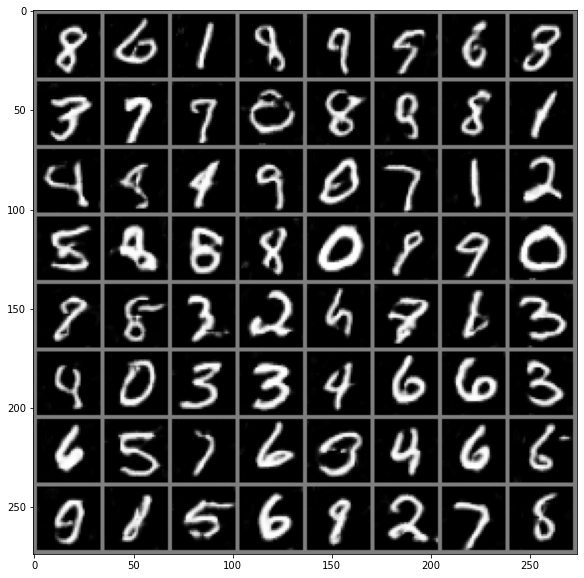

[Epoch 194/200] [Batch 322/937] [D loss: 0.021411] [G loss: 7.384443]
[Epoch 194/200] [Batch 422/937] [D loss: 0.016683] [G loss: 4.449488]
[Epoch 194/200] [Batch 522/937] [D loss: 0.047313] [G loss: 10.073475]
[Epoch 194/200] [Batch 622/937] [D loss: 0.206889] [G loss: 1.994027]
[Epoch 194/200] [Batch 722/937] [D loss: 0.716311] [G loss: 5.989993]
[Epoch 194/200] [Batch 822/937] [D loss: 0.021248] [G loss: 8.337415]
[Epoch 194/200] [Batch 922/937] [D loss: 0.012212] [G loss: 3.142279]
[Epoch 195/200] [Batch 85/937] [D loss: 0.009942] [G loss: 9.163523]
[Epoch 195/200] [Batch 185/937] [D loss: 2.224780] [G loss: 6.018622]
[Epoch 195/200] [Batch 285/937] [D loss: 0.229805] [G loss: 8.439066]
[Epoch 195/200] [Batch 385/937] [D loss: 0.013150] [G loss: 9.159384]
[Epoch 195/200] [Batch 485/937] [D loss: 0.000948] [G loss: 3.896918]
[Epoch 195/200] [Batch 585/937] [D loss: 0.076145] [G loss: 9.636833]
[Epoch 195/200] [Batch 685/937] [D loss: 0.017191] [G loss: 4.124701]
[Epoch 195/200] [Bat

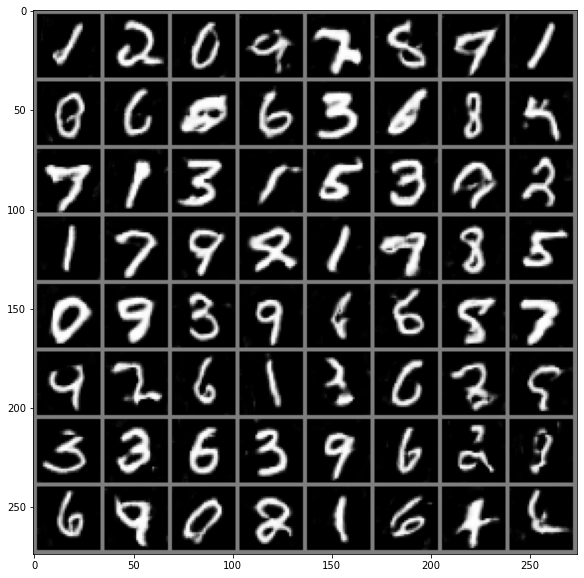

[Epoch 196/200] [Batch 448/937] [D loss: 0.006378] [G loss: 5.929265]
[Epoch 196/200] [Batch 548/937] [D loss: 0.014543] [G loss: 5.705471]
[Epoch 196/200] [Batch 648/937] [D loss: 0.002191] [G loss: 7.081415]
[Epoch 196/200] [Batch 748/937] [D loss: 0.492930] [G loss: 9.744974]
[Epoch 196/200] [Batch 848/937] [D loss: 0.083345] [G loss: 3.599520]
[Epoch 197/200] [Batch 11/937] [D loss: 0.021400] [G loss: 9.020479]
[Epoch 197/200] [Batch 111/937] [D loss: 0.002900] [G loss: 6.932488]
[Epoch 197/200] [Batch 211/937] [D loss: 0.048806] [G loss: 4.272050]
[Epoch 197/200] [Batch 311/937] [D loss: 0.003467] [G loss: 9.216742]
[Epoch 197/200] [Batch 411/937] [D loss: 0.014047] [G loss: 3.815578]
[Epoch 197/200] [Batch 511/937] [D loss: 0.031480] [G loss: 1.143748]
[Epoch 197/200] [Batch 611/937] [D loss: 0.001214] [G loss: 7.905953]
[Epoch 197/200] [Batch 711/937] [D loss: 0.004815] [G loss: 7.771933]
[Epoch 197/200] [Batch 811/937] [D loss: 0.002991] [G loss: 5.874722]
[Epoch 197/200] [Batc

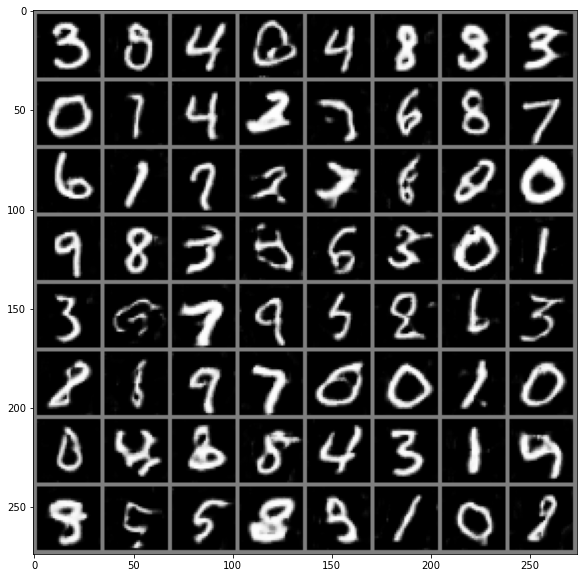

[Epoch 198/200] [Batch 574/937] [D loss: 0.040823] [G loss: 7.444042]
[Epoch 198/200] [Batch 674/937] [D loss: 0.064209] [G loss: 7.708304]
[Epoch 198/200] [Batch 774/937] [D loss: 0.001220] [G loss: 4.590197]
[Epoch 198/200] [Batch 874/937] [D loss: 0.001315] [G loss: 5.385316]
[Epoch 199/200] [Batch 37/937] [D loss: 0.150012] [G loss: 5.713155]
[Epoch 199/200] [Batch 137/937] [D loss: 0.028919] [G loss: 11.475189]
[Epoch 199/200] [Batch 237/937] [D loss: 0.002861] [G loss: 7.116948]
[Epoch 199/200] [Batch 337/937] [D loss: 0.019368] [G loss: 8.978006]
[Epoch 199/200] [Batch 437/937] [D loss: 0.021478] [G loss: 7.216630]
[Epoch 199/200] [Batch 537/937] [D loss: 0.136794] [G loss: 8.720715]
[Epoch 199/200] [Batch 637/937] [D loss: 0.000395] [G loss: 8.008585]
[Epoch 199/200] [Batch 737/937] [D loss: 0.020283] [G loss: 8.437677]
[Epoch 199/200] [Batch 837/937] [D loss: 0.009624] [G loss: 7.313834]


In [11]:
for epoch in range(epochs):
    for i, (real_imgs, _) in enumerate(dataloader):

        real_imgs = real_imgs.to(device)

        # Sample noise as generator input
        z = torch.Tensor(np.random.normal(0, 1, (real_imgs.shape[0], 100))).to(device)

        # -----------------
        #  Train Generator
        # -----------------
        #### Implement Here ####

        optimizer_G.zero_grad()
        
        gen_imgs = G(z)
        # Loss Update
        ones = torch.ones((gen_imgs.size(0), 1)).to(device)
        g_loss = criterion(D(gen_imgs), ones)
        g_loss.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------
        #### Implement Here ####
        
        optimizer_D.zero_grad()
        zeros = torch.zeros((gen_imgs.size(0),1)).to(device)
        fake_loss = criterion(D(G(z)), zeros)
        real_loss = criterion(D(real_imgs), ones)
        d_loss = (fake_loss + real_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        batches_done = epoch * len(dataloader) + i

        if batches_done % 100 == 0:
            print(
                "[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"
                % (epoch, epochs, i, len(dataloader), d_loss.item(), g_loss.item())
            )

        if batches_done % 2000 == 0:
            save_image(gen_imgs.data, "dcgan_images/%d.png" % batches_done, nrow=8, normalize=True)
            imshow(torchvision.utils.make_grid(gen_imgs.cpu()))